# Import Libraries

In [1]:
import os
import math
import datetime
import traceback
import numpy as np
import pandas as pd
import seaborn as sns
import tensorflow as tf
import statsmodels.api as sm
import matplotlib.pyplot as plt

from scipy import stats
from scipy.special import boxcox1p
from matplotlib.dates import YearLocator
from statsmodels.tsa.stattools import adfuller, kpss
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.model_selection import train_test_split
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, LSTM, Bidirectional, Dense, Dropout

#Exploratory Data Analysis (Data Cleansing)

##Load Datasets

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
ispuRaw = pd.DataFrame()

for dataset in sorted(os.listdir('/content/drive/MyDrive/datasets/aqi_jakarta/akumulatif')):
  temp = pd.read_csv(f'/content/drive/MyDrive/datasets/aqi_jakarta/akumulatif/{dataset}')
  ispuRaw = pd.concat([ispuRaw, temp], sort=False, ignore_index=True)

##Keterangan Dataset
Penjelasan variabel dari data diatas sebagai berikut :

1. tanggal : Tanggal pengukuran kualitas udara
2. stasiun : Lokasi pengukuran di stasiun
3. pm10 : Partikulat salah satu parameter yang diukur
4. pm25 : Partikulat salah satu parameter yang diukur
5. so2 : Sulfida (dalam bentuk SO2) salah satu parameter yang diukur
6. co : Carbon Monoksida salah satu parameter yand diukur
7. o3 : Ozon salah satu parameter yang diukur
8. no2 : NItrogen dioksida salah satu parameter yang diukur
9. max : Nilai ukur paling tinggi dari seluruh parameter yang diukur dalam waktu yang sama
10. critical : Parameter yang hasil pengukurannya paling tinggi
11. categori : Kategori hasil perhitungan indeks standar pencemaran udara

In [4]:
ispuRaw.describe(include = 'all')

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,...,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,pm25,location
count,21915,21610,21864,21705,21854,21805,21816,21883.0,19537,21755,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1763,305
unique,4410,55,246,251,201,463,225,355.0,102,11,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,191,4
top,2020-06-06,DKI1 (Bunderan HI),---,---,---,---,---,0.0,O3,SEDANG,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,77,SEDANG
freq,121,4291,3098,2884,2696,2918,2805,2343.0,10638,12684,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,43,182
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


##Remove Unnamed Columns

In [5]:
ispuRaw.columns

Index(['tanggal', 'stasiun', 'pm10', 'so2', 'co', 'o3', 'no2', 'max',
       'critical', 'categori', 's02', 'keterangan', 'kategori', 'Unnamed: 10',
       'Unnamed: 11', 'Unnamed: 12', 'Unnamed: 13', 'Unnamed: 14',
       'Unnamed: 15', 'Unnamed: 16', 'Unnamed: 17', 'Unnamed: 18',
       'Unnamed: 19', 'Unnamed: 20', 'Unnamed: 21', 'pm25', 'location'],
      dtype='object')

Dari fungsi ini, terdapat beberapa kolom yang tidak ada dalam penjelasan keterangan dataset, seperti `Unnamed: x`.

Selain itu ada juga beberapa kolom yang tidak konsisten, seperti kolom `so2` dengan `s02`, `categori` dengan `kategori` dan kolom `keterangan`.

Untuk itu, di tahap berikutnay akan dilakukan pembersihan dan normaliasi posisi data.

Step pertama ialah memeriksa isi dari kolom yang dengan format `Unnamed: x`

In [6]:
ispuRaw[['Unnamed: 10', 'Unnamed: 11', 'Unnamed: 12',
                        'Unnamed: 13', 'Unnamed: 14', 'Unnamed: 15',
                        'Unnamed: 16', 'Unnamed: 17', 'Unnamed: 18',
                        'Unnamed: 19', 'Unnamed: 20', 'Unnamed: 21']].describe()

,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21
count,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
max,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Setelah diperiksa, isi dari kolom tersebut hanyalah **NaN**.
Untuk itu, kolom tersebut harus dihapus karena hanya berisi _noice_ data.

In [7]:
ispuRaw = ispuRaw.drop(['Unnamed: 10', 'Unnamed: 11', 'Unnamed: 12',
                        'Unnamed: 13', 'Unnamed: 14', 'Unnamed: 15',
                        'Unnamed: 16', 'Unnamed: 17', 'Unnamed: 18',
                        'Unnamed: 19', 'Unnamed: 20', 'Unnamed: 21'], axis=1)

In [8]:
ispuRaw.columns

Index(['tanggal', 'stasiun', 'pm10', 'so2', 'co', 'o3', 'no2', 'max',
       'critical', 'categori', 's02', 'keterangan', 'kategori', 'pm25',
       'location'],
      dtype='object')

## Hapus baris dimana nilai kolom tanggal adalah NaN

Langkah berikutnya adalah memeriksa kolom `tanggal`. Kolom ini sangat vital karena kolom ini menjadi titik acuh untuk melakukan _forecasting_ di data _time series_. Untuk itu akan diperiksa total baris di kolom tanggal yang bernilai NaN

In [9]:
ispuRaw['tanggal'].isna().sum()

205

Setelah dihitung, ternyata terdapat 205 data yang dimana kolom tanggalnya adalah NaN.
Langkah selanjutnya adalah memeriksa apakah data dimana nilai tanggal nya adalah NaN memiliki data yang bisa dipakai.

In [10]:
print("Deskripsi Data")
print(ispuRaw.loc[ispuRaw['tanggal'].isna()].describe(include = 'all'))

print("\nTotal Data yang bukan nan ketika data tanggal nan")
ispuRaw.loc[ispuRaw['tanggal'].isna()].notna().sum()

Deskripsi Data
       tanggal stasiun pm10  so2   co   o3  no2  max critical categori  s02  \
count        0       0    0    0    0    0    0    0        0        0  0.0   
unique       0       0    0    0    0    0    0    0        0        0  NaN   
top        NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN      NaN      NaN  NaN   
freq       NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN      NaN      NaN  NaN   
mean       NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN      NaN      NaN  NaN   
std        NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN      NaN      NaN  NaN   
min        NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN      NaN      NaN  NaN   
25%        NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN      NaN      NaN  NaN   
50%        NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN      NaN      NaN  NaN   
75%        NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN      NaN      NaN  NaN   
max        NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN      NaN      NaN  NaN   

       keterangan kategori pm25 loca

tanggal       0
stasiun       0
pm10          0
so2           0
co            0
o3            0
no2           0
max           0
critical      0
categori      0
s02           0
keterangan    0
kategori      0
pm25          0
location      0
dtype: int64

Berdasarkan hasil berikut, ketika data di kolom tanggal adalah NaN, seluruh data yang mengikutinya juga NaN dan tidak ada data yang memiliki nilai. Untuk itu maka seluruh data yang tanggalnya NaN aman dihapus.

In [11]:
ispuRaw = ispuRaw.dropna(subset=['tanggal'])

In [12]:
ispuRaw['tanggal'].isna().sum()

0

## Periksa format tanggal

Setelah membersihkan data tanggal yang Nan, langkah berikutnya adalah memeriksa format tanggal. Format yang dipakai dalam dataset ialah YYYY-MM-DD (Contoh : 2023-06-09).

Untuk memeriksa data yang memiliki tanggal yang berbeda dengan format dari datasetnya, dapat dilakukan dengan menjalankan cell berikut

In [13]:
dayFirst = []
notDayFirst = []

def validate(date_text):
    try:
      datetime.date.fromisoformat(date_text)
    except ValueError:
      print(date_text)
      date_text_split = date_text.split('/')
      if (int(date_text_split[1]) > 12):
        notDayFirst.append(date_text)
      else:
        dayFirst.append(date_text)

for idx, data in ispuRaw[['tanggal']].iterrows():
  validate(data['tanggal'])

01/12/2016
02/12/2016
03/12/2016
04/12/2016
05/12/2016
06/12/2016
07/12/2016
12/12/2016
09/12/2016
10/12/2016
11/12/2016
12/12/2016
13/12/2016
14/12/2016
15/12/2016
16/12/2016
17/12/2016
18/12/2016
19/12/2016
20/12/2016
21/12/2016
22/12/2016
23/12/2016
24/12/2016
25/12/2016
26/12/2016
27/12/2016
28/12/2016
29/12/2016
30/12/2016
31/12/2016
01/12/2016
02/12/2016
03/12/2016
04/12/2016
05/12/2016
06/12/2016
07/12/2016
12/12/2016
09/12/2016
10/12/2016
11/12/2016
12/12/2016
13/12/2016
14/12/2016
15/12/2016
16/12/2016
17/12/2016
18/12/2016
19/12/2016
20/12/2016
21/12/2016
22/12/2016
23/12/2016
24/12/2016
25/12/2016
26/12/2016
27/12/2016
28/12/2016
29/12/2016
30/12/2016
31/12/2016
01/12/2016
02/12/2016
03/12/2016
04/12/2016
05/12/2016
06/12/2016
07/12/2016
12/12/2016
09/12/2016
10/12/2016
11/12/2016
12/12/2016
13/12/2016
14/12/2016
15/12/2016
16/12/2016
17/12/2016
18/12/2016
19/12/2016
20/12/2016
21/12/2016
22/12/2016
23/12/2016
24/12/2016
25/12/2016
26/12/2016
27/12/2016
28/12/2016
29/12/2016

In [14]:
print(len(dayFirst), len(notDayFirst))

274 0


Disini dapat disimpulkan terdapat 274 data yang menggunakan format bukan YYYY-MM-DD. Dan setelah diperiksa, 274 data tersebut menggunakan format dimana hari merupakan baris pertamanya, sehingga 274 data tersebut menggunakan format DD/MM/YYYY. Untuk itu perlu dilakukan konversi ke format YYYY-MM-DD agar seragam dengan data lainnya.

In [15]:
ispuRaw['tanggal'] = pd.to_datetime(ispuRaw['tanggal'], dayfirst=True)

Setelah melakukan konversi, maka dilakukan pemeriksaan dengan mengambil salah satu sampel tanggal yang bermasalah

In [16]:
ispuRaw.loc[ispuRaw['tanggal'] == datetime.datetime(2016,12,26)]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,s02,keterangan,kategori,pm25,location
12825,2016-12-26,DKI1 (Bunderan HI),49,32,23,23,2,49.0,PM10,BAIK,NaN,NaN,NaN,NaN,NaN
12856,2016-12-26,DKI2 (Kelapa Gading),38,17,10,62,21,62.0,O3,SEDANG,NaN,NaN,NaN,NaN,NaN
12887,2016-12-26,DKI3 (Jagakarsa),52,31,10,43,3,52.0,PM10,SEDANG,NaN,NaN,NaN,NaN,NaN
12918,2016-12-26,DKI4 (Lubang Buaya),52,26,14,47,5,52.0,PM10,SEDANG,NaN,NaN,NaN,NaN,NaN
12949,2016-12-26,DKI5 (Kebon Jeruk) Jakarta Barat,---,18,39,66,5,66.0,O3,SEDANG,NaN,NaN,NaN,NaN,NaN


Disini dapat disimpulkan bahwa kelima stasiun tercatat dalam tabel tersebut, sehingga dapat disimpulkan bahwa konversi tanggal berhasil.

## Periksa kolom stasiun pemantauan

Setelah data pada kolom tanggal sudah normal dan bersih, kini saatnya memeriksa data stasiun pemantauan.

Berdasarkan keterangan dari dataset, ada 5 stasiun pemantauan pencemaran udara, yaitu:
1. DKI1 (Bunderan HI)
2. DKI2 (Kelapa Gading)
3. DKI3 (Jagakarsa)
4. DKI4 (Lubang Buaya)
5. DKI5 (Kebon Jeruk)

### Periksa kolom stasiun terdapat NaN

Tahap pertama ialah memeriksa apakah ada data stasiun yang NaN

In [17]:
ispuRaw['stasiun'].isna().sum()

305

Ternyata ada 305 data yang NaN. Untuk itu perlu diperiksa kondisi baris yang data stasiunnya adalah NaN

In [18]:
ispuRaw.loc[(ispuRaw['stasiun'].isna())].head()

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,s02,keterangan,kategori,pm25,location
21050,2021-06-01,NaN,DKI1 (Bunderan HI),83,22,18,19,35.0,83,PM25,NaN,NaN,NaN,59,SEDANG
21051,2021-06-02,NaN,DKI1 (Bunderan HI),84,21,20,24,38.0,84,PM25,NaN,NaN,NaN,59,SEDANG
21052,2021-06-03,NaN,DKI1 (Bunderan HI),76,22,20,17,41.0,76,PM25,NaN,NaN,NaN,54,SEDANG
21053,2021-06-04,NaN,DKI1 (Bunderan HI),87,20,13,14,30.0,87,PM25,NaN,NaN,NaN,63,SEDANG
21054,2021-06-05,NaN,DKI1 (Bunderan HI),79,23,20,19,38.0,79,PM25,NaN,NaN,NaN,59,SEDANG


Setelah diperiksa, ternyata terjadi inkonsitensi urutan data dengan kolomnya, dimana kolom `location` berubah menjadi data untuk `categori`, data stasiun bergeser ke kolom `pm10` dan seterusnya.

Untuk itu perlu dilakukan normalisasi data dengan menggeser data ke kolom yang sebenarnya

In [19]:
errorDatasDate = ispuRaw.loc[(ispuRaw['stasiun'].isna())]['tanggal'].values
errorISPUs = pd.DataFrame(ispuRaw.loc[ispuRaw['tanggal'].isin(errorDatasDate)])
for index, errorISPU in errorISPUs.iterrows():
    errorISPU['stasiun'] = errorISPU['pm10']
    errorISPU['pm10'] = errorISPU['pm25']
    errorISPU['pm25'] = errorISPU['so2']
    errorISPU['so2'] = errorISPU['co']
    errorISPU['co'] = errorISPU['o3']
    errorISPU['o3'] = errorISPU['no2']
    errorISPU['no2'] = errorISPU['max']
    errorISPU['max'] = errorISPU['critical']
    errorISPU['critical'] = errorISPU['categori']
    errorISPU['categori'] = errorISPU['location']
    ispuRaw.loc[index] = errorISPU

In [20]:
ispuRaw.loc[ispuRaw['tanggal'].isin(errorDatasDate)]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,s02,keterangan,kategori,pm25,location
21050,2021-06-01,DKI1 (Bunderan HI),59,22,18,19,35.0,83,PM25,SEDANG,NaN,NaN,NaN,83,SEDANG
21051,2021-06-02,DKI1 (Bunderan HI),59,21,20,24,38.0,84,PM25,SEDANG,NaN,NaN,NaN,84,SEDANG
21052,2021-06-03,DKI1 (Bunderan HI),54,22,20,17,41.0,76,PM25,SEDANG,NaN,NaN,NaN,76,SEDANG
21053,2021-06-04,DKI1 (Bunderan HI),63,20,13,14,30.0,87,PM25,SEDANG,NaN,NaN,NaN,87,SEDANG
21054,2021-06-05,DKI1 (Bunderan HI),59,23,20,19,38.0,79,PM25,SEDANG,NaN,NaN,NaN,79,SEDANG
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21350,2021-07-27,DKI5 (Kebon Jeruk) Jakarta Barat,64,32,13,29,35,110,PM25,TIDAK SEHAT,NaN,NaN,NaN,110,TIDAK SEHAT
21351,2021-07-28,DKI5 (Kebon Jeruk) Jakarta Barat,70,33,17,28,45,130,PM25,TIDAK SEHAT,NaN,NaN,NaN,130,TIDAK SEHAT
21352,2021-07-29,DKI5 (Kebon Jeruk) Jakarta Barat,78,32,18,29,39,140,PM25,TIDAK SEHAT,NaN,NaN,NaN,140,TIDAK SEHAT
21353,2021-07-30,DKI5 (Kebon Jeruk) Jakarta Barat,75,37,12,50,21,121,PM25,TIDAK SEHAT,NaN,NaN,NaN,121,TIDAK SEHAT


In [21]:
ispuRaw['stasiun'].isna().sum()

0

Setelah dilakukan pergeseran, maka tidak ada lagi stasiun yang NaN dan dapat melanjutkan tahap berikutnya

### Periksa data unik di kolom stasiun

Setelah memeriksa stasiun yang hilang, langkah berikut nya adalah memeriksa normalitas data stasiun. Dalam dataset, ada 5 Stasiun Pemantauan. Untuk memeriksanya, bisa dilakukan dengan melihat nilai unik dari kolom stasiun

In [22]:
ispuRaw['stasiun'].describe()

count                  21915
unique                    55
top       DKI1 (Bunderan HI)
freq                    4352
Name: stasiun, dtype: object

In [23]:
ispuRaw['stasiun'].unique()

array(['DKI1 (Bunderan HI)', 'DKI2 (Kelapa Gading)', 'DKI3 (Jagakarsa)',
       'DKI4 (Lubang Buaya)', 'DKI5 (Kebon Jeruk)',
       'DKI5 (Kebon Jeruk) Jakarta Barat', '45', '34', '59', '56', '35',
       '36', '37', '39', '30', '40', '48', '64', '50', '41', '44', '62',
       '43', '58', '33', '49', '61', '47', '51', '42', '55', '54', '65',
       '53', '27', '71', '52', '63', '60', '66', '38', '---', '32', '74',
       '76', '70', '89', '69', '101', '57', '73', '78', '22', '24', '25'],
      dtype=object)

Setelah diperiksa, ternyata ada 55 nama stasiun di dalam kolom tersebut, dan setelah di periksa, ternyata selain ada 2 stasiun DKI5, ada beberapa angka ISPU dan karakter "---" didalam tersebut

Untuk memastikan nilai-nilai ISPU tersebut, maka perlu di index nama stasiun yang dipakai (termasuk duplikasi dari DKI5) dan mengambil data yang nama stasiunnya adalah nilai ISPU

In [24]:
rawStations = ['DKI1 (Bunderan HI)', 'DKI2 (Kelapa Gading)', 'DKI3 (Jagakarsa)',
       'DKI4 (Lubang Buaya)', 'DKI5 (Kebon Jeruk)',
       'DKI5 (Kebon Jeruk) Jakarta Barat']
ispuRaw.loc[~ispuRaw['stasiun'].isin(rawStations)]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,s02,keterangan,kategori,pm25,location
18765,2020-03-01,45,5,13,28,8,45,1.0,PM10,BAIK,NaN,NaN,NaN,NaN,NaN
18766,2020-03-02,34,5,15,32,10,34,1.0,PM10,BAIK,NaN,NaN,NaN,NaN,NaN
18767,2020-03-03,59,5,23,29,14,59,1.0,PM10,SEDANG,NaN,NaN,NaN,NaN,NaN
18768,2020-03-04,56,7,19,55,16,56,1.0,PM10,SEDANG,NaN,NaN,NaN,NaN,NaN
18769,2020-03-05,35,6,16,30,13,35,1.0,PM10,BAIK,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18915,2020-03-27,40,---,6,117,5,117,4.0,O3,TIDAK SEHAT,NaN,NaN,NaN,NaN,NaN
18916,2020-03-28,58,11,12,124,6,124,4.0,O3,TIDAK SEHAT,NaN,NaN,NaN,NaN,NaN
18917,2020-03-29,65,14,11,91,7,91,4.0,O3,SEDANG,NaN,NaN,NaN,NaN,NaN
18918,2020-03-30,53,9,10,76,5,76,4.0,O3,SEDANG,NaN,NaN,NaN,NaN,NaN


In [25]:
errorISPUDatas = ispuRaw.loc[~ispuRaw['stasiun'].isin(rawStations)]
errorDatasDate = ispuRaw.loc[~ispuRaw['stasiun'].isin(rawStations)]['tanggal'].values

In [26]:
currentAirPolutantComponents = {
    1.0: 'PM10',
    2.0: 'SO2',
    3.0: 'CO',
    4.0: 'O3',
    5.0: 'NO2'
}

df = pd.DataFrame(columns=['max', 'expectation', 'reality'])
df['max'] = errorISPUDatas['max']
df['expectation'] = [
    np.nan if pd.isnull(data) else currentAirPolutantComponents[data]
    for index, data in errorISPUDatas['max'].items()
    ]
df['reality'] = errorISPUDatas['critical']

In [27]:
df['expectation'].equals(df['reality'])

True

Disini dapat disimpulkan telah terjadi abnormal data dimana data tiap komponen pencemaran udara bergeser ke kolom stasiun, sehingga data pm10 berada di kolom stasiun, begitu seterusnya.

Sedangkan data di kolom max adalah nomor index dari kolom komponen udara, dimana 1 adalah pm10, begitu seterusnya.

### Perbaiki posisi data komponen udara

In [28]:
stations = ['DKI1 (Bunderan HI)', 'DKI2 (Kelapa Gading)', 'DKI3 (Jagakarsa)',
       'DKI4 (Lubang Buaya)', 'DKI5 (Kebon Jeruk)']

In [29]:
stationsIndex = 0
count = 0
for index, errorISPU in errorISPUDatas.iterrows():
    errorISPU['max'] = errorISPU['no2']
    errorISPU['no2'] = errorISPU['o3']
    errorISPU['o3'] = errorISPU['co']
    errorISPU['co'] = errorISPU['so2']
    errorISPU['so2'] = errorISPU['pm10']
    errorISPU['pm10'] = errorISPU['stasiun']
    errorISPU['stasiun'] = stations[stationsIndex]
    count+=1
    if (count % 31 == 0): stationsIndex+=1
    ispuRaw.loc[index] = errorISPU

In [30]:
errorISPUDatas.index

Int64Index([18765, 18766, 18767, 18768, 18769, 18770, 18771, 18772, 18773,
            18774,
            ...
            18910, 18911, 18912, 18913, 18914, 18915, 18916, 18917, 18918,
            18919],
           dtype='int64', length=155)

In [31]:
ispuRaw.loc[errorISPUDatas.index]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,s02,keterangan,kategori,pm25,location
18765,2020-03-01,DKI1 (Bunderan HI),45,5,13,28,8,45,PM10,BAIK,NaN,NaN,NaN,NaN,NaN
18766,2020-03-02,DKI1 (Bunderan HI),34,5,15,32,10,34,PM10,BAIK,NaN,NaN,NaN,NaN,NaN
18767,2020-03-03,DKI1 (Bunderan HI),59,5,23,29,14,59,PM10,SEDANG,NaN,NaN,NaN,NaN,NaN
18768,2020-03-04,DKI1 (Bunderan HI),56,7,19,55,16,56,PM10,SEDANG,NaN,NaN,NaN,NaN,NaN
18769,2020-03-05,DKI1 (Bunderan HI),35,6,16,30,13,35,PM10,BAIK,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18915,2020-03-27,DKI5 (Kebon Jeruk),40,---,6,117,5,117,O3,TIDAK SEHAT,NaN,NaN,NaN,NaN,NaN
18916,2020-03-28,DKI5 (Kebon Jeruk),58,11,12,124,6,124,O3,TIDAK SEHAT,NaN,NaN,NaN,NaN,NaN
18917,2020-03-29,DKI5 (Kebon Jeruk),65,14,11,91,7,91,O3,SEDANG,NaN,NaN,NaN,NaN,NaN
18918,2020-03-30,DKI5 (Kebon Jeruk),53,9,10,76,5,76,O3,SEDANG,NaN,NaN,NaN,NaN,NaN


In [32]:
ispuRaw['stasiun'].unique()

array(['DKI1 (Bunderan HI)', 'DKI2 (Kelapa Gading)', 'DKI3 (Jagakarsa)',
       'DKI4 (Lubang Buaya)', 'DKI5 (Kebon Jeruk)',
       'DKI5 (Kebon Jeruk) Jakarta Barat'], dtype=object)

### Ubah kolom DKI5 (Kebon Jeruk) Jakarta Barat menjadi DKI5 (Kebon Jeruk)

In [33]:
ispuRaw.loc[ispuRaw['stasiun'] == rawStations[5], 'stasiun'] = rawStations[4]

In [34]:
ispuRaw['stasiun'].unique()

array(['DKI1 (Bunderan HI)', 'DKI2 (Kelapa Gading)', 'DKI3 (Jagakarsa)',
       'DKI4 (Lubang Buaya)', 'DKI5 (Kebon Jeruk)'], dtype=object)

### Hapus kolom location

In [35]:
ispuRaw = ispuRaw.drop(['location'], axis=1)

In [36]:
ispuRaw.describe(include = 'all')

<ipython-input-36-515259977ab4>:1: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  ispuRaw.describe(include = 'all')


,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,s02,keterangan,kategori,pm25
count,21915,21915,21864,21705,21854,21805,21816,21886.0,19536,21756,143.000000,150,155,1763
unique,4380,5,241,179,183,461,178,329.0,11,10,NaN,5,5,192
top,2020-06-06 00:00:00,DKI1 (Bunderan HI),---,---,---,---,---,0.0,O3,SEDANG,NaN,SEDANG,SEDANG,77
freq,121,4383,3086,2880,2710,2915,2807,2347.0,10639,12866,NaN,96,80,45
first,2010-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,2021-12-31 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20.685315,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.255323,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.000000,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.000000,NaN,NaN,NaN


## Merge kolom Categori dengan kolom kategori

In [37]:
ispuRaw['categori'] = ispuRaw['categori'].combine_first(ispuRaw['kategori'])

## Merge kolom so2 dengan kolom s02

In [38]:
ispuRaw['so2'] = ispuRaw['so2'].combine_first(ispuRaw['s02'])

In [39]:
ispuRaw.describe(include = 'all')

<ipython-input-39-515259977ab4>:1: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  ispuRaw.describe(include = 'all')


,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,s02,keterangan,kategori,pm25
count,21915,21915,21864,21848,21854,21805,21816,21886.0,19536,21911,143.000000,150,155,1763
unique,4380,5,241,179,183,461,178,329.0,11,10,NaN,5,5,192
top,2020-06-06 00:00:00,DKI1 (Bunderan HI),---,---,---,---,---,0.0,O3,SEDANG,NaN,SEDANG,SEDANG,77
freq,121,4383,3086,2880,2710,2915,2807,2347.0,10639,12946,NaN,96,80,45
first,2010-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,2021-12-31 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20.685315,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.255323,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.000000,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.000000,NaN,NaN,NaN


## Hapus kolom Kategori dan s02

In [40]:
ispuRaw = ispuRaw.drop(['kategori', 's02'], axis=1)

In [41]:
ispuRaw.describe(include = 'all')

<ipython-input-41-515259977ab4>:1: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  ispuRaw.describe(include = 'all')


,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,keterangan,pm25
count,21915,21915,21864,21848,21854,21805,21816,21886.0,19536,21911,150,1763
unique,4380,5,241,179,183,461,178,329.0,11,10,5,192
top,2020-06-06 00:00:00,DKI1 (Bunderan HI),---,---,---,---,---,0.0,O3,SEDANG,SEDANG,77
freq,121,4383,3086,2880,2710,2915,2807,2347.0,10639,12946,96,45
first,2010-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,2021-12-31 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


##Perbaiki baris data dimana data critical dan categori tidak sesuai dengan penjelasan variabel

In [42]:
ispuRaw.loc[(ispuRaw['keterangan'].notna())].head()

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,keterangan,pm25
15265,2018-04-01,DKI1 (Bunderan HI),25.0,22.0,17.0,22.0,1.0,25.0,1.0,PM10,BAIK,NaN
15266,2018-04-02,DKI1 (Bunderan HI),39.0,22.0,18.0,24.0,2.0,39.0,1.0,PM10,BAIK,NaN
15267,2018-04-03,DKI1 (Bunderan HI),45.0,22.0,27.0,23.0,2.0,45.0,1.0,PM10,BAIK,NaN
15268,2018-04-04,DKI1 (Bunderan HI),18.0,22.0,20.0,29.0,3.0,29.0,4.0,O3,BAIK,NaN
15269,2018-04-05,DKI1 (Bunderan HI),8.0,24.0,25.0,16.0,4.0,25.0,3.0,CO,BAIK,NaN


In [43]:
errorDatasDate = ispuRaw.loc[(ispuRaw['keterangan'].notna())]['tanggal'].values
errorISPUs = pd.DataFrame(ispuRaw.loc[ispuRaw['tanggal'].isin(errorDatasDate)])
for index, errorISPU in errorISPUs.iterrows():
    errorISPU['critical'] = errorISPU['categori']
    errorISPU['categori'] = errorISPU['keterangan']
    ispuRaw.loc[index] = errorISPU

In [44]:
ispuRaw.loc[(ispuRaw['keterangan'].notna())].head()

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,keterangan,pm25
15265,2018-04-01,DKI1 (Bunderan HI),25.0,22.0,17.0,22.0,1.0,25.0,PM10,BAIK,BAIK,NaN
15266,2018-04-02,DKI1 (Bunderan HI),39.0,22.0,18.0,24.0,2.0,39.0,PM10,BAIK,BAIK,NaN
15267,2018-04-03,DKI1 (Bunderan HI),45.0,22.0,27.0,23.0,2.0,45.0,PM10,BAIK,BAIK,NaN
15268,2018-04-04,DKI1 (Bunderan HI),18.0,22.0,20.0,29.0,3.0,29.0,O3,BAIK,BAIK,NaN
15269,2018-04-05,DKI1 (Bunderan HI),8.0,24.0,25.0,16.0,4.0,25.0,CO,BAIK,BAIK,NaN


##Hapus kolom keterangan

In [45]:
ispuRaw = ispuRaw.drop(['keterangan'], axis=1)

In [46]:
ispuRaw.describe(include = 'all')

<ipython-input-46-515259977ab4>:1: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  ispuRaw.describe(include = 'all')


,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
count,21915,21915,21864,21848,21854,21805,21816,21886.0,19536,21914,1763
unique,4380,5,241,179,183,461,178,329.0,7,6,192
top,2020-06-06 00:00:00,DKI1 (Bunderan HI),---,---,---,---,---,0.0,O3,SEDANG,77
freq,121,4383,3086,2880,2710,2915,2807,2347.0,10715,13042,45
first,2010-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,2021-12-31 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


##Hapus baris data dimana kolom categori adalah "TIDAK ADA DATA"

In [47]:
len(ispuRaw[ispuRaw['categori'] == 'TIDAK ADA DATA'])

2379

In [48]:
ispuRaw.loc[ispuRaw['categori'] == 'TIDAK ADA DATA']

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
31,2010-01-01,DKI2 (Kelapa Gading),---,---,---,---,---,0.0,NaN,TIDAK ADA DATA,NaN
32,2010-01-02,DKI2 (Kelapa Gading),---,---,---,---,---,0.0,NaN,TIDAK ADA DATA,NaN
33,2010-01-03,DKI2 (Kelapa Gading),---,---,---,---,---,0.0,NaN,TIDAK ADA DATA,NaN
34,2010-01-04,DKI2 (Kelapa Gading),---,---,---,---,---,0.0,NaN,TIDAK ADA DATA,NaN
35,2010-01-05,DKI2 (Kelapa Gading),---,---,---,---,---,0.0,NaN,TIDAK ADA DATA,NaN
...,...,...,...,...,...,...,...,...,...,...,...
21757,2021-10-05,DKI4 (Lubang Buaya),---,---,---,---,---,0,NaN,TIDAK ADA DATA,---
21905,2021-11-01,DKI4 (Lubang Buaya),---,---,---,---,---,0,NaN,TIDAK ADA DATA,---
22011,2021-12-16,DKI2 (Kelapa Gading),---,---,---,---,---,0,NaN,TIDAK ADA DATA,---
22069,2021-12-12,DKI4 (Lubang Buaya),---,---,---,---,---,0,NaN,TIDAK ADA DATA,---


In [49]:
ispuRaw = ispuRaw[ispuRaw['categori'] != 'TIDAK ADA DATA']

In [50]:
(ispuRaw['categori'] == 'TIDAK ADA DATA').sum()

0

In [51]:
ispuRaw.describe(include = 'all')

<ipython-input-51-515259977ab4>:1: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  ispuRaw.describe(include = 'all')


,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
count,19536,19536,19522,19506,19512,19463,19474,19536.0,19536,19535,1749
unique,4377,5,241,179,183,461,177,327.0,7,5,192
top,2020-06-06 00:00:00,DKI1 (Bunderan HI),---,5,11,---,9,65.0,O3,SEDANG,77
freq,120,4273,744,607,636,573,1124,343.0,10715,13042,45
first,2010-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,2021-12-31 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


##Periksa data critical dan categori yang unik

In [52]:
print(ispuRaw['critical'].unique())
print(ispuRaw['categori'].unique())

['CO' 'O3' 'PM10' 'NO2' 'SO2' 'PM25' 'BAIK']
['SEDANG' 'BAIK' 'TIDAK SEHAT' 'SANGAT TIDAK SEHAT' 'BERBAHAYA' nan]


Disini ditemukan bahwa di kolom critical terdapat data 'BAIK' dimana data tersebut harusnya berada di kolom kategori, sedangkan di kolom categori terdapat nan.

##Periksa baris data dimana kolom critical adalah 'BAIK'

In [53]:
ispuRaw.loc[ispuRaw['critical'] == 'BAIK']

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
21967,2021-12-03,DKI1 (Bunderan HI),49,9,19,7,49,PM25,BAIK,NaN,31


Ternyata di index ke-21967 terdapat data yang abnormal, dimana kolom critical adalah "BAIK" dan categori adalah NaN, serta kolom max adalah "PM25" dimana harusnya data tersebut berada di kolom critical.

In [54]:
ispuRaw.at[21967, 'categori'] = ispuRaw.loc[21967]['critical']
ispuRaw.at[21967, 'critical'] = ispuRaw.loc[21967]['max']
ispuRaw.at[21967, 'max'] = '0'
ispuRaw.loc[[21967]]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
21967,2021-12-03,DKI1 (Bunderan HI),49,9,19,7,49,0,PM25,BAIK,31


In [55]:
print(ispuRaw['critical'].unique())
print(ispuRaw['categori'].unique())

['CO' 'O3' 'PM10' 'NO2' 'SO2' 'PM25']
['SEDANG' 'BAIK' 'TIDAK SEHAT' 'SANGAT TIDAK SEHAT' 'BERBAHAYA']


In [56]:
ispuRaw.describe(include = 'all')

<ipython-input-56-515259977ab4>:1: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  ispuRaw.describe(include = 'all')


,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
count,19536,19536,19522,19506,19512,19463,19474,19536.0,19536,19536,1749
unique,4377,5,241,179,183,461,177,327.0,6,5,192
top,2020-06-06 00:00:00,DKI1 (Bunderan HI),---,5,11,---,9,65.0,O3,SEDANG,77
freq,120,4273,744,607,636,573,1124,343.0,10715,13042,45
first,2010-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,2021-12-31 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


##Ganti nilai ISPU komponen pencemaran udara yang hilang dengan NaN

In [57]:
ispuRaw[['pm10', 'so2', 'co', 'o3', 'no2', 'pm25']] = ispuRaw[['pm10', 'so2', 'co', 'o3', 'no2', 'pm25']].replace('---', np.nan)
ispuRaw[['pm10', 'so2', 'co', 'o3', 'no2', 'pm25']] = ispuRaw[['pm10', 'so2', 'co', 'o3', 'no2', 'pm25']].replace(pd.NA, np.nan)

In [58]:
ispuRaw.describe()

<ipython-input-58-067b48437fd3>:1: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  ispuRaw.describe()


,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
count,19536,19536,18778,18968,19144,18890,19008,19536.0,19536,19536,1725
unique,4377,5,240,178,182,460,176,327.0,6,5,191
top,2020-06-06 00:00:00,DKI1 (Bunderan HI),55,5,11,65,9,65.0,O3,SEDANG,77
freq,120,4273,468,607,636,230,1124,343.0,10715,13042,45
first,2010-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,2021-12-31 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


##Ubah tipe data nilai ISPU komponen pencemaran udara menjadi float64

In [59]:
import numpy as np
airPolutantComponents = ['pm10', 'pm25', 'so2', 'co', 'o3', 'no2']
for component in airPolutantComponents:
  ispuRaw[component] = pd.to_numeric(ispuRaw[component],
                                     errors='coerce') .astype(np.float64())

In [60]:
ispuRaw.describe()

,pm10,so2,co,o3,no2,pm25
count,18778.000000,18968.000000,19144.000000,18890.000000,19008.00000,1725.000000
mean,53.113963,18.117566,20.938048,64.976601,12.36553,78.055652
std,18.924586,12.681040,12.473721,36.929404,8.67499,23.002984
min,2.000000,0.000000,0.000000,3.000000,1.00000,13.000000
25%,41.000000,9.000000,12.000000,39.000000,7.00000,63.000000
50%,55.000000,16.000000,18.000000,60.000000,11.00000,78.000000
75%,65.000000,25.000000,27.000000,83.000000,15.00000,92.000000
max,179.000000,112.000000,135.000000,314.000000,148.00000,174.000000


##Set Nilai maksimal untuk data index ke-21967

In [61]:
ispuRaw.at[21967, 'max'] = int(ispuRaw.loc[[21967], airPolutantComponents].max(axis=1))

In [62]:
ispuRaw.loc[[21967]]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
21967,2021-12-03,DKI1 (Bunderan HI),49.0,9.0,19.0,7.0,49.0,49,PM25,BAIK,31.0


## Cek NaN setiap komponen pencemaran udara

In [63]:
ispuRaw[airPolutantComponents].isna().sum()

pm10      758
pm25    17811
so2       568
co        392
o3        646
no2       528
dtype: int64

## Split tiap stasiun pemantauan

Untuk mempermudah analisis, perlu dilakukan pemisahan data antar stasiun untuk melihat karateristik masing-masing data

In [64]:
grouped = ispuRaw.groupby(['stasiun'])
ispuDKI1 = grouped.get_group(stations[0])
ispuDKI2 = grouped.get_group(stations[1])
ispuDKI3 = grouped.get_group(stations[2])
ispuDKI4 = grouped.get_group(stations[3])
ispuDKI5 = grouped.get_group(stations[4])


airPolutantComponents = ['pm10', 'so2', 'co', 'o3', 'no2', 'pm25']

## Periksa Tanggal yang Duplikat

### Stasiun DKI1

In [65]:
ispuDKI1['tanggal'].duplicated().sum()

27

In [66]:
ispuDKI1[ispuDKI1.duplicated('tanggal')]['tanggal']

12504   2016-10-10
12658   2016-11-11
12660   2016-11-11
19231   2020-06-06
19232   2020-06-06
19233   2020-06-06
19234   2020-06-06
19235   2020-06-06
19236   2020-06-06
19237   2020-06-06
19238   2020-06-06
19239   2020-06-06
19240   2020-06-06
19241   2020-06-06
19242   2020-06-06
19243   2020-06-06
19244   2020-06-06
19245   2020-06-06
19246   2020-06-06
19247   2020-06-06
19248   2020-06-06
19249   2020-06-06
19250   2020-06-06
19251   2020-06-06
19252   2020-06-06
19253   2020-06-06
19254   2020-06-06
Name: tanggal, dtype: datetime64[ns]

Setelah di periksa, ternyata ada 27 tanggal yang duplikat dimana data yang bermasalah ada di bulan Oktober dan November 2016 serta data bulan Juni 2020

#### Analisis dan Perbaiki Data Bulan Oktober 2016

In [67]:
ispuDKI1.loc[(ispuDKI1['tanggal'] >= '2016-10-01') & (ispuDKI1['tanggal'] <= '2016-10-15')]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
12495,2016-10-01,DKI1 (Bunderan HI),55.0,30.0,26.0,25.0,3.0,55.0,PM10,SEDANG,NaN
12496,2016-10-02,DKI1 (Bunderan HI),30.0,30.0,18.0,12.0,2.0,30.0,PM10,BAIK,NaN
12497,2016-10-03,DKI1 (Bunderan HI),37.0,30.0,26.0,40.0,6.0,40.0,O3,BAIK,NaN
12498,2016-10-04,DKI1 (Bunderan HI),66.0,30.0,38.0,36.0,7.0,66.0,PM10,SEDANG,NaN
12499,2016-10-05,DKI1 (Bunderan HI),65.0,30.0,36.0,37.0,4.0,65.0,PM10,SEDANG,NaN
12500,2016-10-06,DKI1 (Bunderan HI),52.0,30.0,31.0,26.0,5.0,52.0,PM10,SEDANG,NaN
12501,2016-10-07,DKI1 (Bunderan HI),61.0,30.0,25.0,41.0,5.0,61.0,PM10,SEDANG,NaN
12502,2016-10-10,DKI1 (Bunderan HI),49.0,30.0,25.0,21.0,3.0,49.0,PM10,BAIK,NaN
12503,2016-10-09,DKI1 (Bunderan HI),52.0,30.0,28.0,26.0,3.0,52.0,PM10,SEDANG,NaN
12504,2016-10-10,DKI1 (Bunderan HI),54.0,30.0,31.0,20.0,4.0,54.0,PM10,SEDANG,NaN


Setelah di periksa, ternyata pada indeks ke 12502 harusnya data tersebut memiliki tanggal `2016-10-08`, namun di dataset tanggal tersebut adalah `2016-10-10`. Untuk itu tanggal pada data tersebut akan diganti ke tanggal `2016-10-08`

In [68]:
ispuDKI1.at[12502, 'tanggal'] = datetime.datetime(2016, 10, 8)

In [69]:
ispuDKI1.loc[(ispuDKI1['tanggal'] >= '2016-10-01') & (ispuDKI1['tanggal'] <= '2016-10-15')]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
12495,2016-10-01,DKI1 (Bunderan HI),55.0,30.0,26.0,25.0,3.0,55.0,PM10,SEDANG,NaN
12496,2016-10-02,DKI1 (Bunderan HI),30.0,30.0,18.0,12.0,2.0,30.0,PM10,BAIK,NaN
12497,2016-10-03,DKI1 (Bunderan HI),37.0,30.0,26.0,40.0,6.0,40.0,O3,BAIK,NaN
12498,2016-10-04,DKI1 (Bunderan HI),66.0,30.0,38.0,36.0,7.0,66.0,PM10,SEDANG,NaN
12499,2016-10-05,DKI1 (Bunderan HI),65.0,30.0,36.0,37.0,4.0,65.0,PM10,SEDANG,NaN
12500,2016-10-06,DKI1 (Bunderan HI),52.0,30.0,31.0,26.0,5.0,52.0,PM10,SEDANG,NaN
12501,2016-10-07,DKI1 (Bunderan HI),61.0,30.0,25.0,41.0,5.0,61.0,PM10,SEDANG,NaN
12502,2016-10-08,DKI1 (Bunderan HI),49.0,30.0,25.0,21.0,3.0,49.0,PM10,BAIK,NaN
12503,2016-10-09,DKI1 (Bunderan HI),52.0,30.0,28.0,26.0,3.0,52.0,PM10,SEDANG,NaN
12504,2016-10-10,DKI1 (Bunderan HI),54.0,30.0,31.0,20.0,4.0,54.0,PM10,SEDANG,NaN


#### Analisis dan Perbaiki Data Bulan November 2016

In [70]:
ispuDKI1.loc[(ispuDKI1['tanggal'] >= '2016-11-01') & (ispuDKI1['tanggal'] <= '2016-11-15')]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
12650,2016-11-01,DKI1 (Bunderan HI),45.0,30.0,25.0,20.0,3.0,45.0,PM10,BAIK,NaN
12651,2016-11-02,DKI1 (Bunderan HI),41.0,30.0,22.0,16.0,2.0,41.0,PM10,BAIK,NaN
12652,2016-11-03,DKI1 (Bunderan HI),40.0,31.0,22.0,16.0,3.0,40.0,PM10,BAIK,NaN
12653,2016-11-04,DKI1 (Bunderan HI),60.0,32.0,27.0,44.0,5.0,60.0,PM10,SEDANG,NaN
12654,2016-11-05,DKI1 (Bunderan HI),68.0,32.0,27.0,50.0,5.0,68.0,PM10,SEDANG,NaN
12655,2016-11-06,DKI1 (Bunderan HI),104.0,32.0,42.0,46.0,5.0,104.0,PM10,TIDAK SEHAT,NaN
12656,2016-11-07,DKI1 (Bunderan HI),61.0,31.0,31.0,55.0,5.0,61.0,PM10,SEDANG,NaN
12657,2016-11-11,DKI1 (Bunderan HI),65.0,31.0,27.0,27.0,4.0,65.0,PM10,SEDANG,NaN
12658,2016-11-11,DKI1 (Bunderan HI),55.0,31.0,26.0,58.0,4.0,58.0,O3,SEDANG,NaN
12659,2016-11-10,DKI1 (Bunderan HI),59.0,33.0,24.0,31.0,4.0,59.0,PM10,SEDANG,NaN


Setelah di periksa, ternyata pada indeks ke 12657 dan 12658 data yang seharusnya memiliki tanggal `2016-11-08` dan `2016-11-09`. Untuk itu tanggal pada data tersebut akan diganti ke tanggal `2016-11-08` dan `2016-11-09`.

In [71]:
ispuDKI1.at[12657, 'tanggal'] = datetime.datetime(2016,11,8)
ispuDKI1.at[12658, 'tanggal'] = datetime.datetime(2016,11,9)

In [72]:
ispuDKI1.loc[(ispuDKI1['tanggal'] >= '2016-11-01') & (ispuDKI1['tanggal'] <= '2016-11-15')]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
12650,2016-11-01,DKI1 (Bunderan HI),45.0,30.0,25.0,20.0,3.0,45.0,PM10,BAIK,NaN
12651,2016-11-02,DKI1 (Bunderan HI),41.0,30.0,22.0,16.0,2.0,41.0,PM10,BAIK,NaN
12652,2016-11-03,DKI1 (Bunderan HI),40.0,31.0,22.0,16.0,3.0,40.0,PM10,BAIK,NaN
12653,2016-11-04,DKI1 (Bunderan HI),60.0,32.0,27.0,44.0,5.0,60.0,PM10,SEDANG,NaN
12654,2016-11-05,DKI1 (Bunderan HI),68.0,32.0,27.0,50.0,5.0,68.0,PM10,SEDANG,NaN
12655,2016-11-06,DKI1 (Bunderan HI),104.0,32.0,42.0,46.0,5.0,104.0,PM10,TIDAK SEHAT,NaN
12656,2016-11-07,DKI1 (Bunderan HI),61.0,31.0,31.0,55.0,5.0,61.0,PM10,SEDANG,NaN
12657,2016-11-08,DKI1 (Bunderan HI),65.0,31.0,27.0,27.0,4.0,65.0,PM10,SEDANG,NaN
12658,2016-11-09,DKI1 (Bunderan HI),55.0,31.0,26.0,58.0,4.0,58.0,O3,SEDANG,NaN
12659,2016-11-10,DKI1 (Bunderan HI),59.0,33.0,24.0,31.0,4.0,59.0,PM10,SEDANG,NaN


#### Analisis dan Perbaiki Data Bulan Juni 2020

In [73]:
ispuDKI1.loc[(ispuDKI1['tanggal'] >= '2020-06-01') & (ispuDKI1['tanggal'] <= '2020-06-30')]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
19225,2020-06-01,DKI1 (Bunderan HI),50.0,14.0,10.0,45.0,9.0,50.0,PM10,BAIK,NaN
19226,2020-06-02,DKI1 (Bunderan HI),44.0,14.0,7.0,37.0,8.0,44.0,PM10,BAIK,NaN
19227,2020-06-03,DKI1 (Bunderan HI),41.0,14.0,4.0,31.0,8.0,41.0,PM10,BAIK,NaN
19228,2020-06-04,DKI1 (Bunderan HI),45.0,18.0,4.0,28.0,8.0,45.0,PM10,BAIK,NaN
19229,2020-06-05,DKI1 (Bunderan HI),56.0,18.0,6.0,60.0,12.0,60.0,O3,SEDANG,NaN
19230,2020-06-06,DKI1 (Bunderan HI),69.0,18.0,7.0,74.0,13.0,74.0,O3,SEDANG,NaN
19231,2020-06-06,DKI1 (Bunderan HI),55.0,16.0,5.0,65.0,9.0,65.0,O3,SEDANG,NaN
19232,2020-06-06,DKI1 (Bunderan HI),59.0,15.0,5.0,33.0,10.0,59.0,PM10,SEDANG,NaN
19233,2020-06-06,DKI1 (Bunderan HI),58.0,14.0,6.0,41.0,12.0,58.0,PM10,SEDANG,NaN
19234,2020-06-06,DKI1 (Bunderan HI),67.0,16.0,10.0,34.0,10.0,67.0,PM10,SEDANG,NaN


Setelah di periksa, setelah tanggal 06 Juni, seluruh data dari tanggal 7 hinggal tanggal 30 (Indeks 19231 hingga 19254) tercatat tanggal 06 Juni.

In [74]:
startDate = 7
for idx in range(19231, 19255):
  ispuDKI1.at[idx, 'tanggal'] = datetime.datetime(2020, 6, startDate)
  startDate += 1

In [75]:
ispuDKI1.loc[(ispuDKI1['tanggal'] >= '2020-06-01') & (ispuDKI1['tanggal'] <= '2020-06-30')]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
19225,2020-06-01,DKI1 (Bunderan HI),50.0,14.0,10.0,45.0,9.0,50.0,PM10,BAIK,NaN
19226,2020-06-02,DKI1 (Bunderan HI),44.0,14.0,7.0,37.0,8.0,44.0,PM10,BAIK,NaN
19227,2020-06-03,DKI1 (Bunderan HI),41.0,14.0,4.0,31.0,8.0,41.0,PM10,BAIK,NaN
19228,2020-06-04,DKI1 (Bunderan HI),45.0,18.0,4.0,28.0,8.0,45.0,PM10,BAIK,NaN
19229,2020-06-05,DKI1 (Bunderan HI),56.0,18.0,6.0,60.0,12.0,60.0,O3,SEDANG,NaN
19230,2020-06-06,DKI1 (Bunderan HI),69.0,18.0,7.0,74.0,13.0,74.0,O3,SEDANG,NaN
19231,2020-06-07,DKI1 (Bunderan HI),55.0,16.0,5.0,65.0,9.0,65.0,O3,SEDANG,NaN
19232,2020-06-08,DKI1 (Bunderan HI),59.0,15.0,5.0,33.0,10.0,59.0,PM10,SEDANG,NaN
19233,2020-06-09,DKI1 (Bunderan HI),58.0,14.0,6.0,41.0,12.0,58.0,PM10,SEDANG,NaN
19234,2020-06-10,DKI1 (Bunderan HI),67.0,16.0,10.0,34.0,10.0,67.0,PM10,SEDANG,NaN


Setelah melakukan perbaikan data, maka seluruh tanggal pada data stasiun DKI1 sudah tidak ada yang duplikat

In [76]:
ispuDKI1.duplicated('tanggal').sum()

0

### Stasiun DKI2

In [77]:
ispuDKI2.duplicated('tanggal').sum()

63

In [78]:
ispuDKI2[ispuDKI2.duplicated('tanggal')]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
12375,2016-08-01,DKI2 (Kelapa Gading),56.0,17.0,30.0,66.0,23.0,66.0,O3,SEDANG,NaN
12376,2016-08-02,DKI2 (Kelapa Gading),67.0,17.0,35.0,73.0,19.0,73.0,O3,SEDANG,NaN
12377,2016-08-03,DKI2 (Kelapa Gading),66.0,21.0,32.0,65.0,15.0,66.0,PM10,SEDANG,NaN
12378,2016-08-04,DKI2 (Kelapa Gading),67.0,42.0,23.0,53.0,18.0,67.0,PM10,SEDANG,NaN
12379,2016-08-05,DKI2 (Kelapa Gading),39.0,19.0,16.0,48.0,10.0,48.0,O3,BAIK,NaN
...,...,...,...,...,...,...,...,...,...,...,...
19280,2020-06-06,DKI2 (Kelapa Gading),78.0,21.0,22.0,81.0,18.0,81.0,O3,SEDANG,NaN
19281,2020-06-06,DKI2 (Kelapa Gading),75.0,22.0,11.0,64.0,11.0,75.0,PM10,SEDANG,NaN
19282,2020-06-06,DKI2 (Kelapa Gading),75.0,25.0,11.0,64.0,10.0,75.0,PM10,SEDANG,NaN
19283,2020-06-06,DKI2 (Kelapa Gading),76.0,23.0,11.0,66.0,15.0,76.0,PM10,SEDANG,NaN


Setelah di periksa, ternyata ada 63 data tanggal yang duplikat dimana data yang bermasalah ada di bulan Agustus, Oktober, November dan Desember 2016 serta data bulan Juni 2020

#### Analisis dan Perbaiki Data Bulan Agustus 2016

In [79]:
ispuDKI2.loc[(ispuDKI2['tanggal'] >= '2016-08-01') & (ispuDKI2['tanggal'] <= '2016-08-31')]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
12221,2016-08-01,DKI2 (Kelapa Gading),60.0,18.0,21.0,70.0,11.0,70.0,O3,SEDANG,NaN
12222,2016-08-02,DKI2 (Kelapa Gading),41.0,13.0,22.0,131.0,14.0,131.0,O3,TIDAK SEHAT,NaN
12223,2016-08-03,DKI2 (Kelapa Gading),54.0,15.0,32.0,110.0,21.0,110.0,O3,TIDAK SEHAT,NaN
12224,2016-08-04,DKI2 (Kelapa Gading),59.0,15.0,29.0,133.0,15.0,133.0,O3,TIDAK SEHAT,NaN
12225,2016-08-05,DKI2 (Kelapa Gading),72.0,30.0,34.0,65.0,21.0,72.0,PM10,SEDANG,NaN
...,...,...,...,...,...,...,...,...,...,...,...
12400,2016-08-26,DKI2 (Kelapa Gading),42.0,21.0,22.0,69.0,9.0,69.0,O3,SEDANG,NaN
12401,2016-08-27,DKI2 (Kelapa Gading),59.0,24.0,28.0,95.0,18.0,95.0,O3,SEDANG,NaN
12402,2016-08-28,DKI2 (Kelapa Gading),55.0,24.0,26.0,55.0,19.0,55.0,PM10,SEDANG,NaN
12403,2016-08-29,DKI2 (Kelapa Gading),42.0,24.0,19.0,70.0,13.0,70.0,O3,SEDANG,NaN


Setelah diperiksa, terjadi perulangan di kolom tanggal dimana data setelah tanggal 31 Agustus adalah tanggal 1 Agustus kembali. Meskipun begitu, data di tanggal 1 Agustus pertama dan 1 Agustus perulangannya berbeda. Selain itu di perulangan bulan Agustus tersebut, tanggalnya berakhir di tanggal 30 Agustus. Diduga data yang salah tanggal tersebut sebenarnya data bulan September. Untuk memastikannya, akan dilakukan pengecekan data di bulan September

In [80]:
# Periksa data bulan September
ispuDKI2.loc[(ispuDKI2['tanggal'] >= '2016-09-01') & (ispuDKI2['tanggal'] <= '2016-09-30')]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25


Setelah di periksa, ternyata data bulan September kosong. Bisa dipastikan data tanggal yang terulang tersebut adalah data bulan September

In [81]:
for idx in range(12375, 12405):
  ispuDKI2.at[idx, 'tanggal'] = ispuDKI2.at[idx, 'tanggal'].replace(month=9)

In [82]:
ispuDKI2.loc[(ispuDKI2['tanggal'] >= '2016-08-01') & (ispuDKI2['tanggal'] <= '2016-08-31')]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
12221,2016-08-01,DKI2 (Kelapa Gading),60.0,18.0,21.0,70.0,11.0,70.0,O3,SEDANG,NaN
12222,2016-08-02,DKI2 (Kelapa Gading),41.0,13.0,22.0,131.0,14.0,131.0,O3,TIDAK SEHAT,NaN
12223,2016-08-03,DKI2 (Kelapa Gading),54.0,15.0,32.0,110.0,21.0,110.0,O3,TIDAK SEHAT,NaN
12224,2016-08-04,DKI2 (Kelapa Gading),59.0,15.0,29.0,133.0,15.0,133.0,O3,TIDAK SEHAT,NaN
12225,2016-08-05,DKI2 (Kelapa Gading),72.0,30.0,34.0,65.0,21.0,72.0,PM10,SEDANG,NaN
12226,2016-08-06,DKI2 (Kelapa Gading),53.0,14.0,22.0,83.0,11.0,83.0,O3,SEDANG,NaN
12227,2016-08-07,DKI2 (Kelapa Gading),54.0,19.0,22.0,119.0,11.0,119.0,O3,TIDAK SEHAT,NaN
12228,2016-08-08,DKI2 (Kelapa Gading),36.0,14.0,18.0,65.0,11.0,65.0,O3,SEDANG,NaN
12229,2016-08-09,DKI2 (Kelapa Gading),56.0,26.0,30.0,41.0,16.0,56.0,PM10,SEDANG,NaN
12230,2016-08-10,DKI2 (Kelapa Gading),50.0,19.0,29.0,46.0,16.0,50.0,PM10,BAIK,NaN


In [83]:
ispuDKI2.loc[(ispuDKI2['tanggal'] >= '2016-09-01') & (ispuDKI2['tanggal'] <= '2016-09-30')]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
12375,2016-09-01,DKI2 (Kelapa Gading),56.0,17.0,30.0,66.0,23.0,66.0,O3,SEDANG,NaN
12376,2016-09-02,DKI2 (Kelapa Gading),67.0,17.0,35.0,73.0,19.0,73.0,O3,SEDANG,NaN
12377,2016-09-03,DKI2 (Kelapa Gading),66.0,21.0,32.0,65.0,15.0,66.0,PM10,SEDANG,NaN
12378,2016-09-04,DKI2 (Kelapa Gading),67.0,42.0,23.0,53.0,18.0,67.0,PM10,SEDANG,NaN
12379,2016-09-05,DKI2 (Kelapa Gading),39.0,19.0,16.0,48.0,10.0,48.0,O3,BAIK,NaN
12380,2016-09-06,DKI2 (Kelapa Gading),56.0,19.0,27.0,56.0,11.0,56.0,PM10,SEDANG,NaN
12381,2016-09-07,DKI2 (Kelapa Gading),48.0,17.0,22.0,47.0,15.0,48.0,PM10,BAIK,NaN
12382,2016-09-08,DKI2 (Kelapa Gading),52.0,16.0,28.0,91.0,15.0,91.0,O3,SEDANG,NaN
12383,2016-09-09,DKI2 (Kelapa Gading),77.0,30.0,34.0,82.0,22.0,82.0,O3,SEDANG,NaN
12384,2016-09-10,DKI2 (Kelapa Gading),66.0,31.0,30.0,55.0,12.0,66.0,PM10,SEDANG,NaN


#### Analisis dan Perbaiki Data Bulan Oktober 2016

In [84]:
ispuDKI2.loc[(ispuDKI2['tanggal'] >= '2016-10-01') & (ispuDKI2['tanggal'] <= '2016-10-15')]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
12526,2016-10-01,DKI2 (Kelapa Gading),51.0,20.0,28.0,62.0,16.0,62.0,O3,SEDANG,NaN
12527,2016-10-02,DKI2 (Kelapa Gading),25.0,17.0,21.0,41.0,7.0,41.0,O3,BAIK,NaN
12528,2016-10-03,DKI2 (Kelapa Gading),34.0,19.0,20.0,107.0,11.0,107.0,O3,TIDAK SEHAT,NaN
12529,2016-10-04,DKI2 (Kelapa Gading),62.0,30.0,27.0,86.0,21.0,86.0,O3,SEDANG,NaN
12530,2016-10-05,DKI2 (Kelapa Gading),59.0,24.0,45.0,203.0,22.0,203.0,O3,SANGAT TIDAK SEHAT,NaN
12531,2016-10-06,DKI2 (Kelapa Gading),51.0,21.0,27.0,157.0,20.0,157.0,O3,TIDAK SEHAT,NaN
12532,2016-10-07,DKI2 (Kelapa Gading),60.0,23.0,29.0,136.0,15.0,136.0,O3,TIDAK SEHAT,NaN
12533,2016-10-10,DKI2 (Kelapa Gading),47.0,18.0,26.0,82.0,18.0,82.0,O3,SEDANG,NaN
12534,2016-10-09,DKI2 (Kelapa Gading),52.0,22.0,31.0,100.0,13.0,100.0,O3,SEDANG,NaN
12535,2016-10-10,DKI2 (Kelapa Gading),62.0,34.0,32.0,100.0,22.0,100.0,O3,SEDANG,NaN


Setelah di periksa, ternyata pada indeks ke 12533 data yang seharusnya memiliki tanggal `2016-11-08`. Untuk itu tanggal pada data tersebut akan diganti ke tanggal `2016-11-08`.

In [85]:
ispuDKI2.at[12533, 'tanggal'] = datetime.datetime(2016,10,8)

In [86]:
ispuDKI2.loc[(ispuDKI2['tanggal'] >= '2016-10-01') & (ispuDKI2['tanggal'] <= '2016-10-15')]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
12526,2016-10-01,DKI2 (Kelapa Gading),51.0,20.0,28.0,62.0,16.0,62.0,O3,SEDANG,NaN
12527,2016-10-02,DKI2 (Kelapa Gading),25.0,17.0,21.0,41.0,7.0,41.0,O3,BAIK,NaN
12528,2016-10-03,DKI2 (Kelapa Gading),34.0,19.0,20.0,107.0,11.0,107.0,O3,TIDAK SEHAT,NaN
12529,2016-10-04,DKI2 (Kelapa Gading),62.0,30.0,27.0,86.0,21.0,86.0,O3,SEDANG,NaN
12530,2016-10-05,DKI2 (Kelapa Gading),59.0,24.0,45.0,203.0,22.0,203.0,O3,SANGAT TIDAK SEHAT,NaN
12531,2016-10-06,DKI2 (Kelapa Gading),51.0,21.0,27.0,157.0,20.0,157.0,O3,TIDAK SEHAT,NaN
12532,2016-10-07,DKI2 (Kelapa Gading),60.0,23.0,29.0,136.0,15.0,136.0,O3,TIDAK SEHAT,NaN
12533,2016-10-08,DKI2 (Kelapa Gading),47.0,18.0,26.0,82.0,18.0,82.0,O3,SEDANG,NaN
12534,2016-10-09,DKI2 (Kelapa Gading),52.0,22.0,31.0,100.0,13.0,100.0,O3,SEDANG,NaN
12535,2016-10-10,DKI2 (Kelapa Gading),62.0,34.0,32.0,100.0,22.0,100.0,O3,SEDANG,NaN


#### Analisis dan Perbaiki Data Bulan November 2016

In [87]:
ispuDKI2.loc[(ispuDKI2['tanggal'] >= '2016-11-01') & (ispuDKI2['tanggal'] <= '2016-11-15')]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
12680,2016-11-01,DKI2 (Kelapa Gading),34.0,20.0,26.0,53.0,16.0,53.0,O3,SEDANG,NaN
12681,2016-11-02,DKI2 (Kelapa Gading),35.0,19.0,25.0,49.0,10.0,49.0,O3,BAIK,NaN
12682,2016-11-03,DKI2 (Kelapa Gading),37.0,21.0,21.0,73.0,12.0,73.0,O3,SEDANG,NaN
12683,2016-11-04,DKI2 (Kelapa Gading),61.0,29.0,27.0,126.0,16.0,126.0,O3,TIDAK SEHAT,NaN
12684,2016-11-05,DKI2 (Kelapa Gading),69.0,25.0,28.0,150.0,18.0,150.0,O3,TIDAK SEHAT,NaN
12685,2016-11-06,DKI2 (Kelapa Gading),103.0,33.0,40.0,137.0,21.0,137.0,O3,TIDAK SEHAT,NaN
12686,2016-11-07,DKI2 (Kelapa Gading),78.0,49.0,30.0,128.0,22.0,128.0,O3,TIDAK SEHAT,NaN
12687,2016-11-11,DKI2 (Kelapa Gading),65.0,23.0,25.0,75.0,25.0,75.0,O3,SEDANG,NaN
12688,2016-11-11,DKI2 (Kelapa Gading),58.0,25.0,22.0,143.0,14.0,143.0,O3,TIDAK SEHAT,NaN
12689,2016-11-10,DKI2 (Kelapa Gading),56.0,28.0,22.0,116.0,17.0,116.0,O3,TIDAK SEHAT,NaN


Setelah di periksa, ternyata pada indeks ke 12687 dan 12688 data yang seharusnya memiliki tanggal `2016-11-08` dan `2016-11-09`. Untuk itu tanggal pada data tersebut akan diganti ke tanggal `2016-11-08` dan `2016-11-09`.

In [88]:
ispuDKI2.at[12687, 'tanggal'] = datetime.datetime(2016,11,8)
ispuDKI2.at[12688, 'tanggal'] = datetime.datetime(2016,11,9)

In [89]:
ispuDKI2.loc[(ispuDKI2['tanggal'] >= '2016-10-01') & (ispuDKI2['tanggal'] <= '2016-10-15')]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
12526,2016-10-01,DKI2 (Kelapa Gading),51.0,20.0,28.0,62.0,16.0,62.0,O3,SEDANG,NaN
12527,2016-10-02,DKI2 (Kelapa Gading),25.0,17.0,21.0,41.0,7.0,41.0,O3,BAIK,NaN
12528,2016-10-03,DKI2 (Kelapa Gading),34.0,19.0,20.0,107.0,11.0,107.0,O3,TIDAK SEHAT,NaN
12529,2016-10-04,DKI2 (Kelapa Gading),62.0,30.0,27.0,86.0,21.0,86.0,O3,SEDANG,NaN
12530,2016-10-05,DKI2 (Kelapa Gading),59.0,24.0,45.0,203.0,22.0,203.0,O3,SANGAT TIDAK SEHAT,NaN
12531,2016-10-06,DKI2 (Kelapa Gading),51.0,21.0,27.0,157.0,20.0,157.0,O3,TIDAK SEHAT,NaN
12532,2016-10-07,DKI2 (Kelapa Gading),60.0,23.0,29.0,136.0,15.0,136.0,O3,TIDAK SEHAT,NaN
12533,2016-10-08,DKI2 (Kelapa Gading),47.0,18.0,26.0,82.0,18.0,82.0,O3,SEDANG,NaN
12534,2016-10-09,DKI2 (Kelapa Gading),52.0,22.0,31.0,100.0,13.0,100.0,O3,SEDANG,NaN
12535,2016-10-10,DKI2 (Kelapa Gading),62.0,34.0,32.0,100.0,22.0,100.0,O3,SEDANG,NaN


#### Analisis dan Perbaiki Data Bulan Desember 2016

In [90]:
ispuDKI2.loc[(ispuDKI2['tanggal'] >= '2016-12-01') & (ispuDKI2['tanggal'] <= '2016-12-15')]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
12831,2016-12-01,DKI2 (Kelapa Gading),52.0,25.0,35.0,38.0,16.0,52.0,PM10,SEDANG,NaN
12832,2016-12-02,DKI2 (Kelapa Gading),23.0,22.0,17.0,43.0,5.0,43.0,O3,BAIK,NaN
12833,2016-12-03,DKI2 (Kelapa Gading),22.0,22.0,21.0,34.0,8.0,34.0,O3,BAIK,NaN
12834,2016-12-04,DKI2 (Kelapa Gading),30.0,22.0,19.0,35.0,5.0,35.0,O3,BAIK,NaN
12835,2016-12-05,DKI2 (Kelapa Gading),16.0,22.0,19.0,36.0,6.0,36.0,O3,BAIK,NaN
12836,2016-12-06,DKI2 (Kelapa Gading),25.0,23.0,19.0,33.0,7.0,33.0,O3,BAIK,NaN
12837,2016-12-07,DKI2 (Kelapa Gading),32.0,24.0,19.0,56.0,7.0,56.0,O3,SEDANG,NaN
12838,2016-12-12,DKI2 (Kelapa Gading),50.0,NaN,NaN,NaN,NaN,50.0,PM10,BAIK,NaN
12839,2016-12-09,DKI2 (Kelapa Gading),31.0,15.0,21.0,54.0,10.0,54.0,O3,SEDANG,NaN
12840,2016-12-10,DKI2 (Kelapa Gading),29.0,15.0,17.0,36.0,14.0,36.0,O3,BAIK,NaN


Setelah di periksa, ternyata pada indeks ke 12838 data yang seharusnya memiliki tanggal `2016-12-08`. Untuk itu tanggal pada data tersebut akan diganti ke tanggal `2016-12-08`.

In [91]:
ispuDKI2.at[12838, 'tanggal'] = datetime.datetime(2016,12,8)

In [92]:
ispuDKI2.loc[(ispuDKI2['tanggal'] >= '2016-12-01') & (ispuDKI2['tanggal'] <= '2016-12-15')]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
12831,2016-12-01,DKI2 (Kelapa Gading),52.0,25.0,35.0,38.0,16.0,52.0,PM10,SEDANG,NaN
12832,2016-12-02,DKI2 (Kelapa Gading),23.0,22.0,17.0,43.0,5.0,43.0,O3,BAIK,NaN
12833,2016-12-03,DKI2 (Kelapa Gading),22.0,22.0,21.0,34.0,8.0,34.0,O3,BAIK,NaN
12834,2016-12-04,DKI2 (Kelapa Gading),30.0,22.0,19.0,35.0,5.0,35.0,O3,BAIK,NaN
12835,2016-12-05,DKI2 (Kelapa Gading),16.0,22.0,19.0,36.0,6.0,36.0,O3,BAIK,NaN
12836,2016-12-06,DKI2 (Kelapa Gading),25.0,23.0,19.0,33.0,7.0,33.0,O3,BAIK,NaN
12837,2016-12-07,DKI2 (Kelapa Gading),32.0,24.0,19.0,56.0,7.0,56.0,O3,SEDANG,NaN
12838,2016-12-08,DKI2 (Kelapa Gading),50.0,NaN,NaN,NaN,NaN,50.0,PM10,BAIK,NaN
12839,2016-12-09,DKI2 (Kelapa Gading),31.0,15.0,21.0,54.0,10.0,54.0,O3,SEDANG,NaN
12840,2016-12-10,DKI2 (Kelapa Gading),29.0,15.0,17.0,36.0,14.0,36.0,O3,BAIK,NaN


#### Analisis dan Perbaiki Data Bulan Juni 2020

In [93]:
ispuDKI2.loc[(ispuDKI2['tanggal'] >= '2020-06-01') & (ispuDKI2['tanggal'] <= '2020-06-30')]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
19255,2020-06-06,DKI2 (Kelapa Gading),53.0,23.0,17.0,52.0,10.0,53.0,PM10,SEDANG,NaN
19256,2020-06-06,DKI2 (Kelapa Gading),41.0,21.0,10.0,46.0,8.0,46.0,O3,BAIK,NaN
19257,2020-06-06,DKI2 (Kelapa Gading),43.0,21.0,12.0,45.0,11.0,45.0,O3,BAIK,NaN
19258,2020-06-06,DKI2 (Kelapa Gading),53.0,31.0,11.0,39.0,11.0,53.0,PM10,SEDANG,NaN
19259,2020-06-06,DKI2 (Kelapa Gading),62.0,21.0,12.0,87.0,12.0,87.0,O3,SEDANG,NaN
19260,2020-06-06,DKI2 (Kelapa Gading),67.0,22.0,16.0,84.0,14.0,84.0,O3,SEDANG,NaN
19261,2020-06-06,DKI2 (Kelapa Gading),60.0,18.0,10.0,63.0,11.0,63.0,O3,SEDANG,NaN
19262,2020-06-06,DKI2 (Kelapa Gading),66.0,18.0,11.0,51.0,12.0,66.0,PM10,SEDANG,NaN
19263,2020-06-06,DKI2 (Kelapa Gading),65.0,21.0,9.0,57.0,13.0,65.0,PM10,SEDANG,NaN
19264,2020-06-06,DKI2 (Kelapa Gading),65.0,21.0,11.0,56.0,14.0,65.0,PM10,SEDANG,NaN


In [94]:
ispuDKI2.loc[(ispuDKI2['tanggal'] >= '2020-06-01') & (ispuDKI2['tanggal'] <= '2020-06-30')].count()

tanggal     30
stasiun     30
pm10        30
so2         30
co          30
o3          30
no2         30
max         30
critical    30
categori    30
pm25         0
dtype: int64

Setelah di periksa, seluruh data bulan Juni (Indeks 19255 hingga 19284) tercatat tanggal 06 Juni.

In [95]:
startDate = 1
for idx in range(19255, 19285):
  ispuDKI2.at[idx, 'tanggal'] = datetime.datetime(2020, 6, startDate)
  startDate += 1

In [96]:
ispuDKI2.loc[(ispuDKI2['tanggal'] >= '2020-06-01') & (ispuDKI2['tanggal'] <= '2020-06-30')]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
19255,2020-06-01,DKI2 (Kelapa Gading),53.0,23.0,17.0,52.0,10.0,53.0,PM10,SEDANG,NaN
19256,2020-06-02,DKI2 (Kelapa Gading),41.0,21.0,10.0,46.0,8.0,46.0,O3,BAIK,NaN
19257,2020-06-03,DKI2 (Kelapa Gading),43.0,21.0,12.0,45.0,11.0,45.0,O3,BAIK,NaN
19258,2020-06-04,DKI2 (Kelapa Gading),53.0,31.0,11.0,39.0,11.0,53.0,PM10,SEDANG,NaN
19259,2020-06-05,DKI2 (Kelapa Gading),62.0,21.0,12.0,87.0,12.0,87.0,O3,SEDANG,NaN
19260,2020-06-06,DKI2 (Kelapa Gading),67.0,22.0,16.0,84.0,14.0,84.0,O3,SEDANG,NaN
19261,2020-06-07,DKI2 (Kelapa Gading),60.0,18.0,10.0,63.0,11.0,63.0,O3,SEDANG,NaN
19262,2020-06-08,DKI2 (Kelapa Gading),66.0,18.0,11.0,51.0,12.0,66.0,PM10,SEDANG,NaN
19263,2020-06-09,DKI2 (Kelapa Gading),65.0,21.0,9.0,57.0,13.0,65.0,PM10,SEDANG,NaN
19264,2020-06-10,DKI2 (Kelapa Gading),65.0,21.0,11.0,56.0,14.0,65.0,PM10,SEDANG,NaN


Setelah melakukan perbaikan data, maka seluruh tanggal pada data stasiun DKI2 sudah tidak ada yang duplikat

In [97]:
ispuDKI2.duplicated('tanggal').sum()

0

### Stasiun DKI3

In [98]:
ispuDKI3.duplicated('tanggal').sum()

63

In [99]:
ispuDKI3[ispuDKI3.duplicated('tanggal', keep=False)]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
12252,2016-08-01,DKI3 (Jagakarsa),55.0,24.0,12.0,100.0,4.0,100.0,O3,SEDANG,NaN
12253,2016-08-02,DKI3 (Jagakarsa),48.0,23.0,14.0,94.0,NaN,94.0,O3,SEDANG,NaN
12254,2016-08-03,DKI3 (Jagakarsa),42.0,24.0,13.0,110.0,NaN,110.0,O3,TIDAK SEHAT,NaN
12255,2016-08-04,DKI3 (Jagakarsa),62.0,25.0,24.0,114.0,7.0,114.0,O3,TIDAK SEHAT,NaN
12256,2016-08-05,DKI3 (Jagakarsa),70.0,24.0,22.0,108.0,5.0,108.0,O3,TIDAK SEHAT,NaN
...,...,...,...,...,...,...,...,...,...,...,...
19310,2020-06-06,DKI3 (Jagakarsa),70.0,13.0,21.0,81.0,10.0,81.0,O3,SEDANG,NaN
19311,2020-06-06,DKI3 (Jagakarsa),64.0,13.0,18.0,69.0,7.0,69.0,O3,SEDANG,NaN
19312,2020-06-06,DKI3 (Jagakarsa),70.0,13.0,16.0,81.0,6.0,81.0,O3,SEDANG,NaN
19313,2020-06-06,DKI3 (Jagakarsa),71.0,14.0,15.0,78.0,6.0,78.0,O3,SEDANG,NaN


Setelah di periksa, ternyata ada 63 data tanggal yang duplikat dimana data yang bermasalah ada di bulan Agustus, Oktober, November dan Desember 2016 serta data bulan Juni 2020.

Karena data yang bermasalah sama dengan di Stasiun DKI2, maka akan langsung dilakukan perbaikan data

#### Perbaikan Data Bulan Agustus 2016

In [100]:
for idx in range(12405, 12435):
  ispuDKI3.at[idx, 'tanggal'] = ispuDKI3.at[idx, 'tanggal'].replace(month=9)

#### Perbaikan Data Bulan Oktober, November, dan Desember 2016

In [101]:
ispuDKI3.at[12564, 'tanggal'] = datetime.datetime(2016,10,8)
ispuDKI3.at[12717, 'tanggal'] = datetime.datetime(2016,11,8)
ispuDKI3.at[12718, 'tanggal'] = datetime.datetime(2016,11,9)
ispuDKI3.at[12869, 'tanggal'] = datetime.datetime(2016,12,8)

#### Analisis dan Perbaiki Data Bulan Juni 2020

In [102]:
startDate = 1
for idx in range(19285, 19315):
  ispuDKI3.at[idx, 'tanggal'] = datetime.datetime(2020, 6, startDate)
  startDate += 1

Setelah melakukan perbaikan data, maka seluruh tanggal pada data stasiun DKI3 sudah tidak ada yang duplikat

In [103]:
ispuDKI3.duplicated('tanggal').sum()

0

### Stasiun DKI4

In [104]:
ispuDKI4.duplicated('tanggal').sum()

62

In [105]:
ispuDKI4[ispuDKI4.duplicated('tanggal', keep=False)]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
12283,2016-08-01,DKI4 (Lubang Buaya),73.0,20.0,10.0,74.0,9.0,74.0,O3,SEDANG,NaN
12284,2016-08-02,DKI4 (Lubang Buaya),58.0,22.0,12.0,79.0,12.0,79.0,O3,SEDANG,NaN
12285,2016-08-03,DKI4 (Lubang Buaya),64.0,22.0,15.0,98.0,19.0,98.0,O3,SEDANG,NaN
12286,2016-08-04,DKI4 (Lubang Buaya),87.0,21.0,23.0,106.0,11.0,106.0,O3,TIDAK SEHAT,NaN
12287,2016-08-05,DKI4 (Lubang Buaya),107.0,21.0,27.0,82.0,15.0,107.0,PM10,TIDAK SEHAT,NaN
...,...,...,...,...,...,...,...,...,...,...,...
19340,2020-06-06,DKI4 (Lubang Buaya),78.0,24.0,23.0,86.0,6.0,86.0,O3,SEDANG,NaN
19341,2020-06-06,DKI4 (Lubang Buaya),68.0,25.0,14.0,52.0,5.0,68.0,PM10,SEDANG,NaN
19342,2020-06-06,DKI4 (Lubang Buaya),80.0,24.0,12.0,69.0,3.0,80.0,PM10,SEDANG,NaN
19343,2020-06-06,DKI4 (Lubang Buaya),78.0,24.0,11.0,66.0,4.0,78.0,PM10,SEDANG,NaN


Setelah di periksa, ternyata ada 62 data tanggal yang duplikat dimana data yang bermasalah ada di bulan Agustus, Oktober, November dan Desember 2016 serta data bulan Juni 2020.

Karena data yang bermasalah sama dengan di Stasiun DKI2, maka akan langsung dilakukan perbaikan data

#### Perbaikan Data Bulan Agustus 2016

In [106]:
for idx in range(12435, 12465):
  ispuDKI4.at[idx, 'tanggal'] = ispuDKI4.at[idx, 'tanggal'].replace(month=9)

#### Perbaikan Data Bulan Oktober, November, dan Desember 2016

In [107]:
ispuDKI4.at[12595, 'tanggal'] = datetime.datetime(2016,10,8)
ispuDKI4.at[12747, 'tanggal'] = datetime.datetime(2016,11,8)
ispuDKI4.at[12748, 'tanggal'] = datetime.datetime(2016,11,9)
ispuDKI4.at[12900, 'tanggal'] = datetime.datetime(2016,12,8)

#### Analisis dan Perbaiki Data Bulan Juni 2020

In [108]:
startDate = 1
for idx in range(19315, 19345):
  if (idx in ispuDKI4.index):
    ispuDKI4.at[idx, 'tanggal'] = datetime.datetime(2020, 6, startDate)
  startDate += 1

In [109]:
ispuDKI4.duplicated('tanggal').sum()

0

### Stasiun DKI5

In [110]:
ispuDKI5.duplicated('tanggal').sum()

39

In [111]:
ispuDKI5[ispuDKI5.duplicated('tanggal', keep=False)]

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,pm25
12314,2016-08-01,DKI5 (Kebon Jeruk),57.0,10.0,45.0,83.0,10.0,83.0,O3,SEDANG,NaN
12315,2016-08-02,DKI5 (Kebon Jeruk),51.0,9.0,38.0,75.0,6.0,75.0,O3,SEDANG,NaN
12316,2016-08-03,DKI5 (Kebon Jeruk),50.0,9.0,41.0,136.0,6.0,136.0,O3,TIDAK SEHAT,NaN
12317,2016-08-04,DKI5 (Kebon Jeruk),60.0,10.0,49.0,101.0,8.0,101.0,O3,TIDAK SEHAT,NaN
12318,2016-08-05,DKI5 (Kebon Jeruk),63.0,10.0,47.0,91.0,10.0,91.0,O3,SEDANG,NaN
...,...,...,...,...,...,...,...,...,...,...,...
19346,2020-06-06,DKI5 (Kebon Jeruk),42.0,10.0,9.0,57.0,7.0,57.0,O3,SEDANG,NaN
19347,2020-06-06,DKI5 (Kebon Jeruk),40.0,9.0,10.0,48.0,3.0,48.0,O3,BAIK,NaN
19348,2020-06-06,DKI5 (Kebon Jeruk),49.0,12.0,17.0,41.0,2.0,49.0,PM10,BAIK,NaN
19349,2020-06-06,DKI5 (Kebon Jeruk),55.0,13.0,14.0,96.0,2.0,96.0,O3,SEDANG,NaN


#### Perbaikan Data Bulan Agustus 2016

In [112]:
for idx in range(12465, 12495):
  ispuDKI5.at[idx, 'tanggal'] = ispuDKI5.at[idx, 'tanggal'].replace(month=9)

#### Perbaikan Data Bulan Oktober, November, dan Desember 2016

In [113]:
ispuDKI5.at[12626, 'tanggal'] = datetime.datetime(2016,10,8)
ispuDKI5.at[12777, 'tanggal'] = datetime.datetime(2016,11,8)
ispuDKI5.at[12778, 'tanggal'] = datetime.datetime(2016,11,9)
ispuDKI5.at[12931, 'tanggal'] = datetime.datetime(2016,12,8)

#### Analisis dan Perbaiki Data Bulan Juni 2020

In [114]:
startDate = 1
for idx in range(19345, 19350):
  if (idx in ispuDKI5.index):
    ispuDKI5.at[idx, 'tanggal'] = datetime.datetime(2020, 6, startDate)
  startDate += 1

In [115]:
ispuDKI5.duplicated('tanggal').sum()

0

# Exploratory Data Analysis (Data Visualisation and Analysis)

## Analisis Deskripsi Variabel Secara Umum

In [116]:
print("Jumlah Missing Value Keseluruhan")
print(ispuRaw[airPolutantComponents].isna().sum())

print("\n\nJumlah Zero Value Keseluruhan")
print((ispuRaw[airPolutantComponents] == 0).sum())

Jumlah Missing Value Keseluruhan
pm10      758
so2       568
co        392
o3        646
no2       528
pm25    17811
dtype: int64


Jumlah Zero Value Keseluruhan
pm10     0
so2     59
co      12
o3       0
no2      0
pm25     0
dtype: int64


SEDANG                66.758804
BAIK                  18.857494
TIDAK SEHAT           13.339476
SANGAT TIDAK SEHAT     1.039107
BERBAHAYA              0.005119
Name: categori, dtype: float64


<Axes: title={'center': 'Total Kategori ISPU Seluruh Stasiun'}>

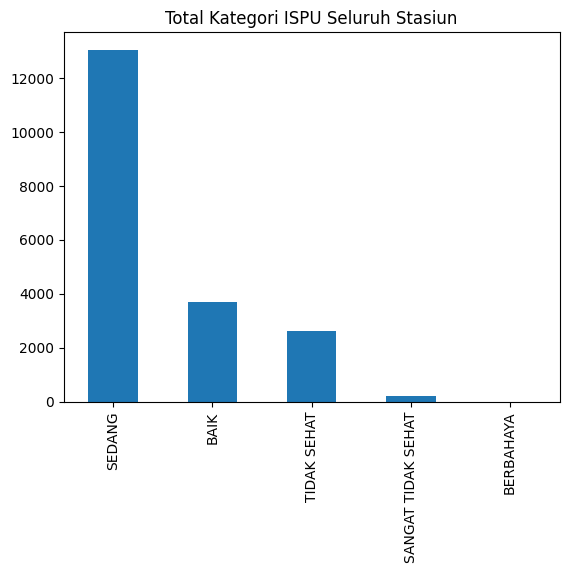

In [117]:
print(100*ispuRaw['categori'].value_counts(normalize=True))
ispuRaw['categori'].value_counts().plot(kind='bar', title="Total Kategori ISPU Seluruh Stasiun")

Berdasarkan grafik ini dapat disimpulkan bahwa kategori ISPU maksimum di 5 stasiun SPKU di DKI Jakarta mayoritas kategori Sedang dengan persentase 66.76%, diikuti dengan kategori Baik dengan persentase 18.86%, Tidak Sehat dengan persentase 13.34%, Sangat Tidak Sehat dengan persentase 1.04% dan Berbahaya dengan persentase 0.005%

DKI1 (Bunderan HI)      4273
DKI2 (Kelapa Gading)    4032
DKI3 (Jagakarsa)        3980
DKI4 (Lubang Buaya)     3974
DKI5 (Kebon Jeruk)      3277
Name: stasiun, dtype: int64


<Axes: title={'center': 'Total Data yang Dicatat Setiap Stasiun'}>

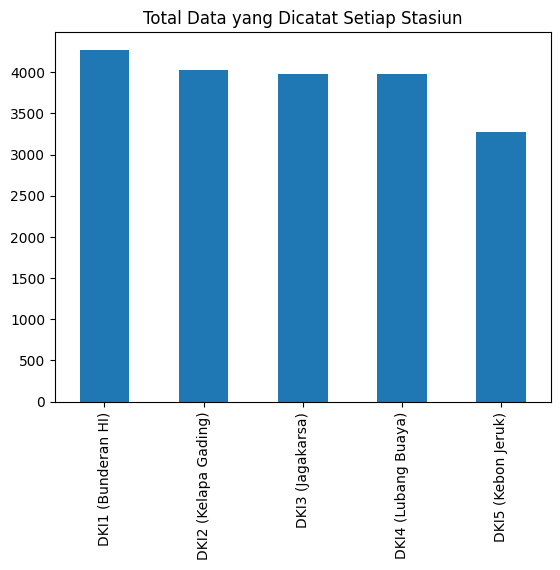

In [118]:
print(ispuRaw['stasiun'].value_counts())
ispuRaw['stasiun'].value_counts().plot(kind='bar', title="Total Data yang Dicatat Setiap Stasiun")

Berdasarkan grafik ini, total data ISPU yang dicatat oleh Stasiun DKI 1 sebesar 4273 data, DKI 2 sebesar 4032 data, DKI 3 sebesar 3980, DKI 4 sebesar 3974, dan DKI 5 sebesar 3277. Ini menunjukkan bahwa tidak semua stasiun melakukan pencatatan ISPU dalam satu hari yang sama.

## Buat Function untuk EDA

In [119]:
def eda_line_visualization(stasiun, component, title=None, startDate=None, endDate=None):
  fig, ax = plt.subplots(figsize=(75,10))
  if (title is None):
    title = "Nilai ISPU {0} {1}".format(component.upper(),
                                                  stasiun['stasiun'].iloc[0])
  if (None in (startDate, endDate)):
    x = stasiun.index
    y = [val if pd.notna(val) else None for val in stasiun[component]]
    plt.title(title)
  else:
    x = stasiun.loc[startDate: endDate].index
    y = [val if pd.notna(val) else None for val in stasiun.loc[
        startDate : endDate, component]]
    plt.title("{0} {2} - {3}"
      .format(title,
              datetime.datetime.strptime(startDate, "%Y-%m-%d").strftime("%d %B/%y"),
              datetime.datetime.strptime(endDate, "%Y-%m-%d").strftime("%d %B/%y"),))

  ax.plot(x, y, marker='o')
  ax.xaxis.set_major_locator(YearLocator())
  plt.xlabel("Tahun")
  plt.ylabel("ISPU")
  plt.grid(True)
  plt.show()
  plt.close()

def eda_line_visualizations(stasiun, startDate=None, endDate=None):
  # Tampilkan time series line chart setiap komponen pencemar
  for component in airPolutantComponents:
    fig, ax = plt.subplots(figsize=(75,10))
    x = stasiun.index
    if (None in (startDate, endDate)):
      y = [val if pd.notna(val) else None for val in stasiun[component]]
      plt.title("Nilai ISPU {0} {1}".format(component.upper(),
                                            stasiun['stasiun'].iloc[0]))
    else:
      y = [val if pd.notna(val) else None for val in stasiun.loc[
          startDate : endDate, component]]
      plt.title("Nilai ISPU {0} {1} {2} - {3}"
        .format(component.upper(), stasiun['stasiun'].iloc[0],
                datetime.datetime.strptime(startDate, "%Y-%m-%d").strftime("%d %B/%y"),
                datetime.datetime.strptime(endDate, "%Y-%m-%d").strftime("%d %B/%y"),))

    ax.plot(x, y, marker='o')
    ax.xaxis.set_major_locator(YearLocator())
    plt.xlabel("Tahun")
    plt.ylabel("ISPU")
    plt.grid(True)
    plt.show()
    plt.close()

def eda_skew(stasiun, component=None, title=None):
  if(component is None):
    for component in airPolutantComponents:
      fig, ax = plt.subplots(figsize=(25,10))
      # Clear NaN before create histogram
      data_no_nan = stasiun[component].dropna().to_numpy()
      sns.histplot(data_no_nan, kde=True)
      ax.set_xlabel('ISPU')
      ax.set_ylabel('Frequency')
      ax.set_title('Histogram Distribusi Nilai ISPU {0} {1}\nSkew Score: {2} ; Kurtosis Score: {3}'.format(
          component.upper(), stasiun['stasiun'].iloc[0],
          stats.skew(list(data_no_nan)), stats.kurtosis(list(data_no_nan))))
      plt.show()
      plt.close()
  else:
    fig, ax = plt.subplots(figsize=(25,10))
    # Clear NaN before create histogram
    data_no_nan = stasiun[component].dropna().to_numpy()
    sns.histplot(data_no_nan, kde=True)
    ax.set_xlabel('ISPU')
    ax.set_ylabel('Frequency')
    if (title is None):
      ax.set_title('Histogram Distribusi Nilai ISPU {0} {1}\nSkew Score: {2} ; Kurtosis Score: {3}'.format(
          component.upper(), stasiun['stasiun'].iloc[0],
          stats.skew(list(data_no_nan)), stats.kurtosis(list(data_no_nan))))
    else:
      ax.set_title('{0}\nSkew Score: {1} ; Kurtosis Score: {2}'.format(
          title,
          stats.skew(list(data_no_nan)), stats.kurtosis(list(data_no_nan))))
    plt.show()
    plt.close()


def eda_stasiun(stasiun):
  # Tampilkan jumlah Missing Value komponen polutan
  print("Missing Value untuk stasiun", stasiun['stasiun'].iloc[0])
  print(stasiun[airPolutantComponents[:-1]].isna().sum())
  print("Total:", stasiun[airPolutantComponents[:-1]].isna().sum().sum(),
        end="\n\n")

  # Tampilkan jumlah value yang bernilai 0
  print("Zero Value untuk stasiun", stasiun['stasiun'].iloc[0])
  print((stasiun[airPolutantComponents[:-1]] == 0).sum())
  print("Total:", stasiun[airPolutantComponents[:-1]].isna().sum().sum(),
        end="\n\n")

  # Set tanggal menjadi indeks
  stasiun = stasiun.set_index('tanggal')

  # Tampilkan range tanggal awal dan akhir dari data
  print("Range tanggal pada data stasiun")
  print(stasiun.index.min(), stasiun.index.max(), end="\n\n")

  eda_line_visualizations(stasiun)
  return stasiun

## Analisis ISPU DKI 1 (Bundaran HI)

### Analisis General

In [120]:
ispuDKI1[airPolutantComponents].describe()

,pm10,so2,co,o3,no2,pm25
count,4171.000000,4208.000000,4233.000000,4180.000000,4190.000000,365.000000
mean,52.226325,18.091017,24.852351,49.514593,14.107637,69.073973
std,14.578838,10.755446,11.153177,25.784704,8.948707,18.117065
min,4.000000,1.000000,3.000000,3.000000,1.000000,20.000000
25%,43.000000,10.000000,17.000000,29.000000,7.000000,57.000000
50%,54.000000,17.000000,24.000000,46.000000,14.000000,70.000000
75%,62.000000,25.000000,31.000000,66.000000,19.000000,81.000000
max,104.000000,106.000000,95.000000,198.000000,79.000000,112.000000


Berdasarkan tabel diatas
* Kandungan PM10 mendominasi dengan nilai ISPU rata-rata sebesar 52.29 dengan nilai maksimum 104
* Kandungan O3 menempati urutan kedua dengan nilai ISPU rata-rata 49.41 dengan nilai maksimum 198
* Kandungan CO menempati urutan ketiga dengan nilai ISPU rata-rata 24.81 dengan nilai maksmimum 95
* Kandungan SO2 menempati urutan keempat dengan nilai ISPU rata-rata sebesar 18.03 dengan nilai maksimum 106
* Kandungan NO2 menempati urutan terakhir dengan nilai ISPU rata-rata 14.01 dan nilai maksimum 79
* Kandungan PM25 memiliki nilai ISPU rata-rata sebesar 69.07 dengan nilai maksimum 112
* Secara angka, komponen PM25 menempati urutan tertinggi walaupun pengukurannya dimulai di tahun 2021 (Penjelasan lengkap akan dibahas di segmen Pengukuran PM2.5)

### Analisis Data dan Visualisasi Setiap Komponen Pencemar

Missing Value untuk stasiun DKI1 (Bunderan HI)
pm10    102
so2      65
co       40
o3       93
no2      83
dtype: int64
Total: 383

Zero Value untuk stasiun DKI1 (Bunderan HI)
pm10    0
so2     0
co      0
o3      0
no2     0
dtype: int64
Total: 383

Range tanggal pada data stasiun
2010-01-01 00:00:00 2021-12-31 00:00:00



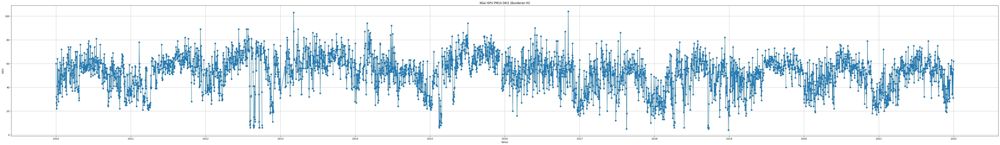

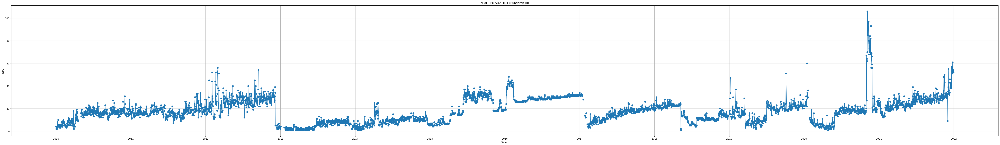

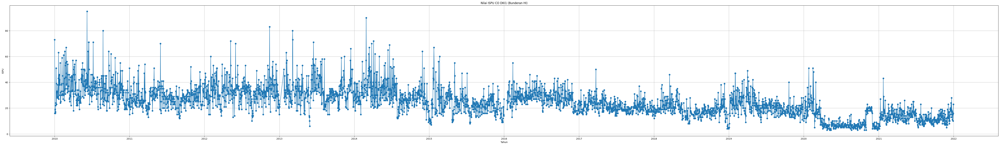

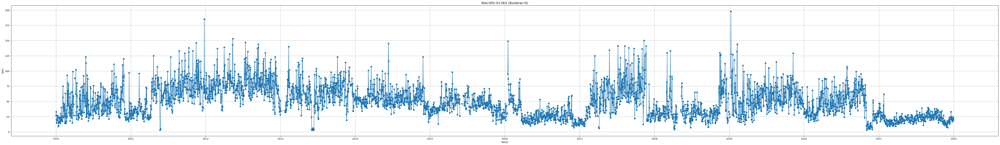

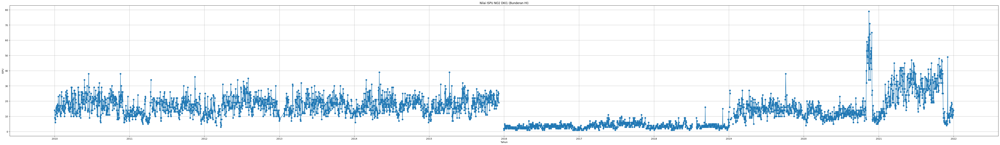

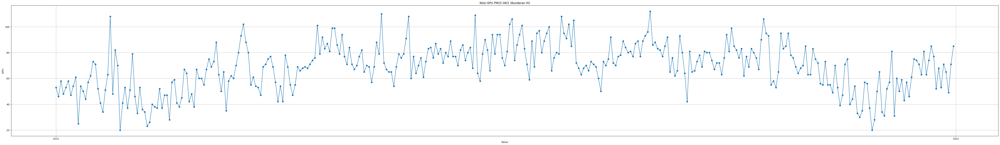

In [122]:
ispuDKI1 = eda_stasiun(ispuDKI1)

**Berdasarkan hasil analisis _Missing Value_, _Zero Value_ serta tanggal _Range_ berikut**
* Data dari DKI1 dicatat mulai dari tanggal 01 Januari 2010 hingga 31 Desember 2021
* Secara total, terdapat 383 Data NaN dimana PM10, O3, dan NO3 merupakan komponen udara yang paling banyak data NaN
* Selain itu, seluruh nilai data > 0


**Berdasarkan diagram PM10 berikut**
* Berdasarkan diagram tahun 2010 hingga 2015, terdapat sebuah tren dimana setiap akhir tahun, pergerakan indeks akan turun
* Berdasarkan diagram tahun 2016 hingga 2021
  * Pergerakan indeks sangat bervariatif dan berfluktuatif
  * Pada awal tahun 2016, terjadi peningkatan indeks PM10 hingga mendekati 150, kemudian indeks perlahan menurun hingga berada di bawah level indeks 50 hingga menurun di akhir tahun
  * Pada tahun 2017, terjadi tren peningkatan hingga berada di puncak di pertengahan hingga mendekati akhir tahun, kemudian indeks menurun secara tajam di akhir tahun dan stagnan di bawah level 50 hingga awal tahun 2018
  * Pada tahun 2018, terjadi peningkatan indeks hingga melewati 120, setelah itu terjadi penurunan. Peningkatan secara besar kembali terjadi di bulan November hingga turun di bulan Desember akhir
  * Pada tahun 2019, pergerakan sangat fluktuatif, dimana nilai indeks terjadi peningkatan sangat tajam di awal tahun dan di akhir tahun indeks akan menurun dibandingkan dengan rata-rata indeks selama tahun tersebut hingga awal tahun 2020
  * Pada tahun 2020, setelah penurunan terjadi tren peningkatan sejak bulan Maret hingga mengalami penurunan secara tajam sejak memasuki bulan November 2020. Peningkatan terjadi di akhir November dan mulai turun dan stagnan di bulan Desember hingga akhir tahun 2020
  * Pada tahun 2021, tren indeks sempat tinggi di Januari kemudian selama Febuari mengalami stagnasi hingga perlahan mengalami peningkatan dari Maret hingga Agustus dan September. Setelah itu mengalami tren penurunan hingga akhir November dan kembali mengalami peningkatan di Desember


**Berdasarkan diagram O3 berikut**
* Selama tahun 2010 hingga 2012 terjadi tren peningkatan indeks O3, kemudian terjadi penurunan hingga awal tahun 2016
* Pada tahun 2016, setelah terjadi peningkatan yang tajam di awal bulan, tren penurunan kembali terjadi hingga pertengahan tahun, kemudian perlahan naik hingga kembali turun di akhir tahun
* Pada tahun 2017, indeks mengalami tren peningkatan yang cukup besar hingga mendekati akhir tahun dan mengalami penurunan hingga awal tahun 2018
* Pada tahun 2018 terjadi peningkatan mendekati pertengahan tahun dan mendekati akhir tahun
* Pada tahun 2019 diawali dengan peningkatan indeks yang sangat tajam hingga mendekati level 200, selain itu terjadi tren peningkatan hingga mendekati akhir tahun dan mengalami tren penurunan hingga mendekati pertengahan tahun 2020
* Pada tahun 2020 terjadi peningkatan hingga mengalami penurunan secara dalam mendekati akhir tahun kemudian mulai meningkat di akhir tahun
* Pada tahun 2021 terdapat tren peningkatan hingga pertengahan tahun kemudian mengalami penurunan dan peningkatan di akhir tahun. Meskipun begitu, tingkat indeks dan fluktuasi di tahun 2021 lebih rendah dibandingkan dengan tahun-tahun sebelumnya

**Berdasarkan diagram SO2 berikut**
* Dari 2010 hingga 2012 terjadi tren peningkatan indeks SO2.
* Pada akhir tahun 2012, terjadi penurunan hingga awal tahun 2013
* Meskipun awal tahun 2013 pergerakan indeks bersifat stagnan, namun perlahan terjadi peningkatan nilai indeks hingga mendekati akhir tahun, setelah itu terjadi penurunan hingga awal tahun 2014
* Pada tahun 2014 kembali terjadi tren peningkatan. Peningkatan paling pesat terjadi pada bulan April dan mulai mengalami penurunan di akhir tahun
* Pada tahun 2015 terjadi peningkatan yang cukup pesat, terutama di bulan April dan pali besar terjadi di bulan Juni hingga Oktober, setelah itu terjadi penurunan dan sempat meningkat di awal Desember yang setelah itu kembali stagnan hingga akhir tahun
* Pada awal tahun 2016 terjadi peningkatan yang sangat tajam dan mulai menurun di pertengahan bulan Febuari. Pada bulan Maret hingga April, indeks mengalami stagnasi dan mulai April pertengahan mengalami tren kenaikan secara perlahan hingga tahun 2017 awal
* Pada awal tahun 2017, grafik terputus yang disebabkan indeks SO2 di tanggal tersebut tidak tercatat, namun bisa terlihat dari data-data berikutnya, posisi indeks berada lebih rendah dibandingkan indeks di awal tahun. Kemungkinan di antara tanggal dimana indeks SO2 tidak tercatat, telah terjadi tren penurunan indeks.
* Di bulan Febuari 2017 kembali terjadi tren peningkatan indeks SO2 dan mengalami perlambatan sejak di pertengahan November, namun tetap terjadi peningkatan indeks hingga akhir tahun
* Pada tahun 2018, peningkatan indeks tetap terus terjadi  hingga mengalami penurunan di pertengahan tahun, kemudian kembali terjadi peningkatan hingga pada akhir tahun terjadi penurunan
* Pada tahun 2019, indeks tetap bergerak naik dan pada bulan Maret akhir terjadi penurunan yang cukup besar. Setelah penurunan, indeks tetap stagnan di dibawah level 20 ISPU hingga mengalami peningkatan kembali di awal Juli. Tren ini terus berlangsung meskipun bergerak lambat hingga awal tahun 2020
* Pada tahun 2020 terjadi lonjakan kenaikan indeks SO2 hingga melampaui level 60 ISPU. Setelah itu terjadi tren penurunan hingga pertengahan bulan dan mulai meningkat hingga terjadi peningkatan yang sangat tajam di bulan November dan menurun hingga awal Desember. Setelah itu indeks kembali mulai stagnasi hingga akhir tahun
* Pada tahun 2021 indeks bergerak menurun kemudian kembali naik dengan cukup cepat hingga pada akhir tahun, indeks sudah menyentuk di level antara level 40 dan 60 ISPU

**Berdasarkan diagram NO2 berikut**
* Pada tahun 2010 hingga 2015, pergerakan indeks NO2 mengalami satu tren yang sama dimana indeks akan meningkat hingga pertengahan tahun dan mengalami penurunan di akhir dan awal tahun berikutnya
* Pada tahun 2015 akhir terjadi penurunan yang signifikan sehingga pada akhir tahun 2015 hingga pertengahan Januari 2017, indeks bergerak stagnan mendekati level 5 ISPU
* Kemudian terjadi peningkatan secara perlahan hingga di Oktober-November 2017 terjadi penurunan dan kembali stagnan hingga akhir 2019
* Setelah itu terjadi peningkatan yang cukup drastis hingga pertengahan tahun 2019. Setelah itu terjadi stagnasi dan kembali menurun mendekati akhir tahun
* Pada tahun 2020, terjadi peningkatan di awal tahun dan terjadi stagnasi hingga secara perlahan menurun di akhir Maret
* Setelah memasuki bulan Maret 2020, terjadi peningkatan secara lambat hingga terjadi puncaknya dimana pergerakan indeks meningkat drastis di akhir Oktober dan November 2020. Indeks kembali menurun dengan tajam di akhir November dan penurunan melambat hingga mendekati akhir tahun.
* Di akhir tahun 2020, indeks bergerak naik hingga mencapai puncaknya di Juni 2021, kemduian menurun di bulan Juli dan perlahan naik hingga akhir Oktober.
* Setelah itu terjadi penurunan yang tajam, dan tidak lama berselang terjadi fluktuasi yang tajam hingga kembali turun dan perlahan memulai tren kenaikan indeks di akhir tahun

**Berdasarkan diagram CO berikut**
* Berdasarkan data di tahun 2010 hingga 2015, indeks CO mengalami tren kenaikan dan penurunan secara rutin dengan detail sebagai berikut
  * Sejak 2010, indeks CO mengalami tren peningkatan dan beberapa bulan kemudian, indeks perlahan mengalami penurunan hingga di pertengahan tahun 2011
  * Setelah pertengahan tahun 2011, indeks mengalami peningkatan yang lambat hingga awal tahun 2012
  * Di tahun 2012, indeks mengalami fluktuatif dimana di separuh pertama tahun menglami penurunan sebanyak dua kali, kemudian di bulan Agustus mengalami penurunan paling rendah, setelah itu kembali meningkat hingga pengalami penurunan kembali di Desember
  * Di tahun 2013 diawali dengan peningkatan indeks yang cukup besar, kemudian dilanjutkan dengan fluktuatifnya indeks dimana terjadi kenaikan yang paling besar di pertengahan bulan diikuti dengan penurunan yang tajam setelahnya. Setelah itu indeks berangsur-angsur menaik walaupun pergerakannya sangat fluktuatif hingga akhir tahun
  * Indeks mengalami penurunan paling besar di akhir tahun 2014 dan awal tahun 2015, akhir April dan awal Bulan Mei 2015 dan bulan Agustus 2015
  * Indeks mulai menurun di akhir tahun 2015
* Bedasarkan data di tahun 2016 hingga 2021, pergerakan indeks CO tidak sebesar di _range_ waktu sebelumnya dengan detail sebagai berikut
  * Di awal tahun 2016, indeks mengalami peningkatan yang konsisten dan sempat melewati level 50 ISPU. Namun setelah itu, indeks tidak pernah melewati level 50 ISPU dan sejak mendekati akhir tahun, indeks bergerak menurun hingga akhir tahun
  * Di tahun 2017, indeks kembali menaik, meskipun tidak sebesar tahun sebelumnya namun setelahnya indeks justru semakin menurun. Peningkatan sempat kembali terjadi di pertengahan September, meskipun peningkatannya sangat fluktuatif. Di bulan November, indeks perlahan menurun dan mulai berada di rata-rata level di bawah 25 ISPU hingga akhir tahun
  * Di tahun 2018, tren serupa kembali terjadi, namun di tahun tersebut, tingkat penurunan indeksnya lebih besar dan lebih lama dibandingkan dengan tahun lalu
  * Di tahun 2019, indeks kembali mengalami apa yang terjadi di dua tahun sebelumnya dimana di awal tahun mengalami peningkatan yang peningkatan kemudian di pertengahan tahun mengalami penurunan. Namun di tahun ini, terjadi peningkatan cukup konsisten di akhir tahun hingga puncaknya terjadi di awal tahun 2020
  * Di awal tahun 2020, indeks pengalami puncak kenaikannya sejak akhir tahun lalu, dan kemudian melandai dengan cukup dalam di pertengahan tahun, meskipun sempat mengalami peningkatan yang drastis menjelang akhir tahun, namun indeks kembali menurun di bawah level 10 ISPU hingga akhir tahun.
  * Di tahun 2021, indeks mengalmi kenaikan, meskipun begitu indeks bergerak sangat fluktuatif rata-rata berada di _range_ 10 hingga 25 ISPU, dan setelah itu mengalami penurunan rata-rata nya di pertengahan tahun hingga akhir tahun mengalami tren kenaikan

### Analisis Skew dan Kurtosis

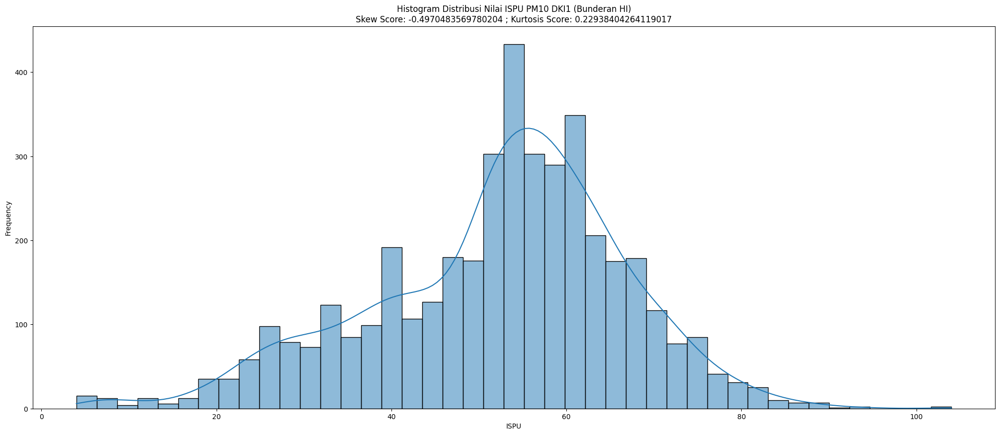

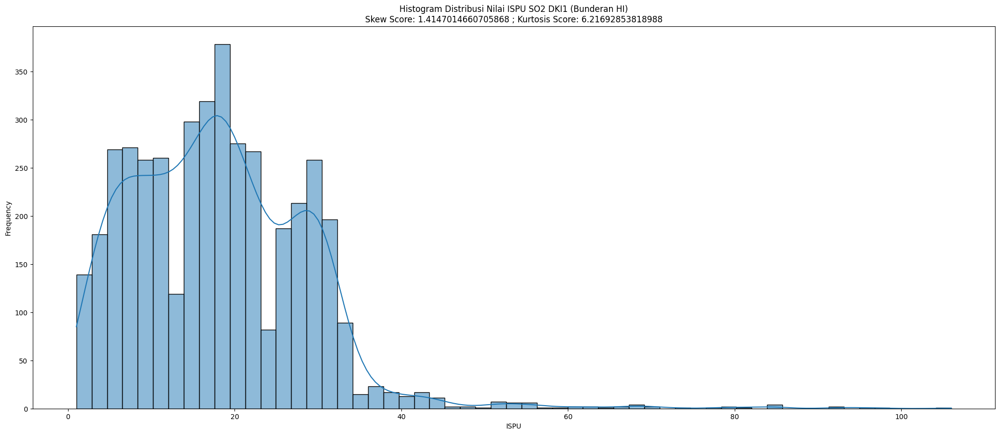

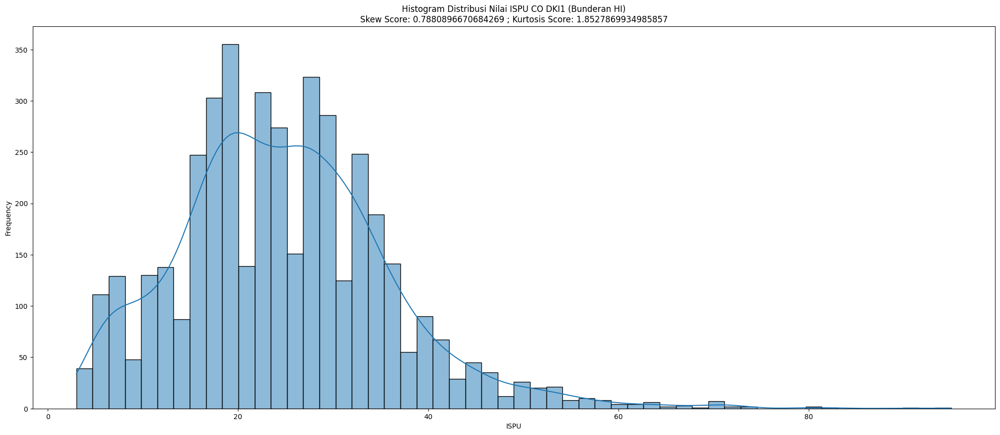

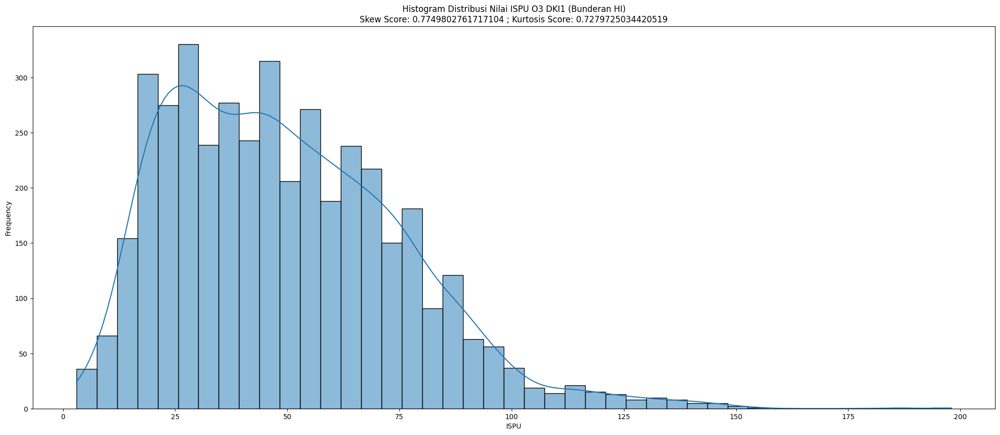

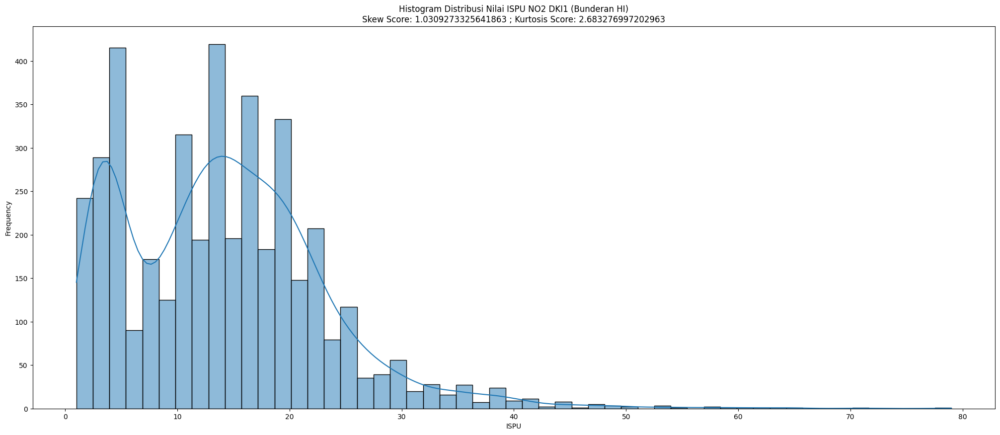

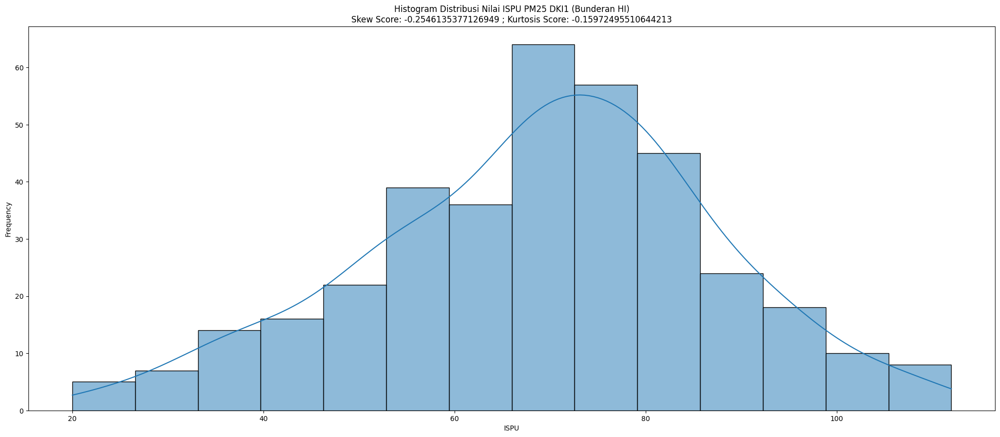

In [123]:
eda_skew(ispuDKI1)

Berdasarkan histogram berikut, seluruh histogram selain Histogram PM10 dan PM2.5 memiliki distribusi positif dimana _tail_ kanan lebih panjang dibandingkan _tail_ kiri dimanai skor skew rata-rata berada diluar range -0.5 sampai 0.5

## Analisis ISPU DKI 2 (Kelapa Gading)

### Analisis General

In [124]:
ispuDKI2[airPolutantComponents].describe()

,pm10,so2,co,o3,no2,pm25
count,3904.000000,3971.00000,3992.000000,3983.000000,3998.000000,349.000000
mean,55.346311,20.39864,18.552104,76.434597,15.136818,76.647564
std,16.832141,14.18512,9.638195,45.938942,7.674061,20.001699
min,10.000000,1.00000,1.000000,3.000000,2.000000,29.000000
25%,45.000000,11.00000,12.000000,47.000000,11.000000,61.000000
50%,58.000000,17.00000,16.000000,64.000000,14.000000,79.000000
75%,67.000000,25.00000,23.000000,90.000000,18.000000,90.000000
max,116.000000,103.00000,75.000000,314.000000,148.000000,129.000000


Berdasarkan tabel diatas
* Kandungan O3 mendominasi dengan nilai ISPU rata-rata sebesar 76.47 dengan nilai maksimum 314
* Kandungan PM10 menempati urutan kedua dengan nilai ISPU rata-rata 55.20 dengan nilai maksimum 116
* Kandungan SO2 menempati urutan ketiga dengan nilai ISPU rata-rata 20.44 dengan nilai maksmimum 103
* Kandungan CO menempati urutan keempat dengan nilai ISPU rata-rata sebesar 18.50 dengan nilai maksimum 75
* Kandungan NO2 menempati urutan terakhir dengan nilai ISPU rata-rata 15.09 dan nilai maksimum 148
* Kandungan PM25 memiliki nilai ISPU rata-rata sebesar 76.65 dengan nilai maksimum 129
* Secara angka, komponen PM25 menempati urutan tertinggi walaupun pengukurannya dimulai di tahun 2021 (Penjelasan lengkap akan dibahas di segmen Pengukuran PM2.5)

### Analisis Data dan Visualisasi Setiap Komponen Pencemar

Missing Value untuk stasiun DKI2 (Kelapa Gading)
pm10    128
so2      61
co       40
o3       49
no2      34
dtype: int64
Total: 312

Zero Value untuk stasiun DKI2 (Kelapa Gading)
pm10    0
so2     0
co      0
o3      0
no2     0
dtype: int64
Total: 312

Range tanggal pada data stasiun
2010-11-04 00:00:00 2021-12-31 00:00:00



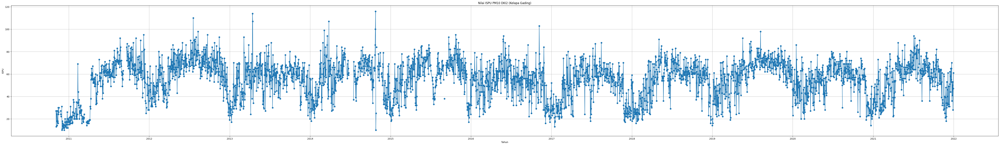

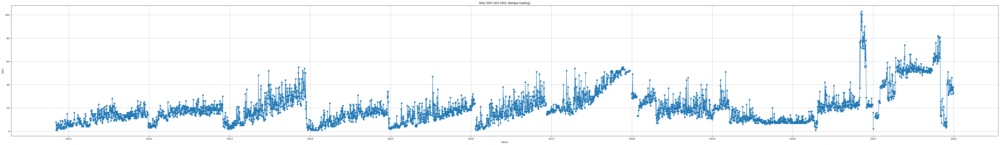

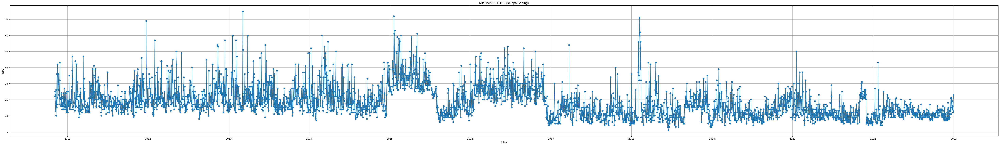

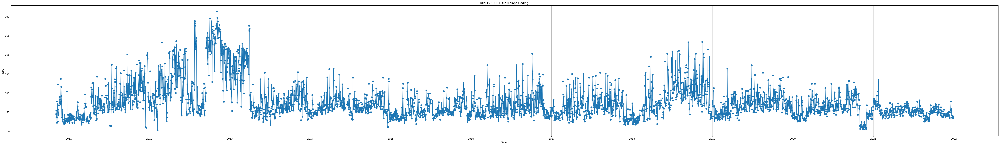

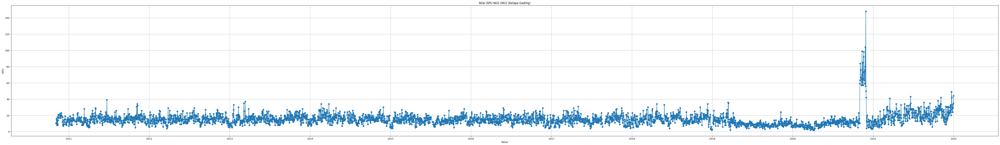

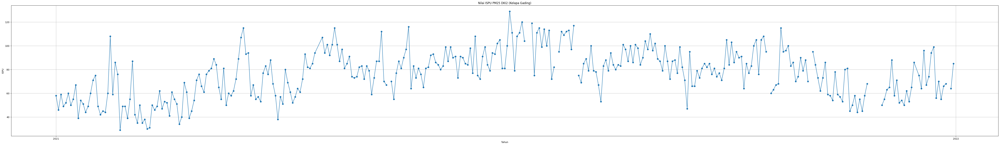

In [126]:
ispuDKI2 = eda_stasiun(ispuDKI2)

**Berdasarkan hasil analisis _Missing Value_, _Zero Value_ serta tanggal _Range_ berikut**
* Data dari DKI2 dicatat mulai dari tanggal 04 November 2010 hingga 31 Desember 2021
* Secara total, terdapat 312 Data NaN dimana PM10, SO2, dan O3 merupakan komponen udara yang paling banyak data NaN
* Selain itu, seluruh nilai data > 0

**Berdasarkan diagram PM10 berikut**
* Dari tahun 2010 akhir hingga 2012, terdapat _tren_ dimana dari awal tahun terjadi kenaikan indeks hingga pertengahan tahun, kemudian disusul dengan penurunan hingga akhir tahun
* Namun, mulai dari tahun 2013 hingga 2015, dimana terjadi penurunan di pertengahan tahun dimana penurunan tersebut cukup dalam, namun akan kembali naik dan akan menurun di akhir tahun.
* Sejak tahun 2016, pergerakan sangat _seasonial_ dan mirip dengan situasi sebelum tahun 2013

**Berdasarkan diagram O3 berikut**
* Dari akhir tahun 2010 hingga mendekati akhir tahun 2012, terjadi tren peningkatan indeks O3, meskipun sempat menurun di awal tahun 2012 dan pertengahan tahun 2012, namun secara garis besar, tren bergerak menaik
* Setelah itu tren bergerak turun hingga memasuki tahun 2013 dimana hingga tahun 2015 terdapat tren dimana akan terjadi kenaikan sebanyak 2 kali di mendekati dan setelah pertengahan tahun, dan akan menurun di pertengahan tahun dan akhir tahun
* Di tahun 2016, pergerakan terlihat sangat berfluktuatif, meskipun di awal dan akhir tahun terjadi penurunan
* Di tahun 2017 hingga 2019, terdapat tren pergerakan dimana indeks akan bergerak naik hingga pertengahan tahun dan akan turun hingga akhir tahun
* Pada tahun 2018, tren terlihat berbeda dimana kenaikannya paling tinggi  hingga beberapa kali melewati batas 200 ISPU
* Di tahun 2020, indeks bergerak mirip dengan di tahun 2016, namun terjadi penurunan paling dalam mendekati akhir tahun 2020
* Di tahun 2021, indeks bergerak stagnan setelah awal tahun mengalami penurunan

**Berdasarkan diagram SO2 berikut**
* Sejak akhir tahun 2010 hingga 2017, pergerakan bergerak secara _seasional_ dimana indeks akan bergerak naik dan akan turun mendekati akhir tahun
* Di tahun 2018, indeks justru menurun dan stagnan mendekati pertengahan tahun hingga akhir tahun
* Di tahun 2019, indeks kembali menurun setelah awal tahun dan bergerak stagnan dan tidak sefluktuatif di tahun sebelumnya
* Di tahun 2020, indeks mulai bergerak mirip seperti sebelum tahun 2018, namun pergerakan mendekati akhir tahun mengalami peningkatan sangat tinggi, setelah itu kembali jatuh dan bergerak menurun di awal tahun berikutnya
* Di tahun 2021, meskipun masih sangat fluktuatif seperti tahun lalu dan pergerakan naiknya cukup tajam, namun pola yang dibentuk mulai mendekati seperti pola sebelum tahun 2018, meskipun sempat mengalami penurunan yang sangat tajam mendekati akhir tahun

**Berdasarkan diagram NO2 berikut**
* Pergerakan indeks sejak 2010 akhir hingga 2019 pertengahan mengalami stagnasi dimana tidak terlihat terjadinya tren kenaikan atau penurunan secara garis besar
* Pada tahun 2019 hingga pertengahan 2020, indeks mulai bergerak menurun meskipun lambat dan tidak terlalu besar
* Mendekati pertengahan tahun 2020, indeks mulai bergerak naik dan setelahnya mengalami kenaikan yang signifikan hingga menembus level 140 ISPU, setelah itu indeks turun dengan tajam
* Di akhir tahun 2020 hingga 2021, indeks mulai menunjukan pergerakan menaik secara perlahan, hingga indeks telah melewati level 40 ISPU

**Berdasarkan diagram CO berikut**
* Berdasarkan data tahun 2011 hingga 2015 terdapat pola dimana di akhir dan awal tahun berikutnya terjadi peningkatan indeks, selain itu indeks juga meningkat mendekati pertengahan bulan atau awal bulan
* Peningkatan terbesar terjadi di awal tahun 2015
* Pada tahun 2016, indeks bergerak sedikit berbeda dimana terjadi fluktuasi, dan mengalami penurunan di akhir tahun
* Pada awal tahun 2017, indeks menurun dan mulai mengalami pola yang terjadi sebelum tahun 2015
* Sejak tahun 2018 hingga 2021, pola bergerak dimana sempat mengalami peningkatan di awal tahun dan menurun di pertengahan tahun, kemudian meningkat di akhir tahun, namun di tahun 2021, pergerakan tidak sefluktuatif di tahun-tahun sebelumnya

### Analisis Skew dan Kurtosis

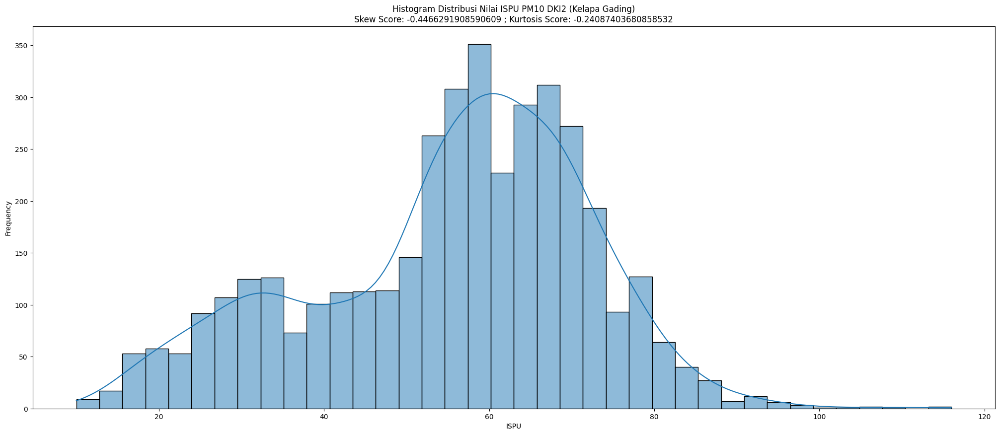

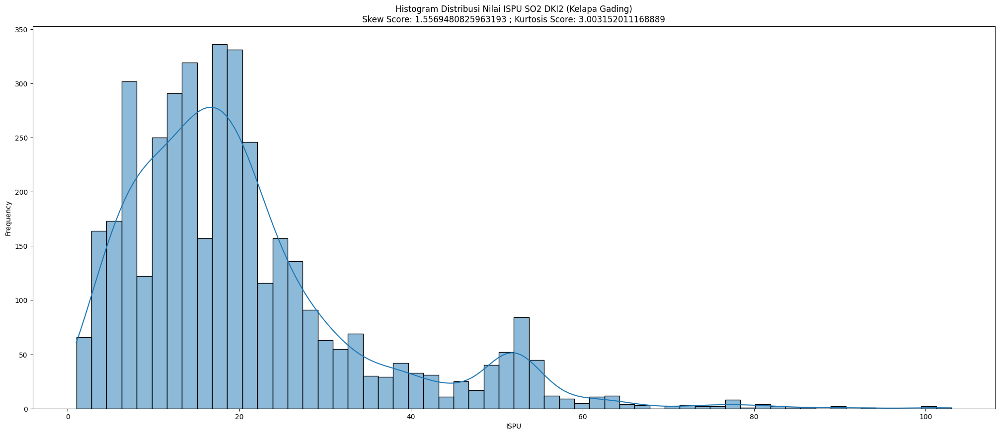

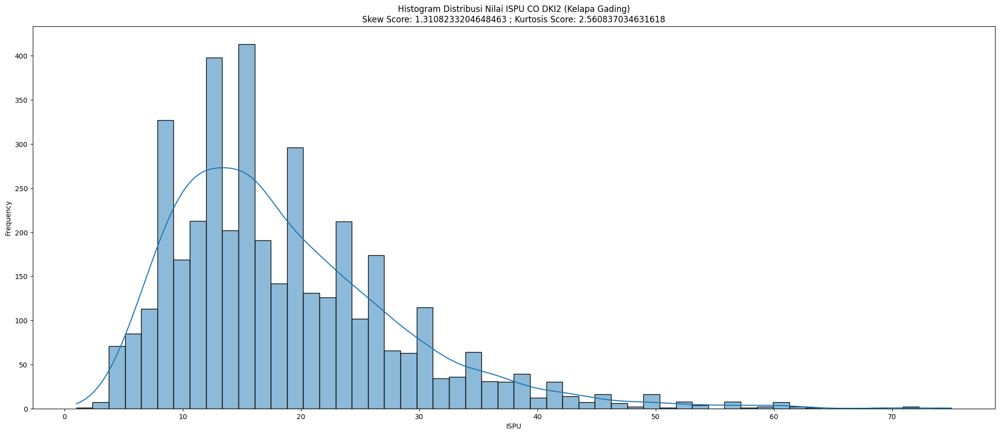

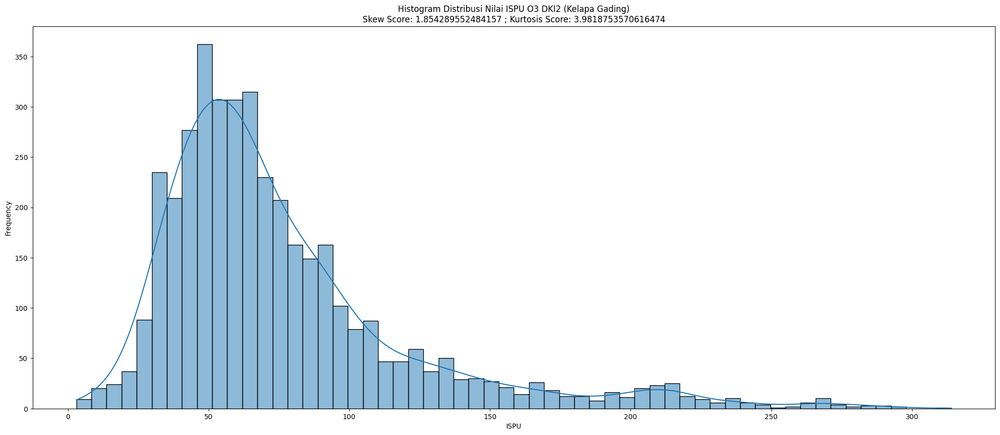

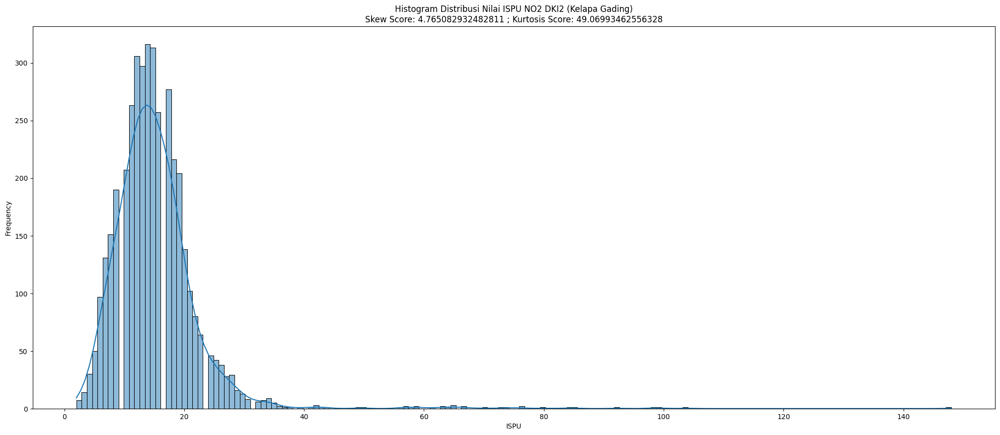

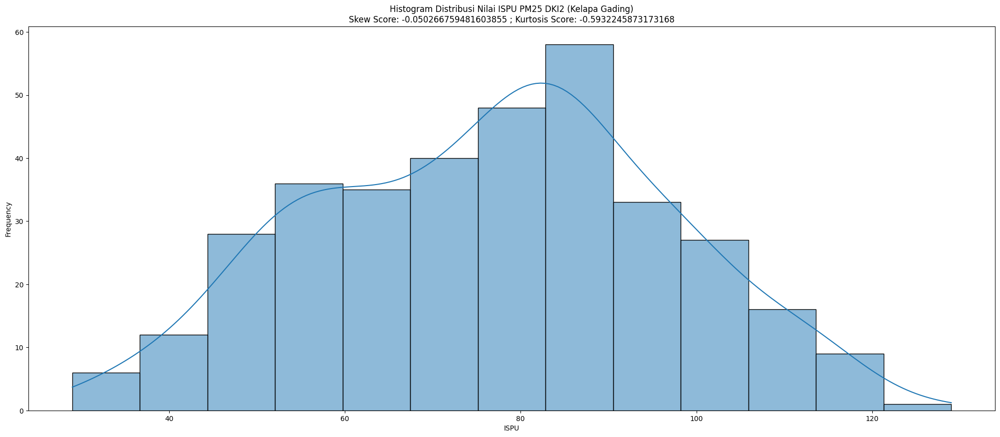

In [127]:
eda_skew(ispuDKI2)

Berdasarkan histogram berikut, seluruh histogram selain Histogram PM10 dan PM2.5 memiliki distribusi positif dimana _tail_ kanan lebih panjang dibandingkan _tail_ kiri dimanai skor skew rata-rata berada diluar range -0.5 sampai 0.5

## Analisis ISPU DKI 3 (Jakagarsa)

### Analisis General

In [128]:
ispuDKI3[airPolutantComponents].describe()

,pm10,so2,co,o3,no2,pm25
count,3772.000000,3833.000000,3927.000000,3902.000000,3762.000000,358.000000
mean,43.192736,15.937125,19.974026,69.049462,8.966241,74.240223
std,18.359798,12.900918,11.254652,33.132569,6.461156,23.140500
min,2.000000,0.000000,1.000000,4.000000,1.000000,13.000000
25%,27.000000,7.000000,12.000000,43.000000,6.000000,62.000000
50%,46.000000,13.000000,18.000000,69.000000,8.000000,76.500000
75%,57.000000,19.000000,25.000000,90.000000,11.000000,89.000000
max,118.000000,112.000000,98.000000,274.000000,107.000000,132.000000


Berdasarkan tabel diatas
* Kandungan O3 mendominasi dengan nilai ISPU rata-rata sebesar 69.01 dengan nilai maksimum 118
* Kandungan PM10 menempati urutan kedua dengan nilai ISPU rata-rata 43.55 dengan nilai maksimum 274
* Kandungan CO menempati urutan ketiga dengan nilai ISPU rata-rata 19.94 dengan nilai maksmimum 98
* Kandungan SO2 menempati urutan keempat dengan nilai ISPU rata-rata sebesar 15.74 dengan nilai maksimum 112
* Kandungan NO2 menempati urutan terakhir dengan nilai ISPU rata-rata 8.79 dan nilai maksimum 107
* Kandungan PM25 memiliki nilai ISPU rata-rata sebesar 74.24 dengan nilai maksimum 132
* Secara angka, komponen PM25 menempati urutan tertinggi walaupun pengukurannya dimulai di tahun 2021 (Penjelasan lengkap akan dibahas di segmen Pengukuran PM2.5)

### Analisis Data dan Visualisasi Setiap Komponen Pencemar

Missing Value untuk stasiun DKI3 (Jagakarsa)
pm10    208
so2     147
co       53
o3       78
no2     218
dtype: int64
Total: 704

Zero Value untuk stasiun DKI3 (Jagakarsa)
pm10     0
so2     30
co       0
o3       0
no2      0
dtype: int64
Total: 704

Range tanggal pada data stasiun
2010-11-07 00:00:00 2021-12-31 00:00:00



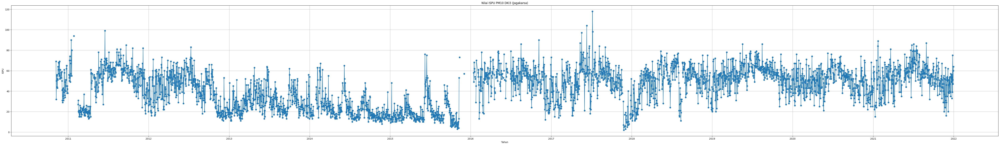

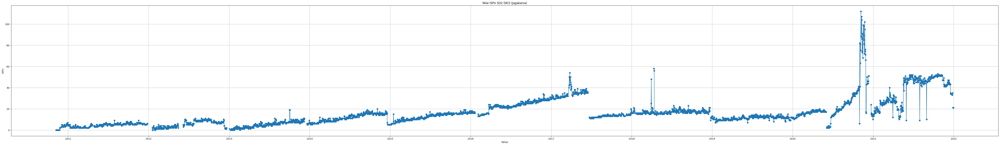

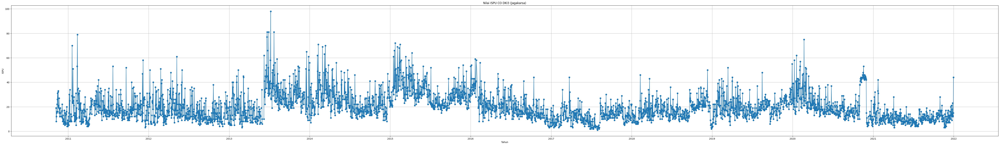

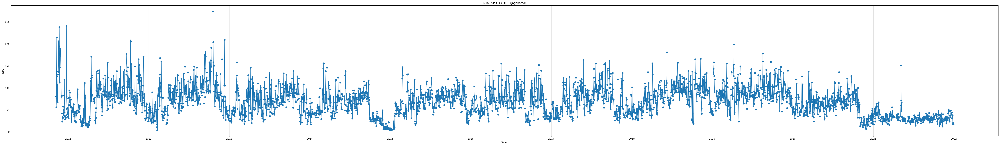

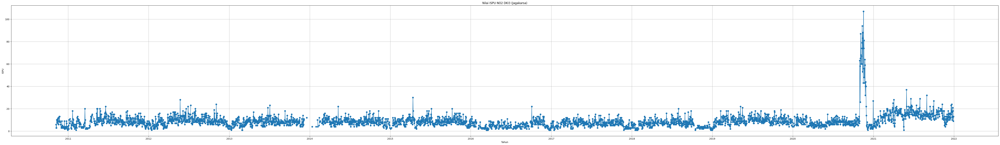

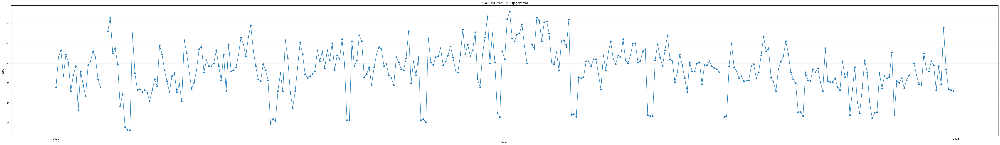

In [130]:
ispuDKI3 = eda_stasiun(ispuDKI3)

**Berdasarkan hasil analisis _Missing Value_, _Zero Value_ serta tanggal _Range_ berikut**
* Data dari DKI3 dicatat mulai dari tanggal 07 November 2010 hingga 31 Desember 2021
* Secara total, terdapat 704 Data NaN dimana PM10, SO2, dan O3 merupakan komponen udara yang paling banyak data NaN
* Selain itu, seluruh nilai data > 0 kecuali SO2 dimana terdapat 30 data yang bernilai 0

**Berdasarkan diagram PM10 berikut**
* Nilai PM10 mengalami tren penurunan dimulai di akhir 2012 hingga akhir 2015
* Terjadi peningkatan mulai tahun 2016 dan berada di puncaknya di tahun 2017
* Setelah itu terjadi penurunan di akhir tahun 2017 hingga merangkak naik di awal tahun 2018
* Sejak 2018, nilai ISPU PM10 mengalami tren _seasonial_ hingga akhir 2021

**Berdasarkan diagram O3 berikut**
* Nilai O3 umumnya mengalami tren penurunan menjelang akhir tahun hingga awal tahun berikutnya.
* Berdasarkan data tahun 2010 hingga 2015
  * Nilai O3 mencapat puncaknya di bulan November 2010 dan Oktober - November 2012
  * Penurunan nilai O3 cukup drastis terjadi akhir tahun 2014, awal dan akhir tahun 2015
* Berdasarkan data tahun 2016 hingga 2021
  * Pola musiman dimana setiap akhir dan awal tahun, kadar O3 menurun terap terjadi
  * Meskipun begitu, penurunan di akhir tahun 2018 hingga awal tahun 2019 tidak sebesar tahun-tahun sebelumnya
  * Terjadi penurunan kadar O3 secara drastis sejak akhir tahun 2020 hingga akhir tahun 2021
  * Meskipun sempat terjadi lonjakan yang cukup tajam di sekitar pertengahan tahun 2021
  * Terjadinya penurunan kadar O3 secara drastis sejak akhir tahun 2020 bertepatan kebijakan PSBB total dan PPKM yang berlaku di Jakarta waktu itu.

**Berdasarkan diagram SO2 berikut**
* Adanya pola _seasional_ yang terjadi dari Desember 2010 hingga pertengahan 2017
* Selain itu sejak tahun 2010 hingga 2014, nilai ISPU SO2 mengalami tren penurunan hingga awal tahun berikutnya.
* Berdasarkan data dari tahun 2010 hingga 2015
  * Secara perlahan dan pasti, nilai ISPU SO2 mengalami peningkatan.
  * Puncak nilai SO2 berada di tahun 2014 dan 2015, terutama menjelang akhir tahun.
  * Pada tahun 2015, nilai SO2 tetap tinggi hingga akhir tahun
* Berdasarkan data dari tahun 2016 hingga 2021
  * Tren peningkatan SO2 sempat menurun di sekitar Febuari dan Maret 2016, dan secara perlahan merangkak naik hingga tahun 2017 pertengahan
  * Setelah itu, nilai SO2 menurun drastis dan berikutnya secara berangsur menurun hingga mengalami peningkatan secara perlahan di tahun 2020 awal hingga pertengahan
  * Setelah sempat mengalami penurunan di pertengahan tahun 2020, nilai SO2 mengalami peningkatan secara tajam, terutama mendekati akhir tahun 2020.
  *  Meski sempat menurun di akhir tahun 2020 dan awal tahun 2021, nilai SO2 mengalami peningkatan hingga mendekati pertengahan tahun, dan kembali meningkat setelah sempat mengalami penurunan yang cukup besar hingga akhir tahun.

**Berdasarkan diagram NO2 berikut**
* Terdapat pola _seasional_ dimana nilai NO2 akan mengalami penurunan di setiap akhir hingga awal tahun berikutnya.
* Meskipun begitu, ada beberapa hari yang tidak tercatat oleh stasiun pemantauan, terutama di akhir tahun 2013 hingga awal tahun 2014
* Berdasarkan data dari tahun 2010 hingga 2015
  * Kadar NO2 umumnya mengalami peningkatan di pertengahan tahun, kecuali di tahun 2014 dan 2015
  * Pada tahun 2014 dan 2015, kadar NO2 mengalami peningkatan menjelang dan akhir pertengahan tahun
* Berdasarkan data dari tahun 2016 hingga 2021
  * Meskipun membentuk pola yang mirip dengan _range_ tahun 2010 hingga 2015, namun pola di _range_ ini sedikit berfluaktif
  * Pada akhir pertengahan 2016, nilai NO2 sempat mengalami peningkatan hingga nilai ISPU melewati 20.
  * Sedangkan pada tahun 2020, terjadi peningkatan indeks NO2 yang sangat drastis hingga melewati ISPU 100

**Berdasarkan diagram CO berikut**
* Indeks CO mengalami peningkatan yang cukup tajam di awal tahun 2011 dan kembali menurun menjelang pertengahan tahun 2011
* Kemudian sejak pertengahan tahun 2012, nilai indeks mengalami tren penurunan hingga pertengahan tahun 2013
* Namun Indeks CO mengalami peningkatan yang cukup besar sejak pertengahan tahun 2013
* Indeks CO kembali mengalami penurunan sejak awal tahun 2016 hingga pertengahan tahun 2017
* Setelah itu indeks CO perlahan naik hingga berada di puncaknya di awal tahun 2020
* Setelah itu tren penurunan kembali terjadi dan mengalami stagnansi sejak akhir tahun 2020 hingga akhir tahun 2021

### Analisis Skew dan Kurtosis

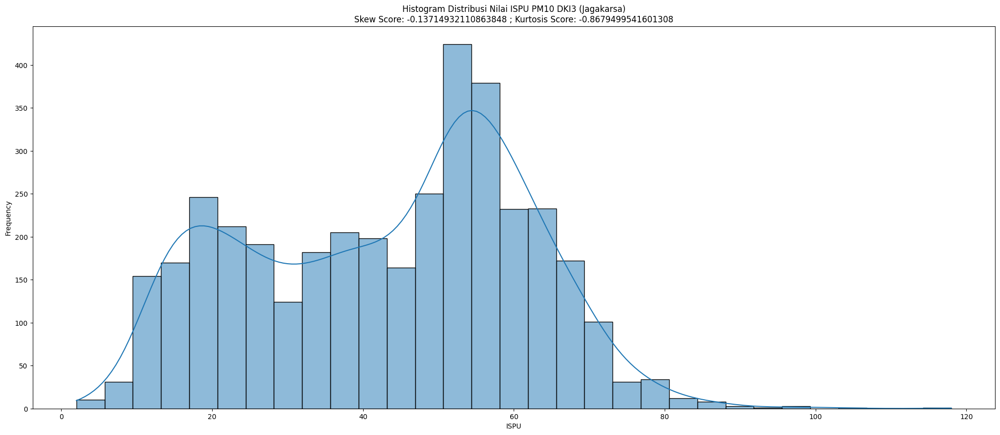

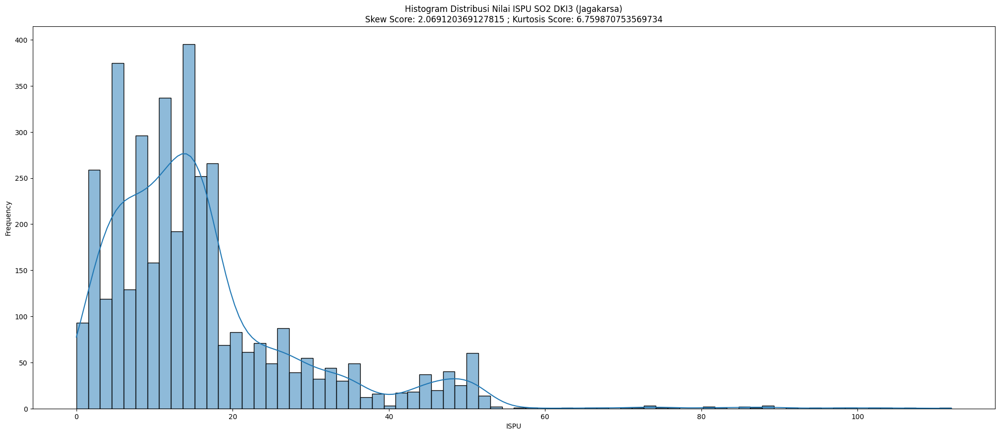

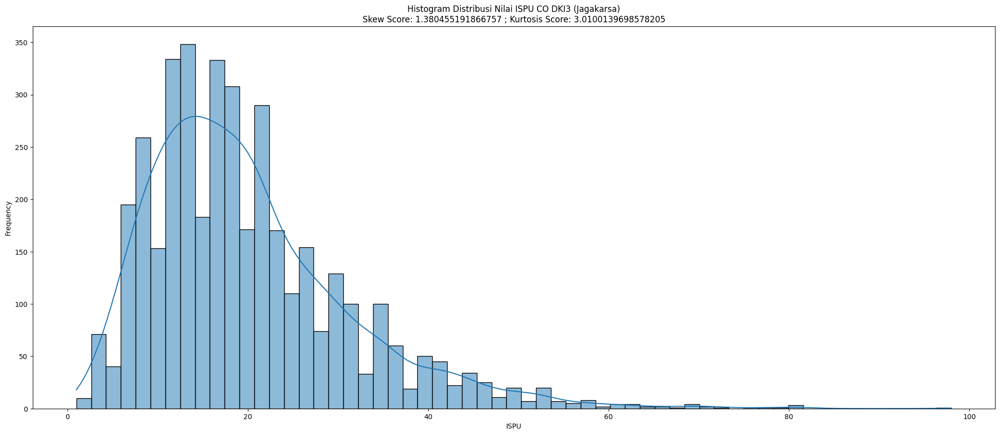

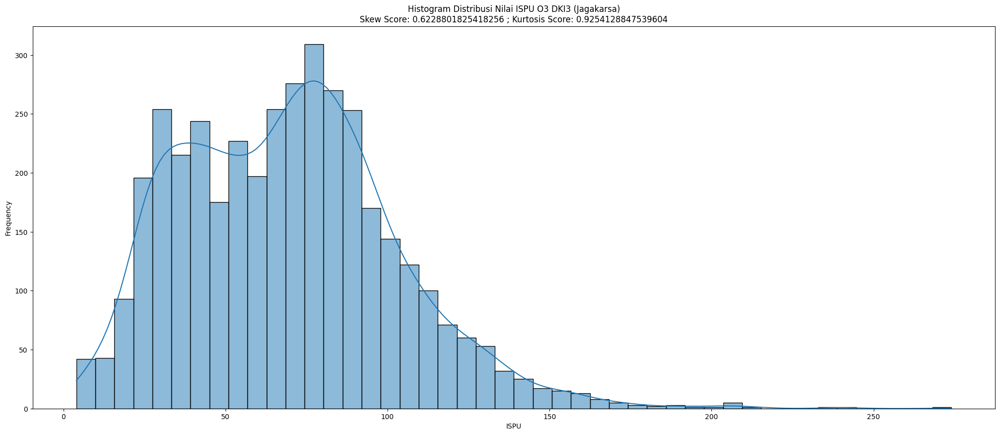

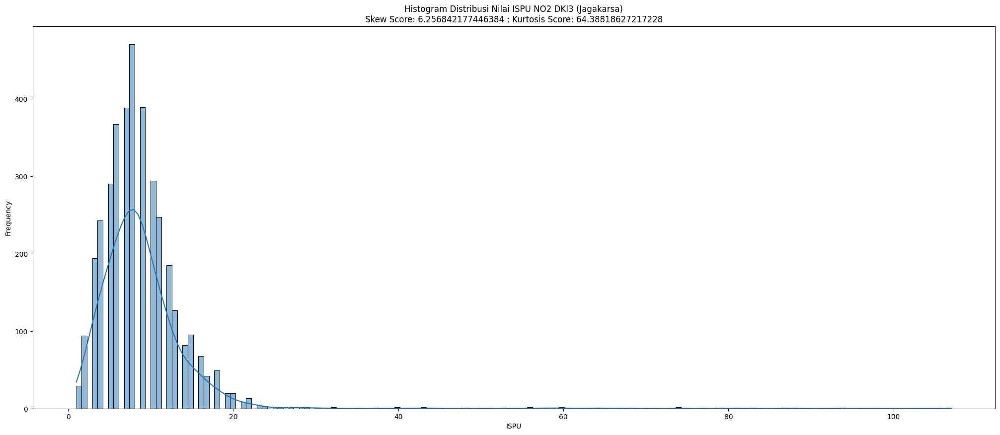

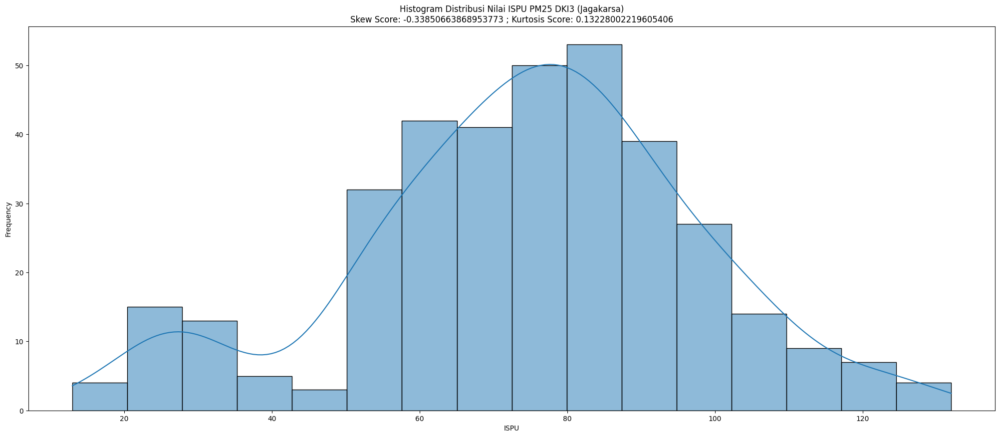

In [131]:
eda_skew(ispuDKI3)

Berdasarkan histogram berikut, seluruh histogram selain Histogram PM10 dan PM2.5 memiliki distribusi positif dimana _tail_ kanan lebih panjang dibandingkan _tail_ kiri dimanai skor skew rata-rata berada diluar range -0.5 sampai 0.5

## Analisis ISPU DKI 4 (Lubang Buaya)

### Analisis General

In [132]:
ispuDKI4[airPolutantComponents].describe()

,pm10,so2,co,o3,no2,pm25
count,3819.000000,3840.000000,3808.000000,3686.000000,3871.000000,323.000000
mean,63.211312,20.971875,17.844275,61.193163,11.614312,93.173375
std,20.896026,14.298432,12.408051,29.116788,7.895885,25.320939
min,7.000000,0.000000,0.000000,5.000000,1.000000,33.000000
25%,52.000000,7.000000,10.000000,39.000000,8.000000,77.000000
50%,62.000000,22.000000,15.000000,60.000000,10.000000,93.000000
75%,74.000000,31.000000,22.000000,79.000000,14.000000,108.000000
max,179.000000,72.000000,134.000000,236.000000,107.000000,174.000000


Berdasarkan tabel diatas
* Kandungan PM10 mendominasi dengan nilai ISPU rata-rata sebesar 63.13 dengan nilai maksimum 179
* Kandungan O3 menempati urutan kedua dengan nilai ISPU rata-rata 60.97 dengan nilai maksimum 236
* Kandungan SO2 menempati urutan ketiga dengan nilai ISPU rata-rata sebesar 20.76 dengan nilai maksimum 72
* Kandungan CO menempati urutan keempat dengan nilai ISPU rata-rata 17.61 dengan nilai maksmimum 134
* Kandungan NO2 menempati urutan terakhir dengan nilai ISPU rata-rata 12.30 dan nilai maksimum 107
* Kandungan PM25 memiliki nilai ISPU rata-rata sebesar 93.17 dengan nilai maksimum 174
* Secara angka, komponen PM25 menempati urutan tertinggi walaupun pengukurannya dimulai di tahun 2021 (Penjelasan lengkap akan dibahas di segmen Pengukuran PM2.5)

### Analisis Data dan Visualisasi Setiap Komponen Pencemar

Missing Value untuk stasiun DKI4 (Lubang Buaya)
pm10    155
so2     134
co      166
o3      288
no2     103
dtype: int64
Total: 846

Zero Value untuk stasiun DKI4 (Lubang Buaya)
pm10     0
so2     25
co      12
o3       0
no2      0
dtype: int64
Total: 846

Range tanggal pada data stasiun
2010-11-04 00:00:00 2021-12-31 00:00:00



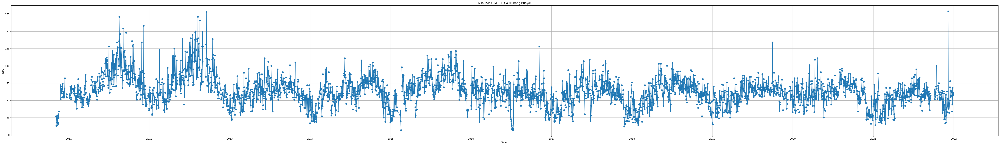

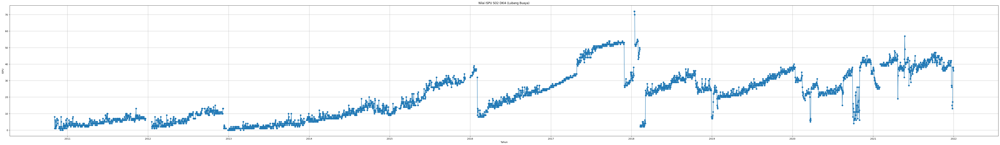

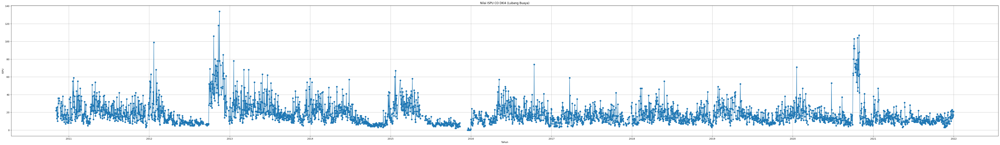

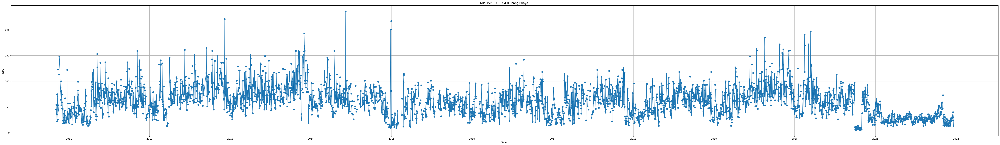

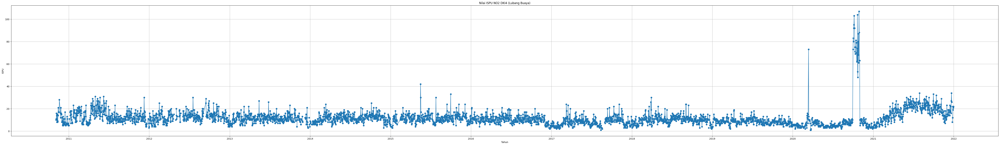

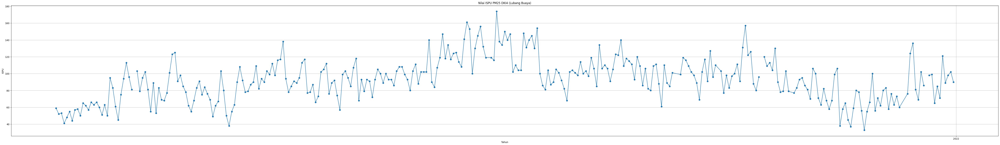

In [134]:
ispuDKI4 = eda_stasiun(ispuDKI4)

**Berdasarkan hasil analisis _Missing Value_, _Zero Value_ serta tanggal _Range_ berikut**
* Data dari DKI4 dicatat mulai dari tanggal 04 November 2010 hingga 31 Desember 2021
* Secara total, terdapat 846 Data NaN dimana O3, CO, dan PM10 merupakan komponen udara yang paling banyak data NaN
* Selain itu, seluruh nilai data > 0 kecuali SO2 dimana terdapat 25 data dan CO sebanyak 12 data yang bernilai 0

**Berdasarkan diagram PM10 berikut**
* Indeks PM10 mengalami tren penurunan setiap akhir tahun dan awal tahun. Tren tersebut terjadi hampir di setiap tahunnya
* Indeks PM10 mengalami tren peningkatan setiap menjelang dan pertengahan tahun
* Peningkatan yang besar terjadi di tahun 2011, 2012, 2019 dan 2020
* Peningkatan PM10 di tahun 2020 terjadi justru di awal tahun
* Indeks PM10 mengalami penurunan yang sangat drastis di tahun 2021

**Berdasarkan diagram O3 berikut**
* Secara umum, kadar O3 mengalami penurunan di akhir dan awal tahun
* Pada akhir tahun 2013 hingga awal tahun 2014 indeks O3 mengalami peningkatan
* Pada akhir tahun 2014, indeks sempat meningkat tajam hingga melewati 200 sebelum kembali turun dengan tajam dibawah 50
* Pada tahun 2019, indeks mengalami tren peningkatan yang cukup panjang sejak mendekati pertengahan tahun hingga akhir tahun.
* Pada awal tahun 2020, indeks meningkat dengan tajam sebelum mengalami penurunan yang cukup besar sejak pertengahan hingga akhir tahun
* Pada tahun 2021, indeks stagnan dan rata-rata berada dibawah 50, walaupun mendekati akhir tahun sempat meningkat hingga hampir melewati 75

**Berdasarkan diagram SO2 berikut**
* Terjadi tren peningkatan indeks SO2 sejak tahun 2013 hingga awal tahun 2016 sebelum terjadi penurunan
* Setelah penurunan, tren kembali meningkat hingga mendekati akhir tahun 2017 sebelum terjadi penurunan ke level dibawah 30
* Pada awal tahun 2018, indeks mengalami peningkatan sangat tajam hingga melewati level 70, kemudian mengalami penurunan secara tajam hingga dibawah level 10.
* Namun indeks SO2 mengalami peningkatan hingga mendekati akhir tahun 2018.
* Sejak tahun 2019, indeks SO2 mengalami peningkatan dan akan turun di akhir tahun atau awal tahun berikutnya. hal tersebut terjadi terus menerus hingga akhir tahun 2021

**Berdasarkan diagram NO2 berikut**
* Melihat dari data indeks NO2 di tahun 2010 hingga 2019 akhir, indeks NO2 berada di posisi stagnan dimana tidak terlalu banyak peningkatan indeks secara signifikan dan rata-rata kenaikan tertinggi berada di level 30
* Pada akhir tahun 2019, indeks NO2 mengalami penurunan dibandingkan tahun sebelumnya
* Namun, pada tahun 2020, terjadi 2 kali peningkatan indeks NO2 secara drastis, dimana pada bulan Maret terjadi peningkatan di level indeks 70, kemudian pada bulan Oktober, terjadi peningkatan yang sangat signifikan yaitu melewati level index 100 dan setelah memasuki bulan November, indeks menurun ke level mendekati seperti di bulan Januari
* Memasuki tahun 2021, indeks NO2 perlahan mengalami kenaikan dan di akhir tahun 2021 indeks perlahan menurun walaupun mendekati akhir tahun kembali meningkat

**Berdasarkan diagram CO berikut**
* Indeks CO mengalami peningkatan besar di awal dan menjelang akhir tahun 2012, pertengahan akhir tahun 2016, awal tahun 2020 dan akhir tahun 2020
* Penurunan indeks CO yang besar terjadi di pertengahan tahun 2012, menjelang akhir tahun 2014 dan pertengahan hingga akhir tahun 2016
* Pada tahun 2021, pergerakan indeks CO tidak terlalu fluaktif seperti di tahun-tahun sebelumnya dimana rata-rata indeks CO di tahun 2021 adalah 12.15

### Analisis Skew dan Kurtosis

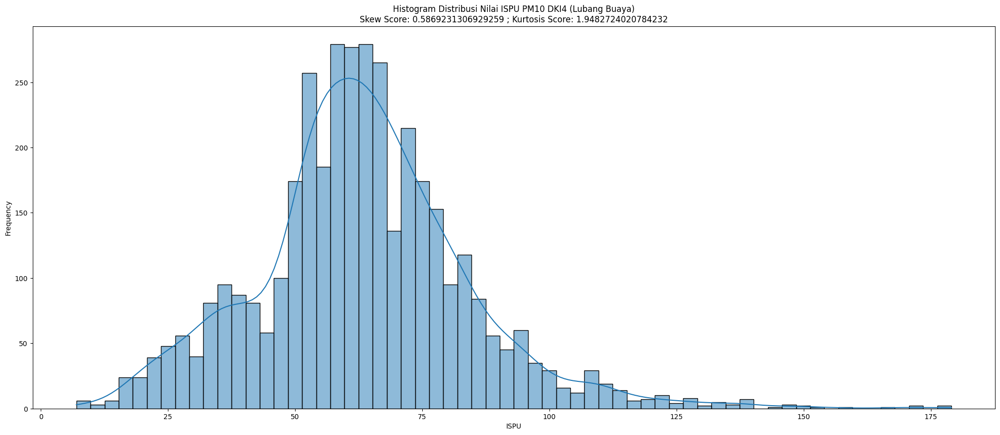

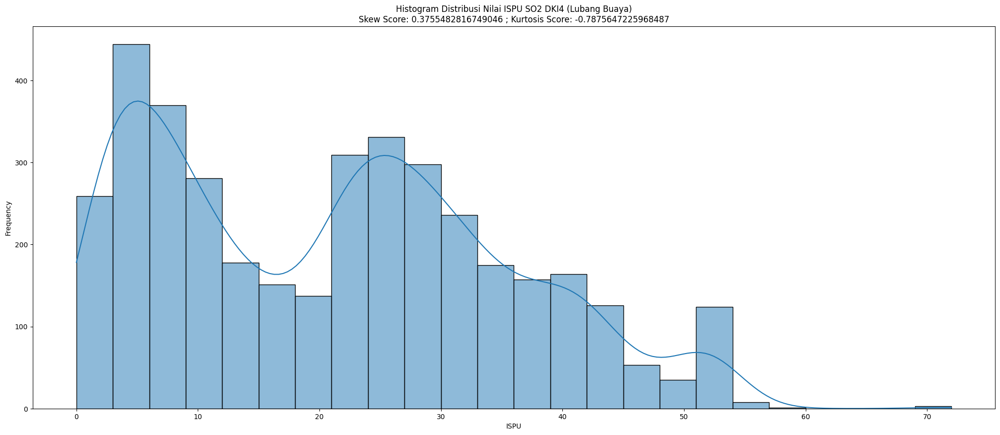

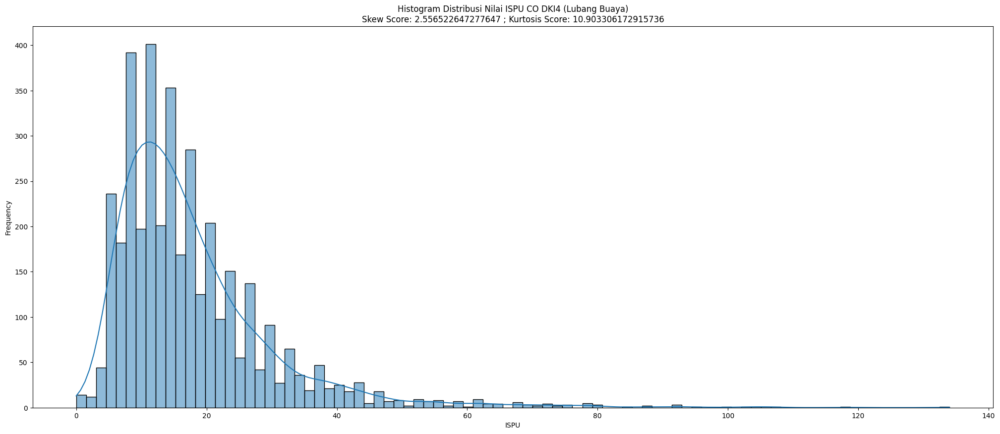

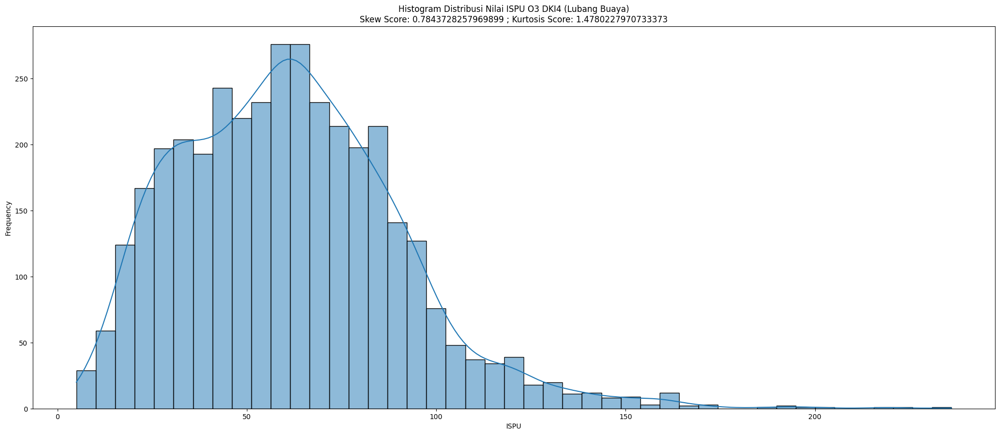

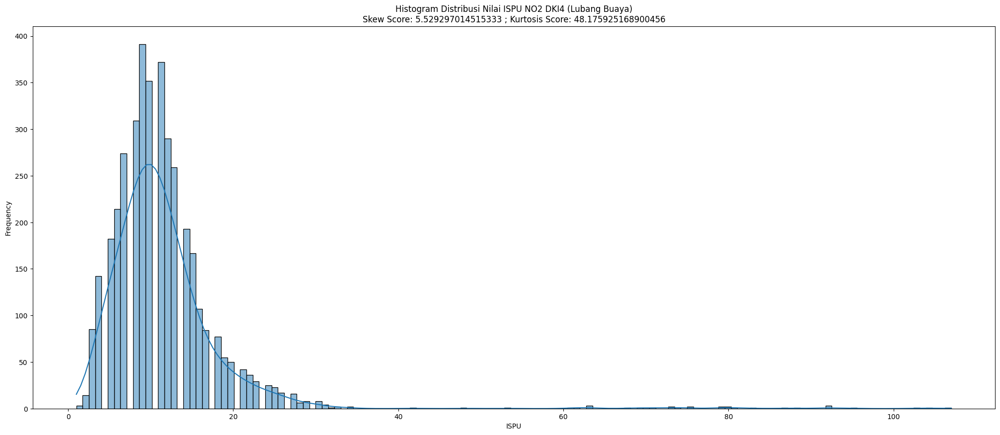

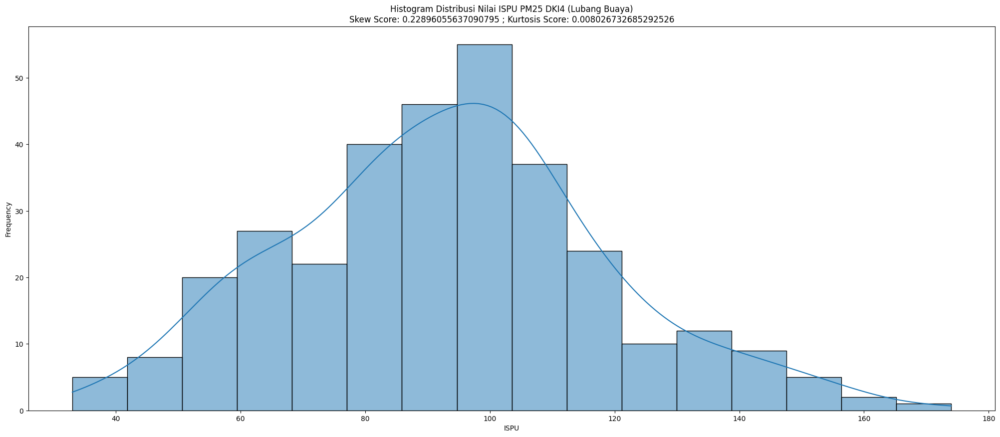

In [135]:
eda_skew(ispuDKI4)

Berdasarkan histogram berikut, seluruh histogram selain Histogram SO2 dan PM2.5 memiliki distribusi positif dimana _tail_ kanan lebih panjang dibandingkan _tail_ kiri dimanai skor skew rata-rata berada diluar range -0.5 sampai 0.5.

Meskipun begitu, pada Histogram SO2 ada 2 titik puncak dimana titik puncak tertinggi berada pada range 0-10.

## Analisis ISPU DKI 5 (Kebon Jeruk)

### Analisis General

In [136]:
ispuDKI5[airPolutantComponents].describe()

,pm10,so2,co,o3,no2,pm25
count,3112.000000,3116.000000,3184.000000,3139.000000,3187.000000,330.000000
mean,51.137211,14.411104,23.614636,70.407455,11.523690,78.821212
std,17.918818,8.573025,16.316884,41.635195,10.775355,21.105787
min,2.000000,0.000000,1.000000,3.000000,1.000000,26.000000
25%,41.000000,8.000000,12.000000,38.000000,7.000000,65.000000
50%,54.000000,13.000000,19.000000,65.000000,10.000000,78.500000
75%,62.000000,20.000000,32.000000,90.000000,13.000000,91.000000
max,114.000000,51.000000,135.000000,243.000000,135.000000,140.000000


Berdasarkan tabel diatas
* Kandungan O3 mendominasi dengan nilai ISPU rata-rata sebesar 67.44 dengan nilai maksimum 243
* Kandungan PM10 menempati urutan kedua dengan nilai ISPU rata-rata 48.56 dengan nilai maksimum 114
* Kandungan CO menempati urutan ketiga dengan nilai ISPU rata-rata sebesar 22.94 dengan nilai maksimum 243
* Kandungan SO2 menempati urutan keempat dengan nilai ISPU rata-rata 13.70 dengan nilai maksmimum 51
* Kandungan NO2 menempati urutan terakhir dengan nilai ISPU rata-rata 11.21 dan nilai maksimum 135
* Kandungan PM25 memiliki nilai ISPU rata-rata sebesar 78.82 dengan nilai maksimum 140
* Secara angka, komponen PM25 menempati urutan tertinggi walaupun pengukurannya dimulai di tahun 2021 (Penjelasan lengkap akan dibahas di segmen Pengukuran PM2.5)

### Analisis Data dan Visualisasi Setiap Komponen Pencemar

Missing Value untuk stasiun DKI5 (Kebon Jeruk)
pm10    165
so2     161
co       93
o3      138
no2      90
dtype: int64
Total: 647

Zero Value untuk stasiun DKI5 (Kebon Jeruk)
pm10    0
so2     4
co      0
o3      0
no2     0
dtype: int64
Total: 647

Range tanggal pada data stasiun
2012-11-27 00:00:00 2021-12-31 00:00:00



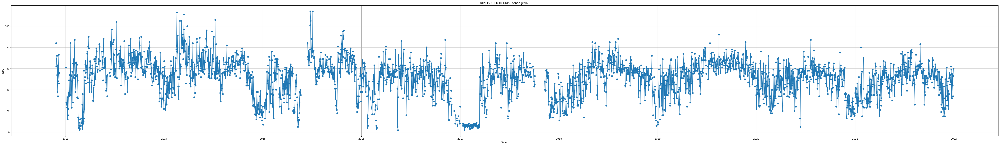

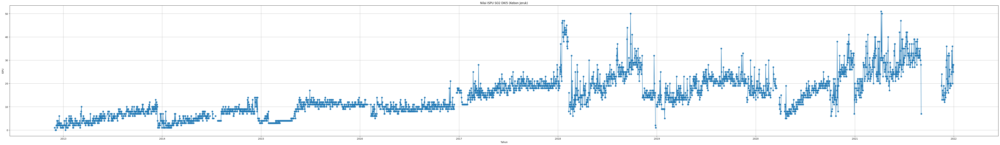

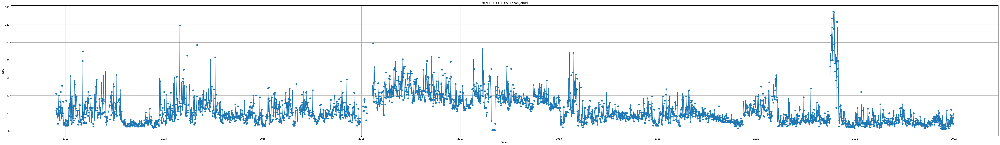

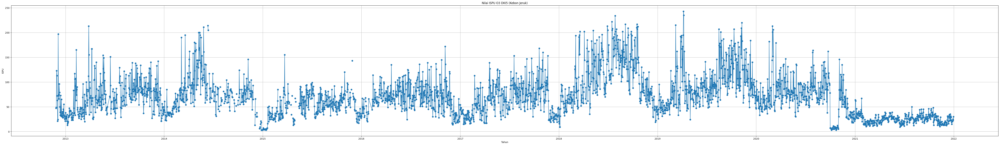

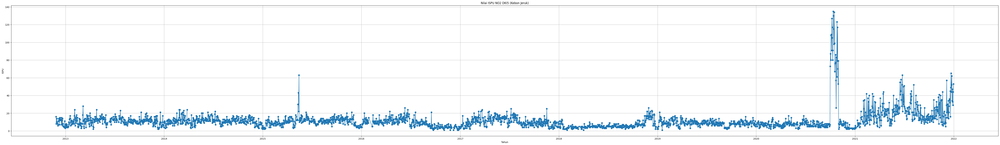

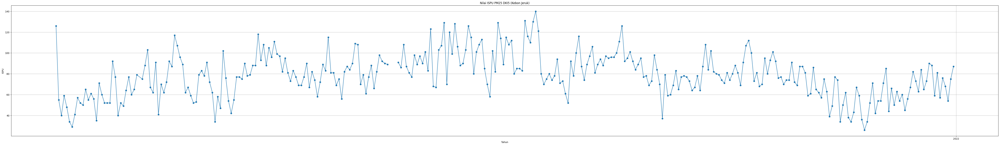

In [138]:
ispuDKI5 = eda_stasiun(ispuDKI5)

**Berdasarkan hasil analisis _Missing Value_, _Zero Value_ serta tanggal _Range_ berikut**
* Data dari DKI5 dicatat mulai dari tanggal 27 November 2012 hingga 31 Desember 2021
* Secara total, terdapat 647 Data NaN dimana PM10, SO2, dan O3 merupakan komponen udara yang paling banyak data NaN
* Selain itu, seluruh nilai data > 0 kecuali SO2 dimana terdapat 4 data yang bernilai 0

**Berdasarkan dari diagram PM10 berikut**
* Terjadinya pola _seasional_ dimana ada pola indeks PM10 mengalami kenaikan secara umum di pertengahan tahun dan akan menurun di akhir tahun.
* Meskipun begitu, berdasarkan data di tahun 2012 - 2016, sempat terjadi kenaikan indeks secara besar di sekitaran bulan Febuari dan Maret 2014 dan sekitaran Juni dan Juli 2015.
* Kenaikan tertinggi terjadi di pertengahan tahun 2018 dan sekitaran awal tahun 2019 dimana indeks di awal tahun 2019 sangat dekat dengan level 250
* Indeks PM10 di tahun 2021 berada di posisi paling rendah yaitu dibawah level 50.
* Penurunan indeks PM10 paling dalam terjadi mendekati akhir tahun 2014 hingga awal tahun 2015 dimana indeks turun dari 70-an menjadi dibawah level 20 di awal tahun 2015

**Berdasarkan dari diagram O3 berikut**
* Pola pada data tahun 2013-2015 cukup berfluaktif
* Sejak dari tahun 2015 hingga 2017, peningkatan O3 terjadi menjelang akhir tahun, walaupun di tahun 2015 terjadi peningkatan O3 di sekitar bulan Maret dan April kemudian perlahan menurun
* Berdasarkan data tahun 2018, terjadi peningkatan indeks O3 di pertengahan tahun
* Berdasarkan data tahun 2019, peningkatan terjadi 2 kali, yaitu di awal tahun dan akhir tahun
* Berdasarkan data tahun 2020
  * Peningkatan tertinggi terjadi di akhir bulan Febuari dan berpuncak di tanggal 1 Maret dan mulai menurun sejak pertengahan Maret hingga April
  * Sejak akhir September hingga akhir Oktober, terjadi penurunan yang sangat tajam dimana sebelumnya Indeks berada diatas level 100 kemudian menurun di bawah level 50 dan mendekati level 0 ISPU
  * Peningkatan kembali terjadi di 1 November dan bergerak melewati level 50 ISPU di beberapa hari kedepannya
  * Pergerakan mulai menurun di pertengahan November hingga akhir tahun, namun nilai Indeks tidak serendah seperti di akhir September hingga akhir Oktober

**Berdasarkan dari diagram SO2 berikut**
* Pada tahun 2013 hingga 2014, terjadi sebuah pola dimana sepanjang tahun akan terjadi peningkatan kadar SO2 dan akan menurun secara dalam di bulan November-Desember
* Pola tersebut berubah ketika tahun 2015 dimana indeks SO2 mengalami peningkatan yang pesat sejak April hingga Juni 2015 hingga seterusnya nilai indeks terlihat stagnan hingga akhir tahun
* Pola yang terjadi di tahun 2013 dan 2014 kembali terjadi di tahun 2018 hingga 2020
* Peningkatan indeks SO2 secara tajam terjadi 3 kali, yaitu awal tahun 2018, pertengahan akhir tahun 2018, dan awal pertengahan tahun 2021
* Jika melihat data di antara bulan Mei dan September 2015, terdapat beberapa hari dimana tidak tercatat indeks SO2. Kejadian serupa terjadi di awal pertengahan tahun 2020, sebelum akhirnya nilai indeks sempat naik dan turun, kemudian naik secara perlahan

**Berdasarkan dari diagram NO2 berikut**
* Pergerakan indeks NO2 sejak akhir tahun 2012 hingga 2020, indeks NO2 rata-rata berada di antara 0 hingga 20 ISPU
* Peningkatan indeks yang tajam terjadi di akhir September hingga akhir Oktober 2020 dimana puncak kenaikan berada di pertengahan bulan Oktober
* Berdasarkan data tahun 2021, pergerakan indeks NO2 mengalami fluktuatif dimana peningkatan terbesar terjadi di akhir bulan Juni dan akhir Desember

**Berdasarkan dari diagram CO berikut**
* Sejak akhir 2012 hingga Juli 2013, indeks CO mengalami fluktuatif kemudian bergerak menurun secara besar di bulan Agustus hingga Desember 2013, kemudian meningkat secara tajam di pertengahan Desember hingga turun mendekati awal tahun 2014
* Dari bulan Juli 2014 hingga awal tahun 2016, indeks rata-rata berada di bawah 40 ISPU, kemudian di bulan berikutnya terjadi peningkatan hingga mengalami tren penurunan di pertengahan tahun 2017 hingga awal tahun 2018
* Setelah itu terjadi peningkatan selama beberapa pulan kemudian menurun dan mulai stagnan hingga mulai pertengahan 2019
* Sejak pertengahan 2019 indeks menurun hingga mendekati akhir 2019 dan mulai meningkat hingga awal tahun 2020
* Di tahun 2020, terdapat peningkatan secara tinggi di bulan Oktober dimana indeks melewati zona 120 ISPU

###Analisis Skew dan Kurtosis

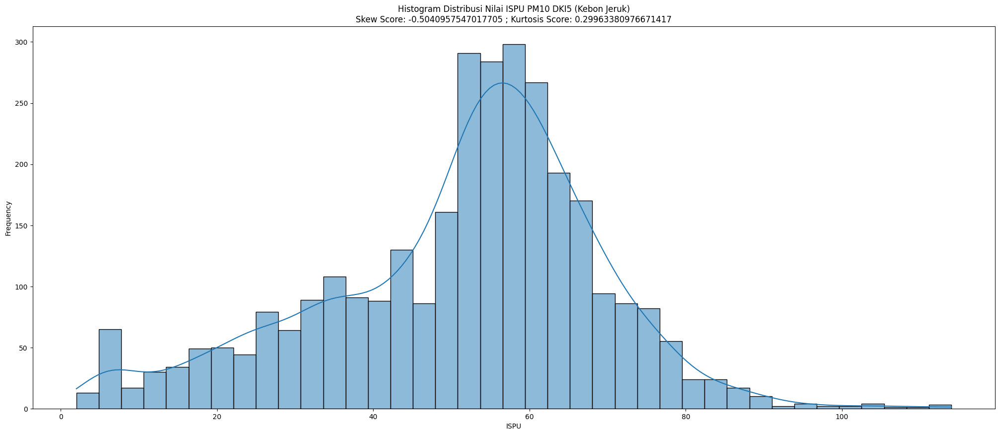

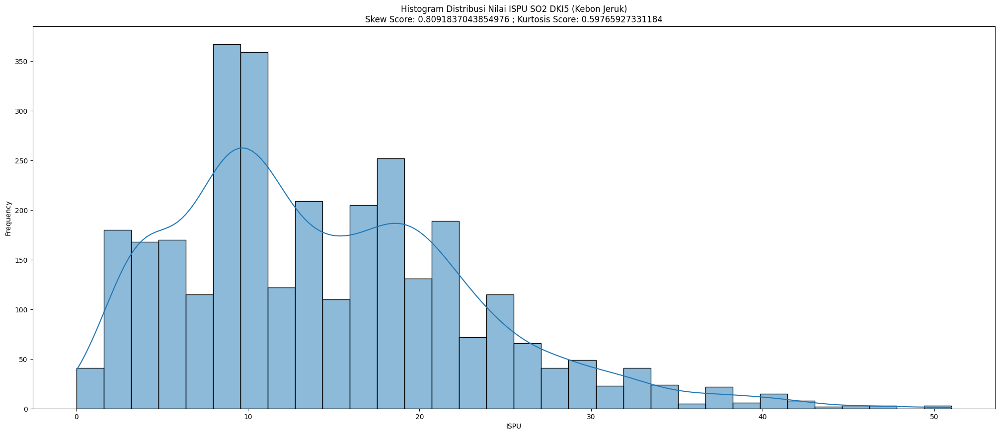

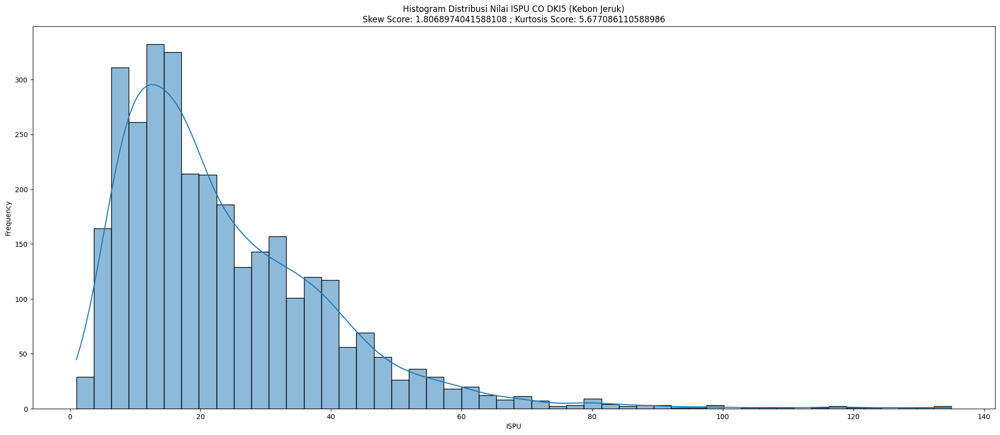

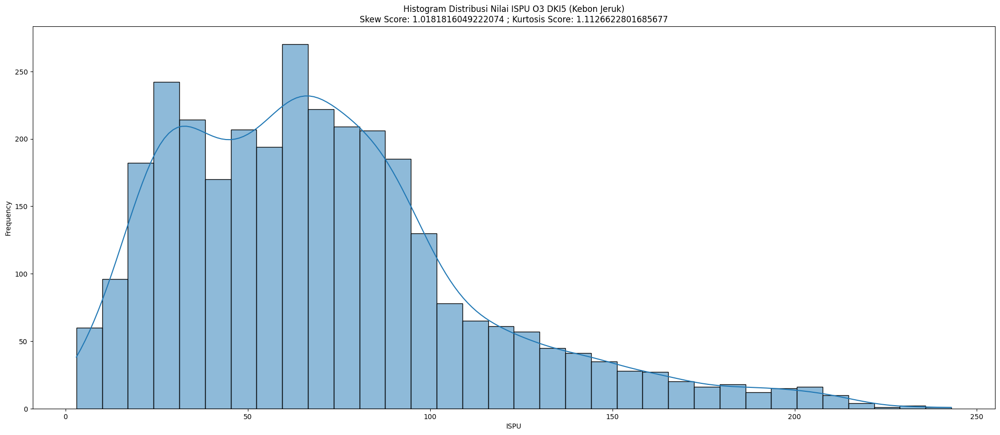

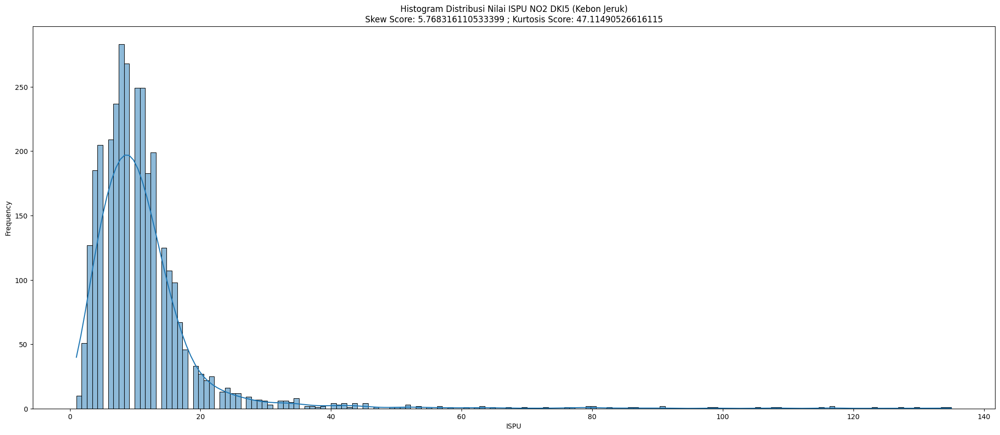

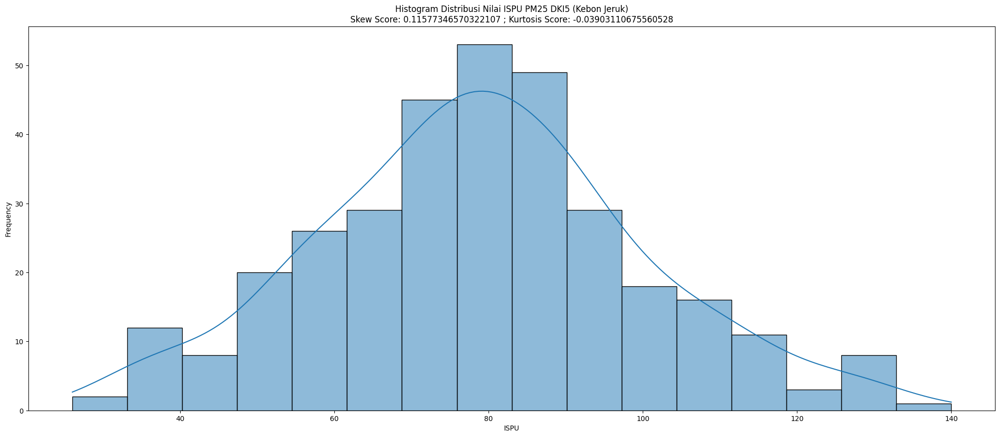

In [139]:
eda_skew(ispuDKI5)

Berdasarkan histogram berikut, seluruh histogram selain Histogram PM10 dan PM2.5 memiliki distribusi positif dimana _tail_ kanan lebih panjang dibandingkan _tail_ kiri dimanai skor skew rata-rata berada diluar range -0.5 sampai 0.5

## Analisis Komponen PM2.5

<Axes: title={'center': 'Nilai ISPU PM2.5 DKI5 Tahun 2021'}, xlabel='Tahun', ylabel='ISPU'>

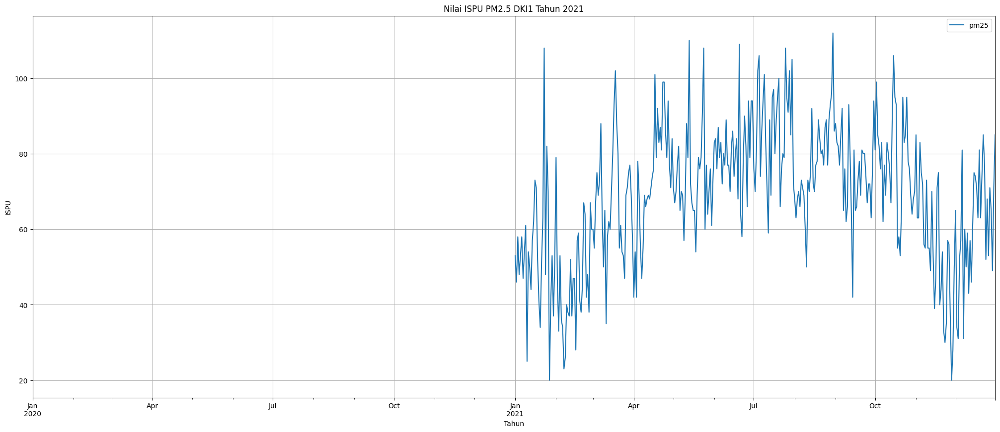

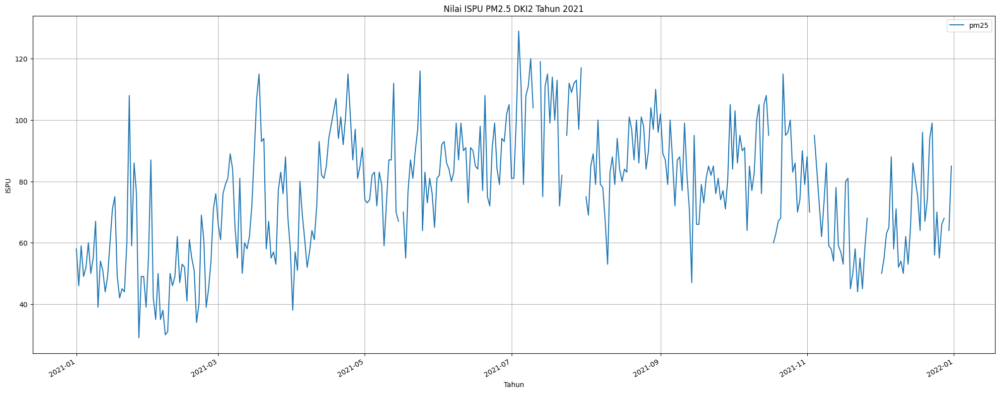

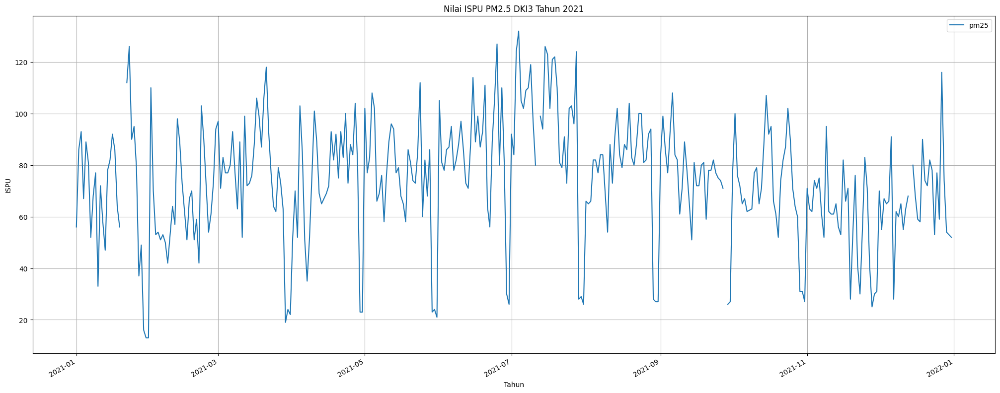

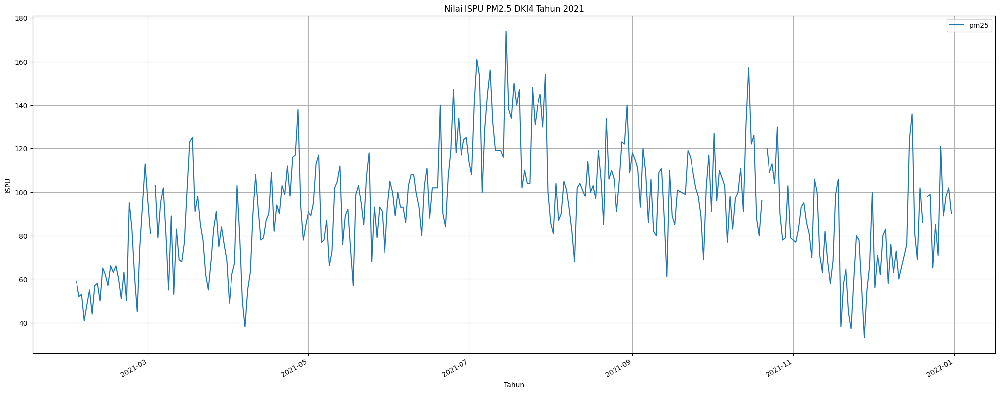

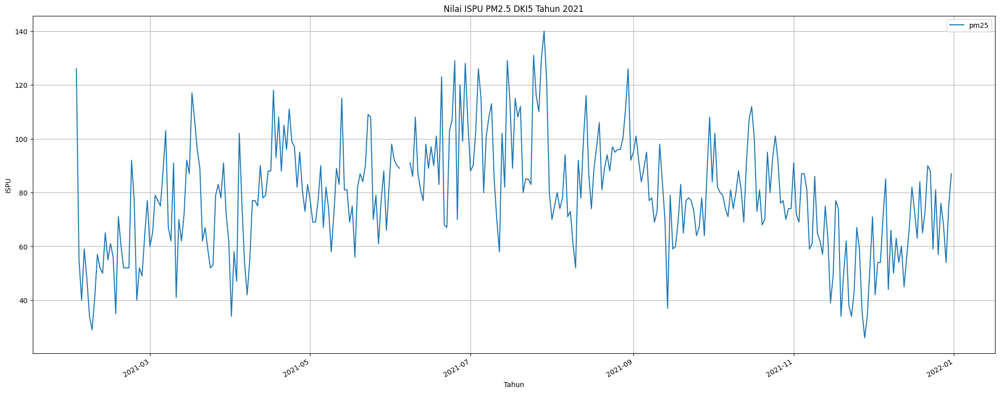

In [140]:
ispuDKI1.loc[ispuDKI1.index.year >= 2020, ['pm25']].plot(figsize=(25,10), grid=True, title = "Nilai ISPU PM2.5 DKI1 Tahun 2021", xlabel="Tahun", ylabel="ISPU")
ispuDKI2.loc[ispuDKI2.index.year >= 2020, ['pm25']].plot(figsize=(25,10), grid=True, title = "Nilai ISPU PM2.5 DKI2 Tahun 2021", xlabel="Tahun", ylabel="ISPU")
ispuDKI3.loc[ispuDKI3.index.year >= 2020, ['pm25']].plot(figsize=(25,10), grid=True, title = "Nilai ISPU PM2.5 DKI3 Tahun 2021", xlabel="Tahun", ylabel="ISPU")
ispuDKI4.loc[ispuDKI4.index.year >= 2020, ['pm25']].plot(figsize=(25,10), grid=True, title = "Nilai ISPU PM2.5 DKI4 Tahun 2021", xlabel="Tahun", ylabel="ISPU")
ispuDKI5.loc[ispuDKI5.index.year >= 2020, ['pm25']].plot(figsize=(25,10), grid=True, title = "Nilai ISPU PM2.5 DKI5 Tahun 2021", xlabel="Tahun", ylabel="ISPU")

Berdasarkan diagram berikut
* Seluruh stasiun memiliki pola pergerakan yang sama dimana indeks akan bergerak naik hingga mencapai puncaknya di bulan Juli awal.
* Setelah itu indeks akan bergerak turun hingga puncaknya di awal Desember
* Setelah itu indeks akan bergerak naik hingga akhir tahun
* Jika kembali melihat hasil rata-rata dan nilai maksimum PM<sub>2.5</sub> di setiap stasiun, bisa dilihat meskipun data PM<sub>2.5</sub> tidak sebanyak data komponen pencemar lainnya, tapi nilai rata-ratanya paling tinggi dibandingkan dengan komponen pencemar lainnya

Salah satu hal yang menjadi catatan adalah pengukuran PM<sub>2.5</sub> baru mulai tersedia **sejak tahun 2021**. Hal ini disebabkan dikarenakan aturan mengenai pengukuran PM<sub>2.5</sub> baru dikeluarkan di bulan Juli 2020 melalui **Peraturan Menteri Lingkungan Hidup dan Kehutanan Nomor P.14/MENLHK/SETJEN/KUM.1/7/2020**. Sebelumnya aturan mengenai Index Standar Pencemaran Udara merujuk kepada **Keputusan Menteri Negara Lingkungan Hidup Nomor KEP-45/MENLH/10/1997** dimana belum ada aturan pengukuran PM<sub>2.5</sub>.

Ditambah berdasarkan Pasal 11 peraturan menteri terbaru tertulis bahwa penyesuaian penentuan ISPU sesuai dengan ketentuan Peraturan Menteri tersebut paling lambat 2 (dua) tahun sejak berlaku, sehingga sangat wajar jika pengukuran PM<sub>2.5</sub> dilakukan di tahun 2021.


## Exploratory Data Analysis (Missing Value)

Dalam artikel di **_Towards Data Science_** yang berjudul [**4 Techniques to Handle Missing values in Time Series Data**](https://towardsdatascience.com/4-techniques-to-handle-missing-values-in-time-series-data-c3568589b5a8") terdapat 4 teknik yang dapat digunakan untuk mengatasi _Missing Value_ pada data Time Series, yaitu

1. _Last Observation Carried Forward (LOCF)_
2. _Next Observation Carried Backward (NOCB)_
3. _Rolling Statistics_
4. _Interpolation_

Dimana teknik _LOCF_ bekerja dengan mengganti nilai yang hilang dengan nilai sebelumnya, sebaliknya _NOCB_ bekerja dengan menggantikannya dengan nilai berikutnya.

Teknik ini sangat simpel, namun memiliki kelemahan dimana akan kehilangan gambaran pergerakan tren, terutama jika nilai yang hilang cukup banyak.

Selain itu, kelemahan _NOCB_ adalah jika setelah nilai yang hilang tersebut adalah NaN juga, maka nilai yang hilang tersebut akan digantikan dengan NaN.

Selain kedua teknik tersebut, terdapat teknik _Rolling Statistics_ yang bekerja dengan menggantikan nilai yang hilang dengan aggregat nilai sebelumnya sebesar _n_ dimana _n_ ini merupakan jarak atau banyak data yang ingin di aggregatkan.

Ada 3 metode untuk menggunakan metode ini, yaitu

a. _Simple Moving Average_

![Simple Moving Average Formula](https://miro.medium.com/v2/resize:fit:640/format:webp/1*GqcyY6_vA-cvcj90Tg6KdA.png)

_Simple Moving Average (SMA)_ merupakan salah satu metode yang paling simpel dimana nilai data sebelumnya yang sebanyak _n_ akan di jumlahkan dan akan di bagikan dengan _n_. Sederhananya, metode ini bekerja dengan mengganti data yang hilang dengan nilai rata-rata data sebelumnya sebesar _n_-data.

b. _Weighted Moving Average_

![Weighted Moving Average Formula](https://miro.medium.com/v2/resize:fit:720/format:webp/1*6PlxApRuwnKzomxEaN1zjw.png)

_Weighted Moving Average (WMA)_ adalah metode lainnya dimana nilai yang akan di jumlahkan akan diberikan sebuah _weigth_ atau bobot dimana bobot ini di distribusikan secara merata sehingga jumlah keseluruhan bobotnya adalah 1 (100%). Contohnya, jika rata-rata yang ingin diambil adalah rata-rata 5 hari sebelumnya, maka bobotnya adalah: **5/15; 4/15; 3/15; 2/15; 1/15** dimana jika dijumlahkan akan menghasilkan 1.

c. _Exponential Moving Average_

![_Exponential Moving Average Formula](https://miro.medium.com/v2/resize:fit:720/format:webp/1*1tmY0vW2LmgAY4ASIWD-5A.png)

_Exponential Moving Average (EMA)_ adalah metode memiliki kerja yang mirip dengan _WMA_, namun jika di _WMA_ penurunan bobotnya konsisten, penurunan pada _EMA_ bersifat eksponensial dimana nilai _alpha_ merupakan nilai _smoothing factor_ mirip seperti penentuan bobot pada _WMA_.

Teknik _Rolling Statistics_ selain dipakai untuk menggantikan data yang hilang, juga digunakan oleh pelaku _trader_ untuk memprediksi harga aset mereka di pasar.

Selain teknik _Rolling Statistics_ ada juga satu teknik lainnya yaitu _Interpolation_. Teknik ini bekerja dengan dengan menggantikan nilai yang hilang dengan mengasumsikan hubungan dalam rentang titik data. Perbedaan dengan teknik sebelumnya adalah pada teknik _Rolling Statistics_ data yang digunakan hanyalah data masa lalu, sedangkan pada teknik interpolasi, data yang digunakan adalah data masa lalu dan masa depan yang sudah diketahui.

Ada 3 variasi dalam teknik interpolasi, yaitu

a. _linear_

Teknik ini bekerja dengan melakukan asumsi hubungan secara linear lurus antar rentang titik data

![Linear Function Graph](https://upload.wikimedia.org/wikipedia/commons/thumb/d/dd/LinearInterpolation.svg/256px-LinearInterpolation.svg.png)

b. _spline_

Teknik ini bekerja dengan memperkirakan nilai yang meminimalisir kelengkungan sehingga memperoleh lengkungan fungsi yang lebih halus.

![Spline Function Graph](https://upload.wikimedia.org/wikipedia/commons/thumb/5/55/Parametic_Cubic_Spline.svg/350px-Parametic_Cubic_Spline.svg.png)

c. _time_

Teknik ini bekerja dengan memperkirakan nilai yang berfokus pada titik terdekatnya.<br><br>



Pada proyek ini, akan dilakukan penerapan _Spline Interpolation_ dan _time Interpolation_ untuk mengetahui metode mana yang lebih efektif dan dapat meningkatkan akurasi prediksi

In [141]:
def fill_interpolation(df, component, option, order=0):
  df_new = df[['stasiun', component]].copy()
  if (option == 'spline'):
    return df_new.interpolate(method=option, order=order, limit_direction ='backward')
  return df_new.interpolate(method=option)

### Spline Interpolation

In [142]:
dki1NO2SI = fill_interpolation(ispuDKI1, 'no2', 'spline', 2)
dki2NO2SI = fill_interpolation(ispuDKI2, 'no2', 'spline', 2)
dki3NO2SI = fill_interpolation(ispuDKI3, 'no2', 'spline', 2)
dki4NO2SI = fill_interpolation(ispuDKI4, 'no2', 'spline', 2)
dki5NO2SI = fill_interpolation(ispuDKI5, 'no2', 'spline', 2)

### Time Interpolation

In [143]:
dki1NO2TI = fill_interpolation(ispuDKI1, 'no2', 'time')
dki2NO2TI = fill_interpolation(ispuDKI2, 'no2', 'time')
dki3NO2TI = fill_interpolation(ispuDKI3, 'no2', 'time')
dki4NO2TI = fill_interpolation(ispuDKI4, 'no2', 'time')
dki5NO2TI = fill_interpolation(ispuDKI5, 'no2', 'time')

### Perbandingan (Stasiun DKI 1)

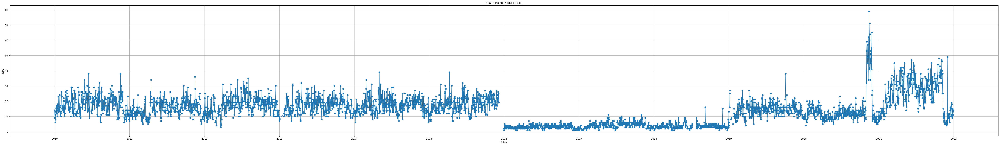

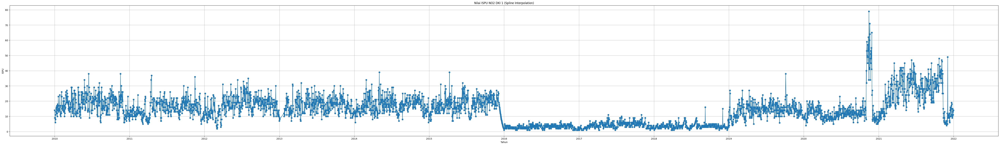

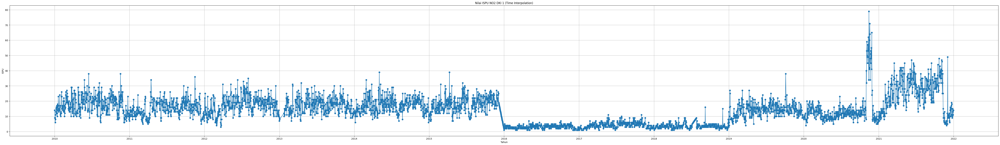

In [144]:
eda_line_visualization(ispuDKI1, 'no2', 'Nilai ISPU NO2 DKI 1 (Asli)')
eda_line_visualization(dki1NO2SI, 'no2', 'Nilai ISPU NO2 DKI 1 (Spline Interpolation)')
eda_line_visualization(dki1NO2TI, 'no2', 'Nilai ISPU NO2 DKI 1 (Time Interpolation)')

### Perbandingan (Stasiun DKI 2)

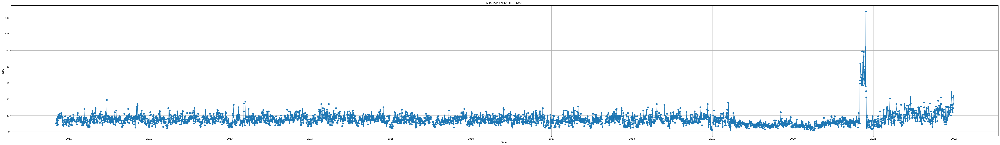

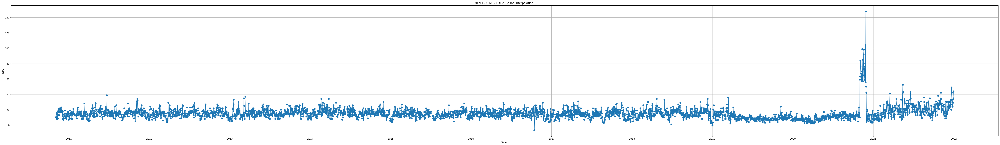

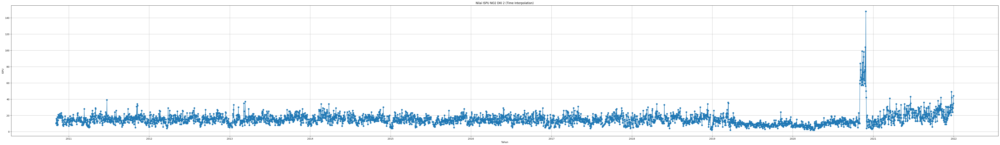

In [145]:
eda_line_visualization(ispuDKI2, 'no2', 'Nilai ISPU NO2 DKI 2 (Asli)')
eda_line_visualization(dki2NO2SI, 'no2', 'Nilai ISPU NO2 DKI 2 (Spline Interpolation)')
eda_line_visualization(dki2NO2TI, 'no2', 'Nilai ISPU NO2 DKI 2 (Time Interpolation)')

### Perbandingan (Stasiun DKI 3)

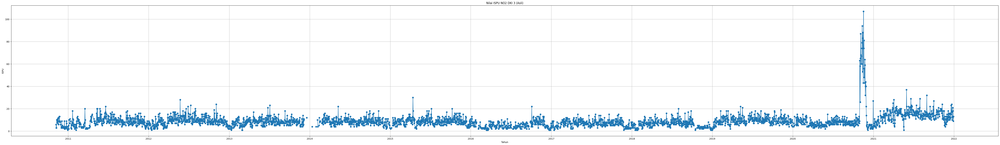

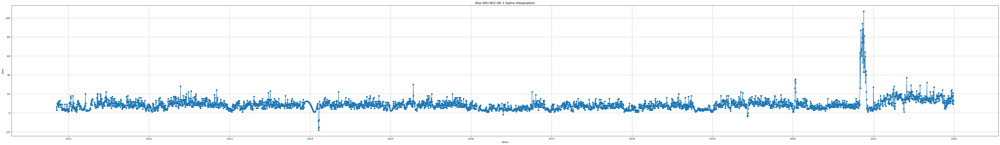

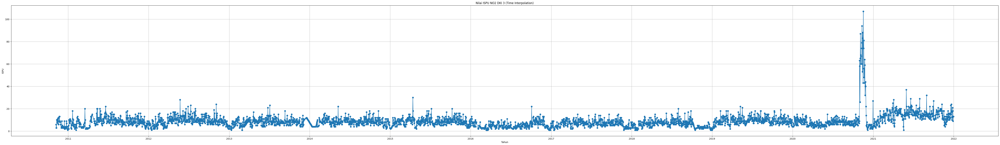

In [146]:
eda_line_visualization(ispuDKI3, 'no2', 'Nilai ISPU NO2 DKI 3 (Asli)')
eda_line_visualization(dki3NO2SI, 'no2', 'Nilai ISPU NO2 DKI 3 (Spline Interpolation)')
eda_line_visualization(dki3NO2TI, 'no2', 'Nilai ISPU NO2 DKI 3 (Time Interpolation)')

### Perbandingan (Stasiun DKI 4)

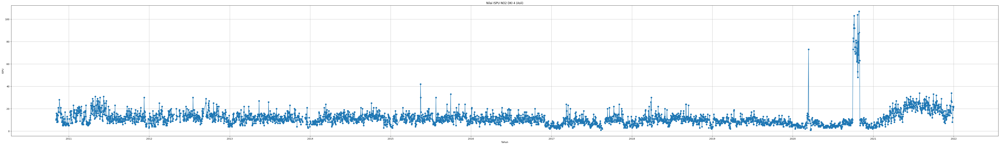

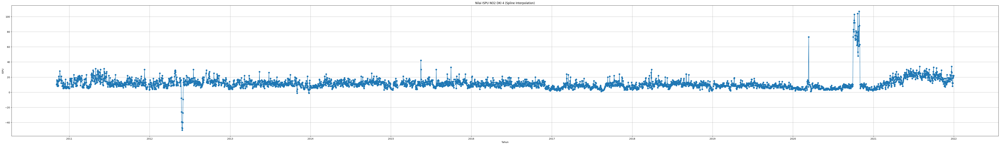

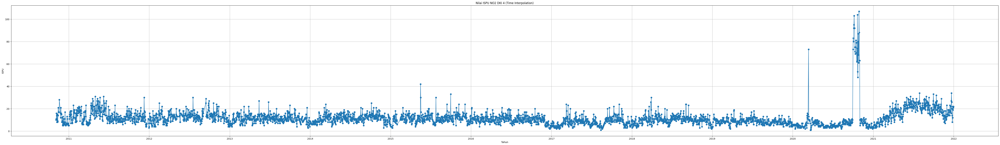

In [147]:
eda_line_visualization(ispuDKI4, 'no2', 'Nilai ISPU NO2 DKI 4 (Asli)')
eda_line_visualization(dki4NO2SI, 'no2', 'Nilai ISPU NO2 DKI 4 (Spline Interpolation)')
eda_line_visualization(dki4NO2TI, 'no2', 'Nilai ISPU NO2 DKI 4 (Time Interpolation)')

### Perbandingan (Stasiun DKI 5)

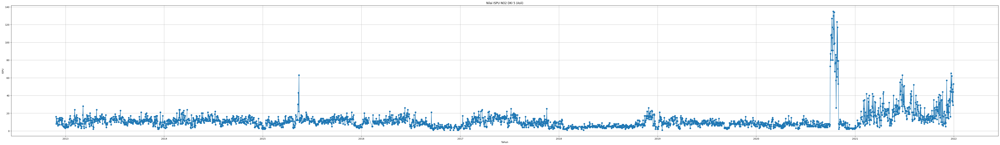

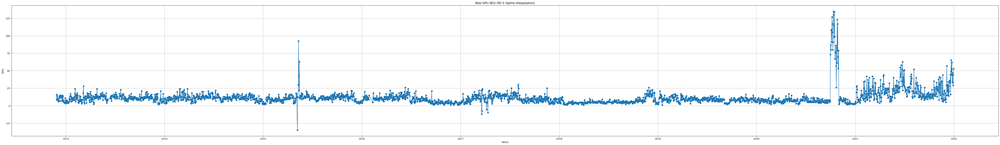

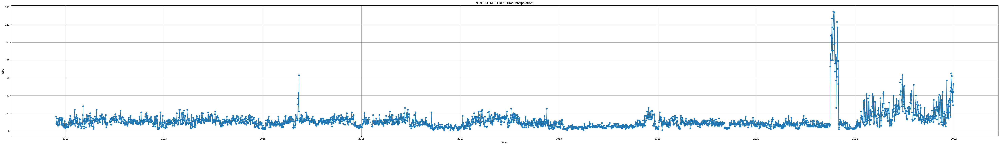

In [148]:
eda_line_visualization(ispuDKI5, 'no2', 'Nilai ISPU NO2 DKI 5 (Asli)')
eda_line_visualization(dki5NO2SI, 'no2', 'Nilai ISPU NO2 DKI 5 (Spline Interpolation)')
eda_line_visualization(dki5NO2TI, 'no2', 'Nilai ISPU NO2 DKI 5 (Time Interpolation)')

### Kesimpulan

Setelah dilakukan perbandingan dan pengecekan, disimpulkan bahwa hasil _time interpolation_ memiliki hasil yang lebih baik dibandingkan _spline interpolation_ dimana hasil interpolasi dari _time interpolation_ tidak melewati batas bawah dari nilai ISPU, yaitu 0 dan pergerakannya tidak setajam dari _spline interpolation_. Sehingga hasil dari _time interpolation_ akan dipakai ke tahap berikutnya

# Exploratory Data Analysis (Analisis dan Normalisasi Skewness dan Kurtosis)

Dalam dunia nyata, data yang akan diterima umumnya tidak memiliki distribusi normal. Hal ini karena sampel tersebut memang tidak berasal dari populasi yang berdistribusi normal. Oleh karena itu, perlu dilakukan pengujian normalitas untuk memastikan apakah data yang sudah dikumpulkan telah memenuhi normalitas data.

Data dikatakan memiliki distribusi normal jika memenuhi ciri-ciri berikut:

1. Bentuk simetris: Distribusi normal memiliki bentuk yang simetris di sekitar nilai tengahnya. Artinya, nilai rata-rata, median, dan modus berada pada posisi yang sama di tengah distribusi.

2. Tidak ada skewness (kemencengan): Distribusi normal tidak memiliki kemencengan yang signifikan. Kemencengan mengindikasikan adanya kecondongan ekor distribusi ke satu sisi. Dalam distribusi normal, ekor distribusi di kedua sisi memiliki kecondongan yang sama.

3. Tidak ada kurtosis ekstrem: Distribusi normal memiliki kurtosis yang moderat. Kurtosis mengukur tingkat keekstreman ekor distribusi. Dalam distribusi normal, kurtosis tidak terlalu tinggi atau rendah, menunjukkan ekor yang tidak terlalu berat atau ringan.

4. Persentil sesuai dengan nilai z: Persentil data dalam distribusi normal sesuai dengan nilai z dalam standar deviasi. Misalnya, 68% data berada dalam satu standar deviasi dari rata-rata, 95% data berada dalam dua standar deviasi, dan 99.7% data berada dalam tiga standar deviasi.

5. Diagram Q-Q: Plot kuantil-kuantil (Q-Q plot) data terhadap kuantil-kuantil dari distribusi normal menghasilkan garis lurus. Ini menunjukkan kesesuaian data dengan distribusi normal.

Dalam proyek ini, akan dilakukan pengujian normalitas data menggunakan pendekatan skewness dan kurtosis.

Skewness dan kurtosis adalah ukuran statistik yang digunakan untuk menggambarkan bentuk distribusi data. Skewness mengukur asimetri dari distribusi data, sedangkan kurtosis mengukur keekstreman (atau bentuk ekor) dari distribusi data.

Skewness mengindikasikan sejauh mana distribusi data condong ke satu sisi. Nilai skewness positif menunjukkan bahwa ekor distribusi data condong ke kanan, sedangkan nilai skewness negatif menunjukkan bahwa ekor distribusi data condong ke kiri. Nilai skewness nol menunjukkan bahwa distribusi data simetris.

Rumus skewness yang umum digunakan adalah:

![skewness formula](https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcQgI0VXs9SvS2SMXUXbfVR0Bj_43i4OL9n39pHaHTeB2hhjEkh2jMqTbbHXzICt7eeVHic&usqp=CAU)

Dimana dalam rumus ini:
*   X mewakili setiap titik data dalma sampel
*   X̄ mewakili rata-rata sampel
*   n mewakili jumlah data dalam sampel
*   S mewakili simpangan baku (standar deviasi) sampel


Sedangkan Kkrtosis mengukur keekstreman (atau bentuk ekor) dari distribusi data. Nilai kurtosis tinggi menunjukkan bahwa distribusi data memiliki ekor yang lebih berat dan puncak yang lebih tajam, sedangkan nilai kurtosis rendah menunjukkan distribusi data dengan ekor yang lebih ringan dan puncak yang lebih datar.

Rumus kurtosis yang umum digunakan adalah:

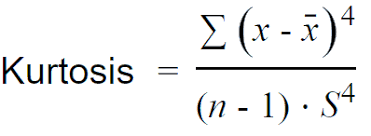

Dimana dalam rumus ini memiliki arti yang sama dengan rumus skewness.

Sebuah distribusi data dinyatakan normal jika memenuhi aspek berikut:
1. Jika skewness berkisar antara -0,5 hingga 0,5, data dapat dianggap mendekati distribusi normal.
2. Jika kurtosis berkisar antara -2 hingga 2 (atau antara 2 hingga 3 jika menggunakan definisi kurtosis ekscess), data dapat dianggap mendekati distribusi normal.

![skewness categorical](https://upload.wikimedia.org/wikipedia/commons/thumb/c/cc/Relationship_between_mean_and_median_under_different_skewness.png/600px-Relationship_between_mean_and_median_under_different_skewness.png)

Jika suatu distribusi data tidak memenuhi kriteria berikut, dapat dilakukan langkah normalisasi. Ada 2 teknik yang umum digunakan dalam melakukan normalisasi skewness dan kurtosis:
1. Logaritmik
  * Normalisasi menggunakan logaritma dapat digunakan untuk mengubah distribusi data yang umumnya condong ke kanan menjadi lebih simetris. Pendekatan ini berguna ketika terdapat perbedaan variabilitas yang besar di antara nilai-nilai data.
  * Rumus normalisasi logaritmik:
X
′
 =log(X)

2. Box-Cox

  * Metode normalisasi Box-Cox adalah transformasi yang memperhitungkan skewness dan kurtosis data asli. Transformasi ini menggunakan parameter lambda (λ) yang ditentukan secara otomatis untuk menghasilkan distribusi yang lebih simetris.
  * Rumus normalisasi Box-Cox:

  ![box-cox formula](https://www.leansigmacorporation.com/wp/wp-content/uploads/2016/01/Box-Cox-EQ1.png)

  * Dimana dalam rumus ini
    * X adalah data asli.
    * λ adalah parameter Box-Cox yang ditentukan secara otomatis untuk mencapai distribusi yang lebih simetris.
  * Selain itu x akan di logaritmik jika lambda adalah 0

### Create Skew Normalize Function

In [149]:
def skew_normalize(df, component, method):
  try:
    df_new = df.copy()
    if (method == 'log'):
      df_new[component] = np.log(df_new[component])
    elif (method == 'boxcox'):
      df_new[component], filter_lambda = stats.boxcox(df_new[component])
    return df_new
  except:
    traceback.print_exc()

### Logarithm Normalization

In [150]:
dki1NO2TI_logNorm = skew_normalize(dki1NO2TI, 'no2', 'log')
dki2NO2TI_logNorm = skew_normalize(dki2NO2TI, 'no2', 'log')
dki3NO2TI_logNorm = skew_normalize(dki3NO2TI, 'no2', 'log')
dki4NO2TI_logNorm = skew_normalize(dki4NO2TI, 'no2', 'log')
dki5NO2TI_logNorm = skew_normalize(dki5NO2TI, 'no2', 'log')

### Box-Cox Normalization

In [151]:
dki1NO2TI_boxCoxNorm = skew_normalize(dki1NO2TI, 'no2', 'boxcox')
dki2NO2TI_boxCoxNorm = skew_normalize(dki2NO2TI, 'no2', 'boxcox')
dki3NO2TI_boxCoxNorm = skew_normalize(dki3NO2TI, 'no2', 'boxcox')
dki4NO2TI_boxCoxNorm = skew_normalize(dki4NO2TI, 'no2', 'boxcox')
dki5NO2TI_boxCoxNorm = skew_normalize(dki5NO2TI, 'no2', 'boxcox')

### Perbandingan (Stasiun DKI 1)

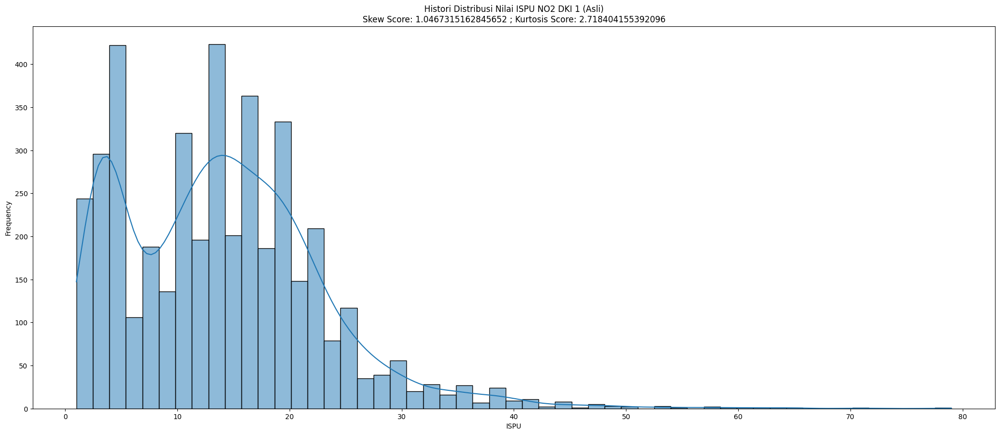

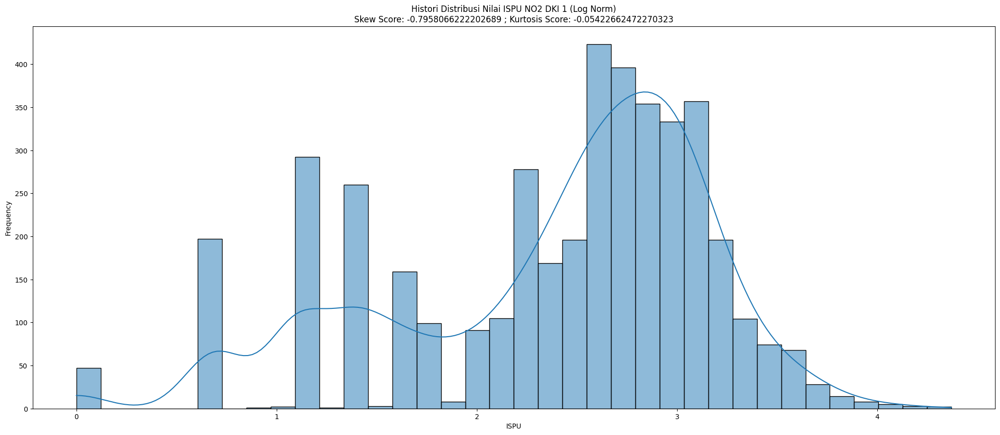

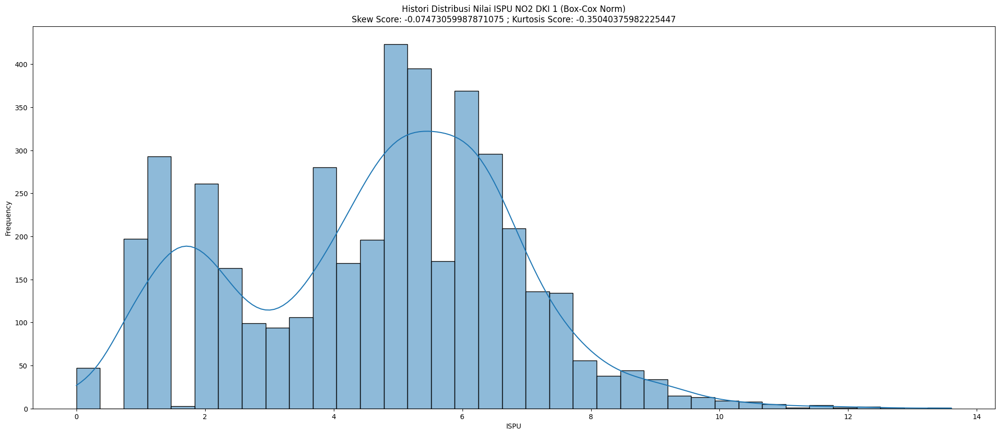

In [152]:
eda_skew(dki1NO2TI, 'no2', 'Histori Distribusi Nilai ISPU NO2 DKI 1 (Asli)')
eda_skew(dki1NO2TI_logNorm, 'no2', 'Histori Distribusi Nilai ISPU NO2 DKI 1 (Log Norm)')
eda_skew(dki1NO2TI_boxCoxNorm, 'no2', 'Histori Distribusi Nilai ISPU NO2 DKI 1 (Box-Cox Norm)')

### Perbandingan (Stasiun DKI 2)

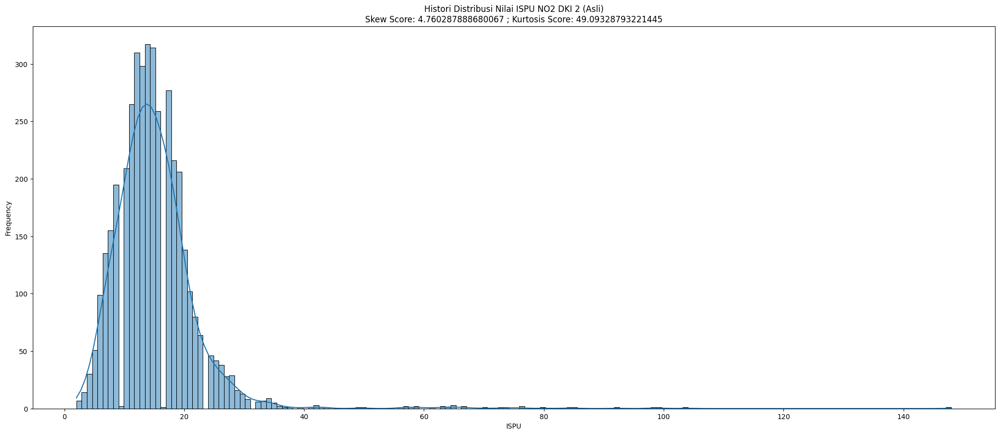

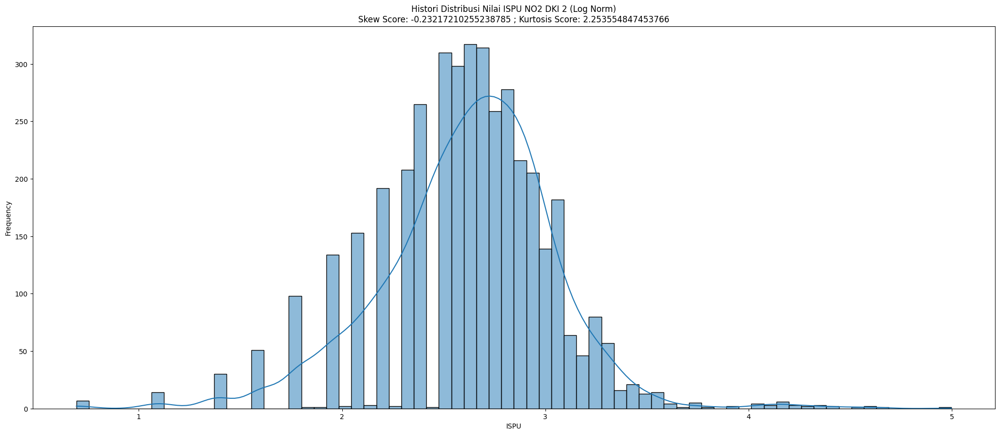

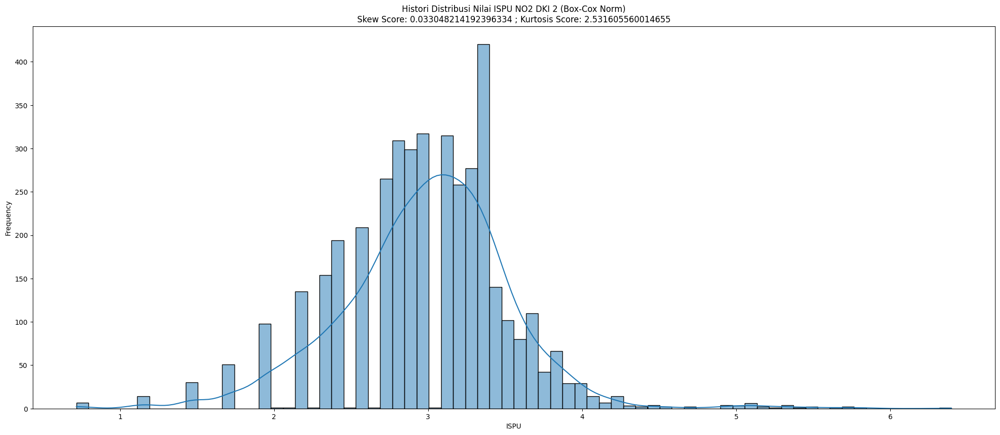

In [153]:
eda_skew(dki2NO2TI, 'no2', 'Histori Distribusi Nilai ISPU NO2 DKI 2 (Asli)')
eda_skew(dki2NO2TI_logNorm, 'no2', 'Histori Distribusi Nilai ISPU NO2 DKI 2 (Log Norm)')
eda_skew(dki2NO2TI_boxCoxNorm, 'no2', 'Histori Distribusi Nilai ISPU NO2 DKI 2 (Box-Cox Norm)')

### Perbandingan (Stasiun DKI 3)

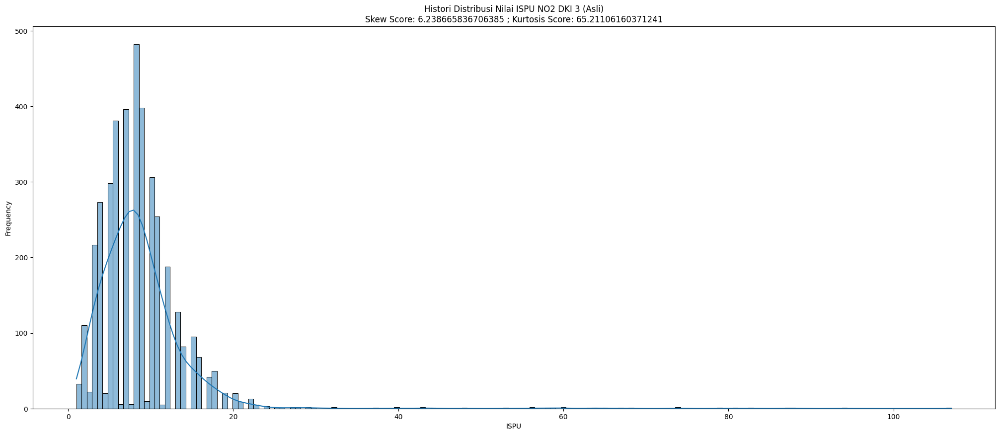

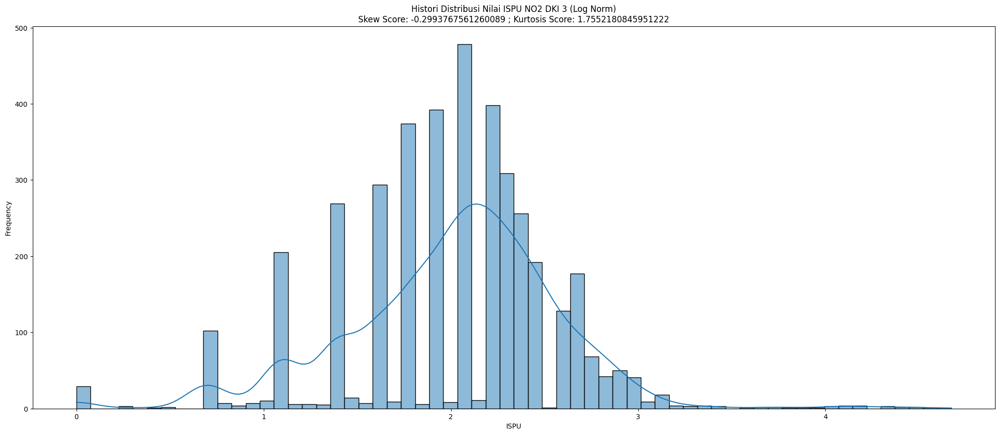

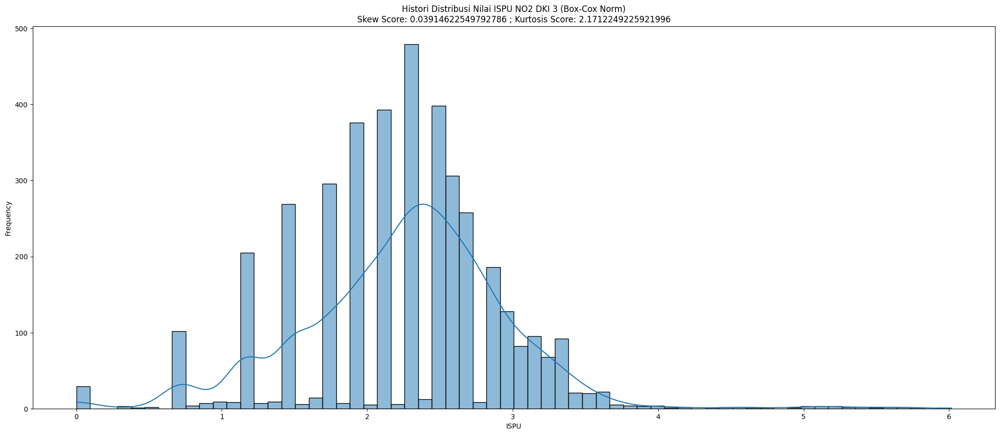

In [154]:
eda_skew(dki3NO2TI, 'no2', 'Histori Distribusi Nilai ISPU NO2 DKI 3 (Asli)')
eda_skew(dki3NO2TI_logNorm, 'no2', 'Histori Distribusi Nilai ISPU NO2 DKI 3 (Log Norm)')
eda_skew(dki3NO2TI_boxCoxNorm, 'no2', 'Histori Distribusi Nilai ISPU NO2 DKI 3 (Box-Cox Norm)')

### Perbandingan (Stasiun DKI 4)

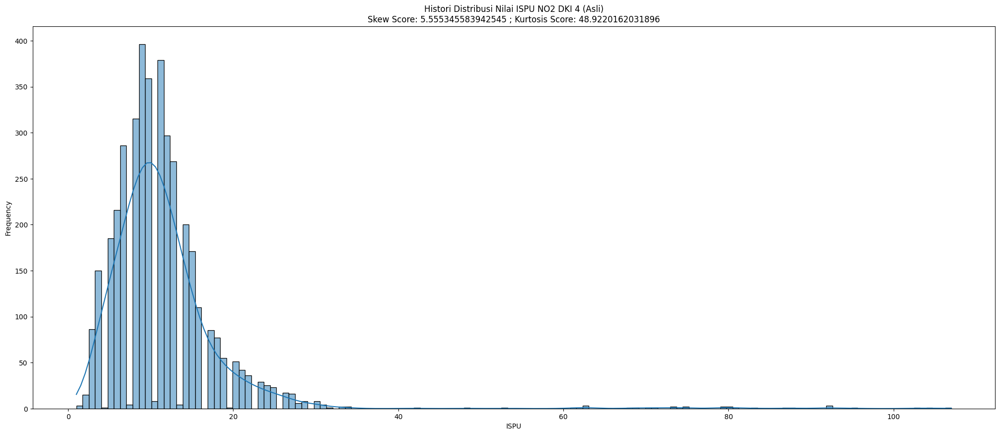

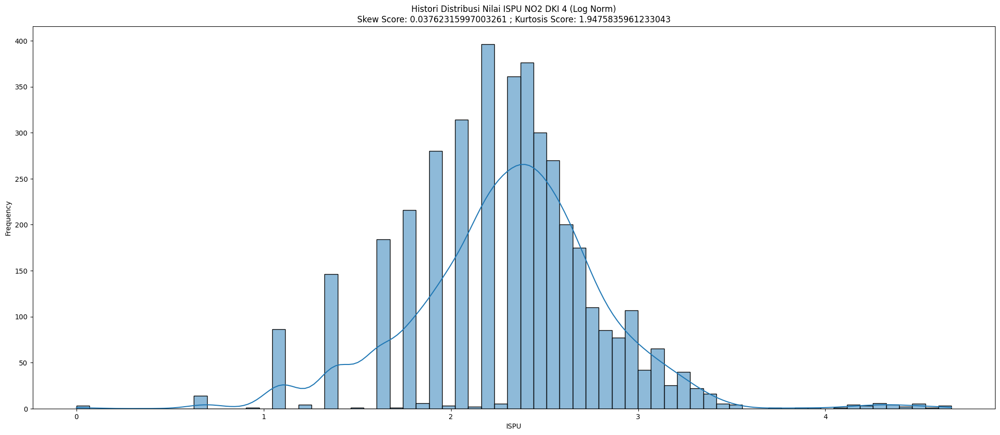

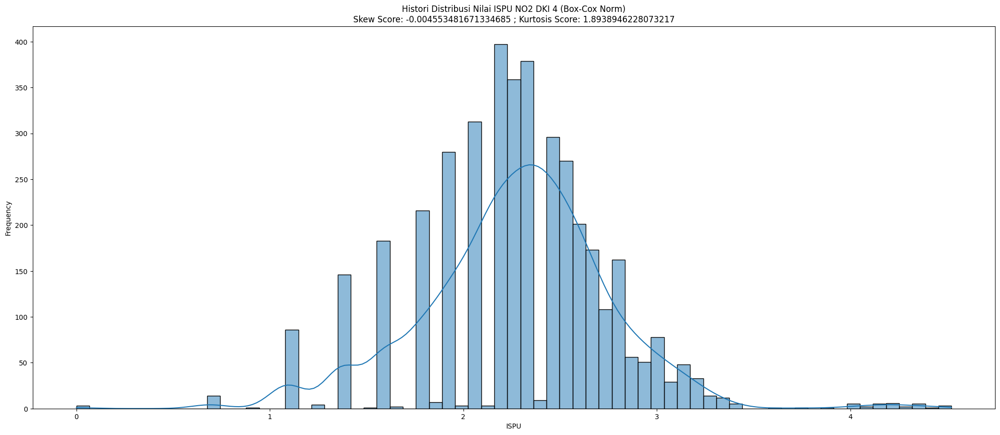

In [155]:
eda_skew(dki4NO2TI, 'no2', 'Histori Distribusi Nilai ISPU NO2 DKI 4 (Asli)')
eda_skew(dki4NO2TI_logNorm, 'no2', 'Histori Distribusi Nilai ISPU NO2 DKI 4 (Log Norm)')
eda_skew(dki4NO2TI_boxCoxNorm, 'no2', 'Histori Distribusi Nilai ISPU NO2 DKI 4 (Box-Cox Norm)')

### Perbandingan (Stasiun DKI 5)

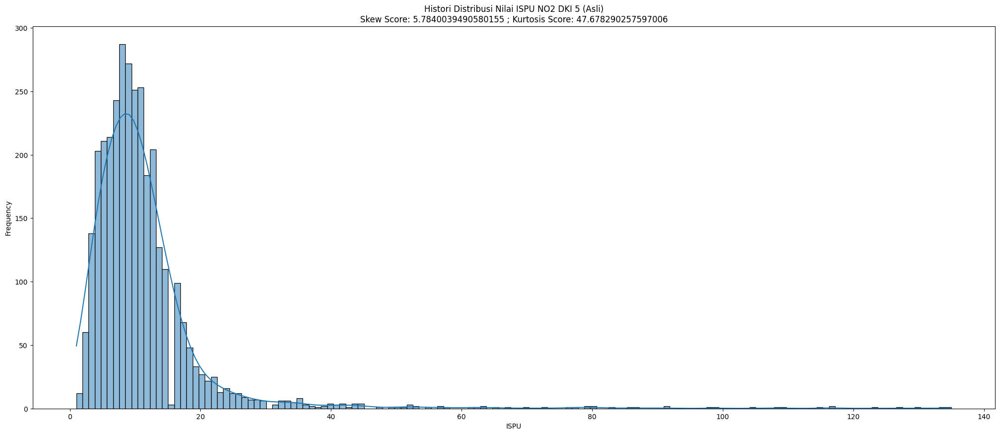

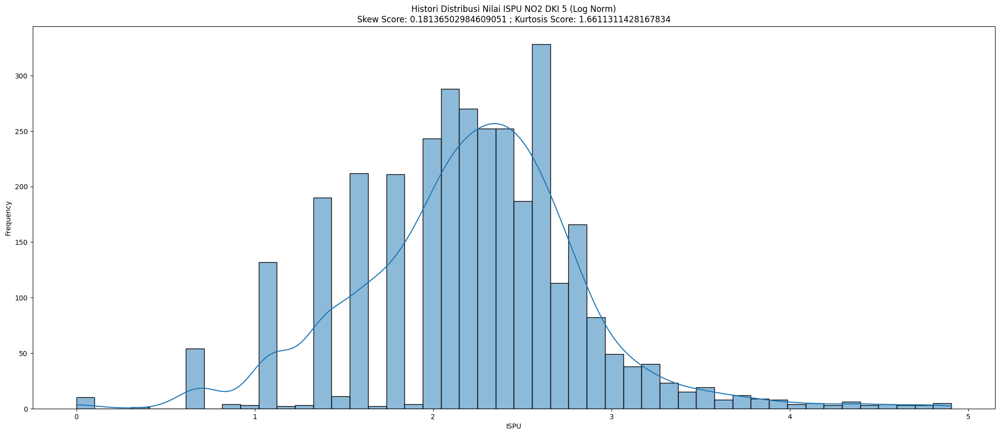

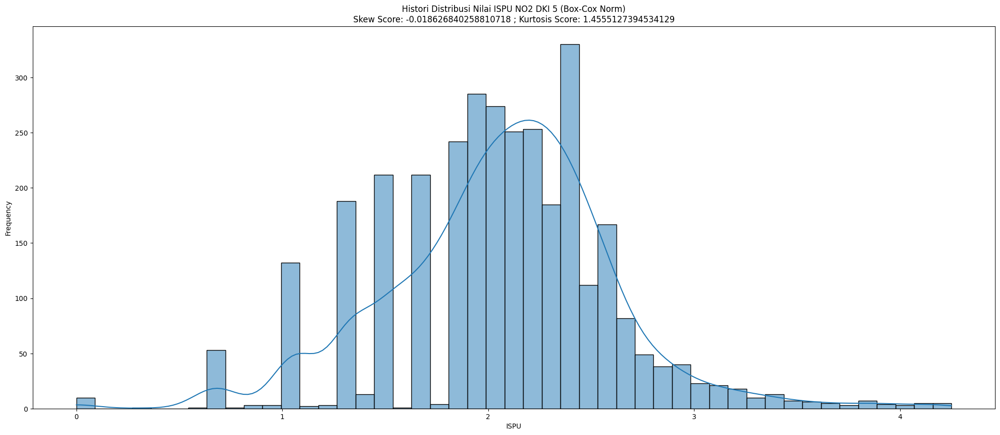

In [156]:
eda_skew(dki5NO2TI, 'no2', 'Histori Distribusi Nilai ISPU NO2 DKI 5 (Asli)')
eda_skew(dki5NO2TI_logNorm, 'no2', 'Histori Distribusi Nilai ISPU NO2 DKI 5 (Log Norm)')
eda_skew(dki5NO2TI_boxCoxNorm, 'no2', 'Histori Distribusi Nilai ISPU NO2 DKI 5 (Box-Cox Norm)')

### Kesimpulan

Berdasarkan hasil berikut, hasil normalisasi dari Box-Cox memberikan hasil rata-rata **11.43%** lebih baik dibandingkan metode Logaritma. Untuk itu hasil dari normalisasi Box-Cox akan dipakai di tahap berikutnya

# Exploratory Data Analysis (Stasioneritas)

Data stasioner adalah data yang menunjukan mean, varian, dan autovarians tetap sama pada waktu kapan saja data itu dibentuk atau dipakai, artinya dengan data yang stasioner model time series dapat dikatakan lebih stabil. Apabila data yang digunakan dalam model ada yang tidak stasioner.

Pengujian data stasioner umumnya menggunakan metode _Augmented Dickey-Fuller (ADF)_.

Pengujian ADF adalah metode statistik yang digunakan untuk menguji apakah suatu deret waktu stasioner atau tidak. Deret waktu stasioner tidak memiliki tren atau pola sistematis yang berubah seiring waktu.

Rumus pengujian ADF (Augmented Dickey-Fuller) dapat dinyatakan sebagai berikut:

Δyt = α + βt + γyt-1 + δ1Δyt-1 + δ2Δyt-2 + ... + δp-1Δyt-p+1 + εt

Di dalam rumus tersebut:
* Δyt adalah selisih atau differencing pertama dari deret waktu yang diuji.
* α adalah konstanta.
* βt adalah komponen linear yang mewakili tren waktu.
* yt-1 adalah nilai lag satu dari deret waktu.
* Δy
t−1
​
 ,Δy
t−2
​
 ,…,Δy
t−p+1
​
  adalah differencing pertama dari lag-lag sebelumnya.
* γ,δ
1
​
 ,δ
2
​
 ,…,δ
p−1
​
  adalah koefisien yang diestimasi dalam model.
* ε
t
​
  adalah residual atau kesalahan pada waktu t.

Untuk nilai tingkat signifikasi _p-value_ pada ADF adalah 0.05 dimana

_H0_ : _p-value_ >= 0.05 (Tidak Stasioner)

_H1_ : _p-value_ < 0.05 (Stasioner)

Sedangkan untuk KPSS

_H0_ : _p-value_ >= 0.05 (Stasioner)

_H1_ : _p-value_ < 0.05 (Tidak Stasioner)

## Membuat fungsi uji stasioneritas (ADF dan KPSS)

In [157]:
def adf_test(series):
    result = adfuller(series)
    print('ADF Statistic:', result[0])
    print('p-value:', result[1])
    print('lags:', result[2])
    print('Critical Values:')
    for key, value in result[4].items():
        print("\t{}: {} - The data is {} stationary with {}% confidence"
        .format(key, value, "not" if value<result[0] else "", 100-int(key[:-1])))
    print("\n\n")

def kpss_test(timeseries):
    print("Results of KPSS Test:")
    kpsstest = kpss(timeseries, regression="c", nlags="auto")
    kpss_output = pd.Series(
        kpsstest[0:3], index=["Test Statistic", "p-value", "Lags Used"]
    )
    for key, value in kpsstest[3].items():
        kpss_output["Critical Value (%s)" % key] = value
    print(kpss_output)

In [159]:
print("Stasioner DKI 1")
adf_test(dki1NO2TI_boxCoxNorm['no2'])
kpss_test(dki1NO2TI_boxCoxNorm['no2'])

print("Stasioner DKI 2")
adf_test(dki2NO2TI_boxCoxNorm['no2'])
kpss_test(dki2NO2TI_boxCoxNorm['no2'])

print("Stasioner DKI 3")
adf_test(dki3NO2TI_boxCoxNorm['no2'])
kpss_test(dki3NO2TI_boxCoxNorm['no2'])

print("Stasioner DKI 4")
adf_test(dki4NO2TI_boxCoxNorm['no2'])
kpss_test(dki4NO2TI_boxCoxNorm['no2'])

print("Stasioner DKI 5")
adf_test(dki5NO2TI_boxCoxNorm['no2'])
kpss_test(dki5NO2TI_boxCoxNorm['no2'])

Stasioner DKI 1
ADF Statistic: -3.5216941228352425
p-value: 0.007447112672842747
lags: 26
Critical Values:
	1%: -3.4318910404554495 - The data is  stationary with 99% confidence
	5%: -2.862220946630885 - The data is  stationary with 95% confidence
	10%: -2.5671324732839906 - The data is  stationary with 90% confidence



Results of KPSS Test:


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/stattools.py:2018: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


Test Statistic            1.766977
p-value                   0.010000
Lags Used                39.000000
Critical Value (10%)      0.347000
Critical Value (5%)       0.463000
Critical Value (2.5%)     0.574000
Critical Value (1%)       0.739000
dtype: float64
Stasioner DKI 2
ADF Statistic: -6.686187707480861
p-value: 4.220321993885922e-09
lags: 29
Critical Values:
	1%: -3.4319850573119437 - The data is  stationary with 99% confidence
	5%: -2.8622624788783146 - The data is  stationary with 95% confidence
	10%: -2.567154583183171 - The data is  stationary with 90% confidence



Results of KPSS Test:
Test Statistic            0.567187
p-value                   0.026535
Lags Used                36.000000
Critical Value (10%)      0.347000
Critical Value (5%)       0.463000
Critical Value (2.5%)     0.574000
Critical Value (1%)       0.739000
dtype: float64
Stasioner DKI 3
ADF Statistic: -8.281420231018451
p-value: 4.5089332822208695e-13
lags: 10
Critical Values:
	1%: -3.431998660700255 - T

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/stattools.py:2018: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/stattools.py:2018: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  warnings.warn(


ADF Statistic: -7.364551445243024
p-value: 9.310076624904536e-11
lags: 7
Critical Values:
	1%: -3.4323519707362373 - The data is  stationary with 99% confidence
	5%: -2.8624245515277273 - The data is  stationary with 95% confidence
	10%: -2.5672408654891967 - The data is  stationary with 90% confidence



Results of KPSS Test:
Test Statistic            0.638989
p-value                   0.019092
Lags Used                35.000000
Critical Value (10%)      0.347000
Critical Value (5%)       0.463000
Critical Value (2.5%)     0.574000
Critical Value (1%)       0.739000
dtype: float64


Berdasarkan hasil pengujian, nilai _p-value_ ADF dan KPSS seluruh stasiun berada dibawah 0.05, sehingga seluruh data stasiun merupakan _difference stationary_ sehingga seluruh data stasiun harus dilakukan differensiasi agar data menjadi stasioner

## Differencing Series

In [160]:
dki1NO2TI_boxCoxNorm['no2_diff'] = dki1NO2TI_boxCoxNorm.no2.diff(8)
dki2NO2TI_boxCoxNorm['no2_diff'] = dki2NO2TI_boxCoxNorm.no2.diff(7)
dki3NO2TI_boxCoxNorm['no2_diff'] = dki3NO2TI_boxCoxNorm.no2.diff(7)
dki4NO2TI_boxCoxNorm['no2_diff'] = dki4NO2TI_boxCoxNorm.no2.diff(7)
dki5NO2TI_boxCoxNorm['no2_diff'] = dki5NO2TI_boxCoxNorm.no2.diff(7)
dki1NO2TI_boxCoxNorm = dki1NO2TI_boxCoxNorm.dropna()
dki2NO2TI_boxCoxNorm = dki2NO2TI_boxCoxNorm.dropna()
dki3NO2TI_boxCoxNorm = dki3NO2TI_boxCoxNorm.dropna()
dki4NO2TI_boxCoxNorm = dki4NO2TI_boxCoxNorm.dropna()
dki5NO2TI_boxCoxNorm = dki5NO2TI_boxCoxNorm.dropna()

In [161]:
print("Stasioner DKI 1")
adf_test(dki1NO2TI_boxCoxNorm['no2_diff'])
kpss_test(dki1NO2TI_boxCoxNorm['no2_diff'])

print("Stasioner DKI 2")
adf_test(dki2NO2TI_boxCoxNorm['no2_diff'])
kpss_test(dki2NO2TI_boxCoxNorm['no2_diff'])

print("Stasioner DKI 3")
adf_test(dki3NO2TI_boxCoxNorm['no2_diff'])
kpss_test(dki3NO2TI_boxCoxNorm['no2_diff'])

print("Stasioner DKI 4")
adf_test(dki4NO2TI_boxCoxNorm['no2_diff'])
kpss_test(dki4NO2TI_boxCoxNorm['no2_diff'])

print("Stasioner DKI 5")
adf_test(dki5NO2TI_boxCoxNorm['no2_diff'])
kpss_test(dki5NO2TI_boxCoxNorm['no2_diff'])

Stasioner DKI 1
ADF Statistic: -16.384986412274234
p-value: 2.7285470185710886e-29
lags: 31
Critical Values:
	1%: -3.4318957760316944 - The data is  stationary with 99% confidence
	5%: -2.8622230386181973 - The data is  stationary with 95% confidence
	10%: -2.567133586958554 - The data is  stationary with 90% confidence



Results of KPSS Test:
Test Statistic            0.016969
p-value                   0.100000
Lags Used                25.000000
Critical Value (10%)      0.347000
Critical Value (5%)       0.463000
Critical Value (2.5%)     0.574000
Critical Value (1%)       0.739000
dtype: float64
Stasioner DKI 2
ADF Statistic: -13.82482160184559
p-value: 7.784563056237512e-26
lags: 31
Critical Values:
	1%: -3.4319887450134567 - The data is  stationary with 99% confidence
	5%: -2.862264107905561 - The data is  stationary with 95% confidence
	10%: -2.567155450408488 - The data is  stationary with 90% confidence



Results of KPSS Test:
Test Statistic            0.013399
p-value       

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/stattools.py:2022: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/stattools.py:2022: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warnings.warn(


ADF Statistic: -14.53693429206193
p-value: 5.220703057245167e-27
lags: 28
Critical Values:
	1%: -3.432009117949223 - The data is  stationary with 99% confidence
	5%: -2.862273107531309 - The data is  stationary with 95% confidence
	10%: -2.567160241435369 - The data is  stationary with 90% confidence



Results of KPSS Test:
Test Statistic            0.006744
p-value                   0.100000
Lags Used                21.000000
Critical Value (10%)      0.347000
Critical Value (5%)       0.463000
Critical Value (2.5%)     0.574000
Critical Value (1%)       0.739000
dtype: float64
Stasioner DKI 4
ADF Statistic: -13.825501283284012
p-value: 7.763233808925082e-26
lags: 28
Critical Values:
	1%: -3.4320116474585953 - The data is  stationary with 99% confidence
	5%: -2.862274224923052 - The data is  stationary with 95% confidence
	10%: -2.567160836289042 - The data is  stationary with 90% confidence



Results of KPSS Test:
Test Statistic            0.00938
p-value                   0.10000


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/stattools.py:2022: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warnings.warn(
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/stattools.py:2022: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warnings.warn(


ADF Statistic: -12.643510079334668
p-value: 1.418021032753268e-23
lags: 28
Critical Values:
	1%: -3.4323692801073022 - The data is  stationary with 99% confidence
	5%: -2.862432196914153 - The data is  stationary with 95% confidence
	10%: -2.5672449357321216 - The data is  stationary with 90% confidence



Results of KPSS Test:
Test Statistic            0.025234
p-value                   0.100000
Lags Used                17.000000
Critical Value (10%)      0.347000
Critical Value (5%)       0.463000
Critical Value (2.5%)     0.574000
Critical Value (1%)       0.739000
dtype: float64


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/stattools.py:2022: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  warnings.warn(


## Korelasi (ACF and P-ACF)

Korelasi ACF (Autocorrelation Function) dan PACF (Partial Autocorrelation Function) adalah alat statistik yang digunakan dalam analisis deret waktu untuk memahami ketergantungan atau hubungan antara nilai-nilai dalam deret waktu.

In [162]:
def create_acf_pacf(station, component, lags):
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16,5))
  plot_acf(station[component], lags=lags, ax=ax1)
  plot_pacf(station[component], lags=lags, method='ols', ax=ax2)
  plt.show()
  plt.close()

### Stasiun DKI 1

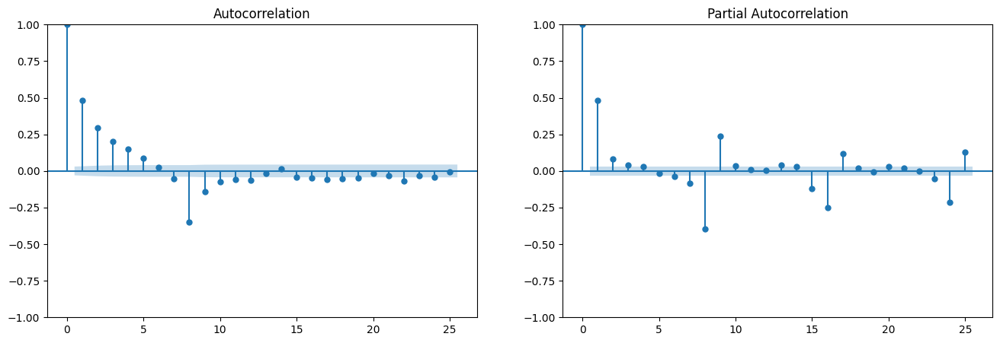

In [163]:
create_acf_pacf(dki1NO2TI_boxCoxNorm, 'no2_diff', 25)

### Stasiun DKI 2

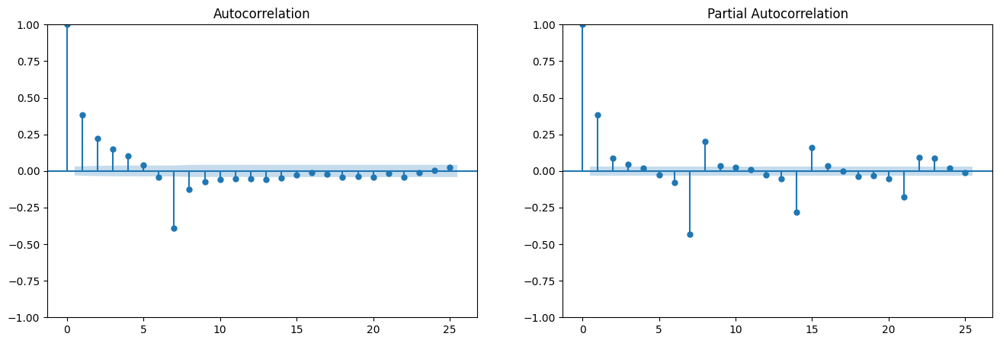

In [164]:
create_acf_pacf(dki2NO2TI_boxCoxNorm, 'no2_diff', 25)

### Stasiun DKI 3

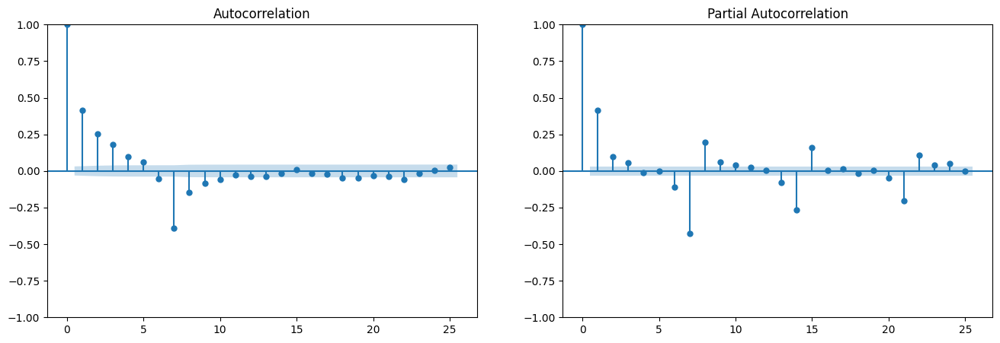

In [165]:
create_acf_pacf(dki3NO2TI_boxCoxNorm, 'no2_diff', 25)

### Stasiun DKI 4

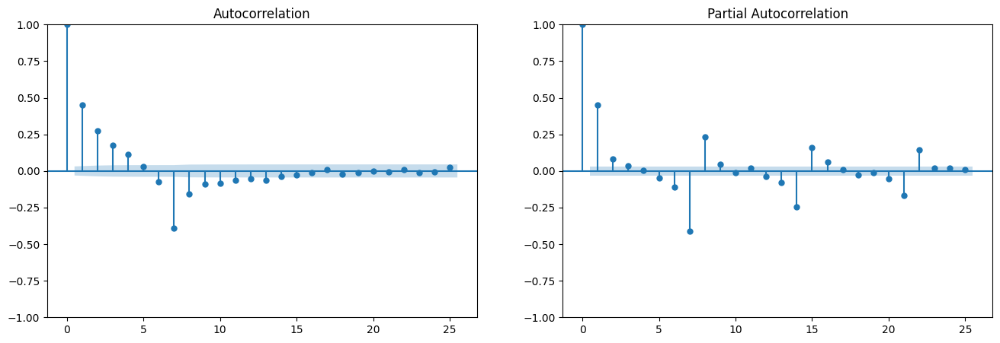

In [166]:
create_acf_pacf(dki4NO2TI_boxCoxNorm, 'no2_diff', 25)

### Stasiun DKI 5

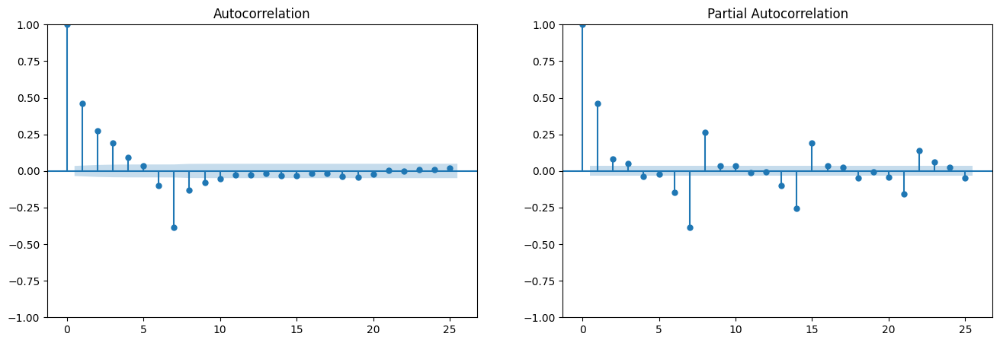

In [167]:
create_acf_pacf(dki5NO2TI_boxCoxNorm, 'no2_diff', 25)

# Data Preparation

## Train-test Split

Langkah awal untuk membangun model adalah dengan melakukan pembagian antara data latih dengan data pengujian. Untuk proyek ini, pembagian akan menggunakan rasio **80:20** untuk ARIMA dan **60:20:20** untuk LSTM dimana 20% tambahan digunakan untuk data validasi

### Buat fungsi train-test split

In [168]:
def train_test_split(df, column, test_ratio, validation=False):
  if ('tanggal' not in df.columns):
    df.reset_index(inplace=True)
  train_split = int(len(df) * (1 - test_ratio))
  test_split = int(len(df) * test_ratio)

  # Create the train and test sets.
  train_df = df.loc[:(train_split - test_split) if validation else train_split]
  if (validation):
    val_df = df.loc[(train_split - test_split):train_split-1]
    test_df = df.loc[train_split:]
    return train_df, val_df, test_df
  else:
    test_df = df.loc[train_split:]
    return train_df, test_df

### Split For ARIMA

In [169]:
trainDKI1ARIMA, testDKI1ARIMA = train_test_split(dki1NO2TI_boxCoxNorm, 'no2_diff', 0.2)
trainDKI2ARIMA, testDKI2ARIMA = train_test_split(dki2NO2TI_boxCoxNorm, 'no2_diff', 0.2)
trainDKI3ARIMA, testDKI3ARIMA = train_test_split(dki3NO2TI_boxCoxNorm, 'no2_diff', 0.2)
trainDKI4ARIMA, testDKI4ARIMA = train_test_split(dki4NO2TI_boxCoxNorm, 'no2_diff', 0.2)
trainDKI5ARIMA, testDKI5ARIMA = train_test_split(dki5NO2TI_boxCoxNorm, 'no2_diff', 0.2)

In [171]:
print(len(trainDKI1ARIMA), len(testDKI1ARIMA))
print(len(trainDKI2ARIMA), len(testDKI2ARIMA))
print(len(trainDKI3ARIMA), len(testDKI3ARIMA))
print(len(trainDKI4ARIMA), len(testDKI4ARIMA))
print(len(trainDKI5ARIMA), len(testDKI5ARIMA))

3413 853
3221 805
3179 795
3174 794
2617 654


### Split For LSTM

In [170]:
trainDKI1LSTM, valDKI1LSTM, testDKI1LSTM = train_test_split(dki1NO2TI_boxCoxNorm, 'no2_diff', 0.2, True)
trainDKI2LSTM, valDKI2LSTM, testDKI2LSTM = train_test_split(dki2NO2TI_boxCoxNorm, 'no2_diff', 0.2, True)
trainDKI3LSTM, valDKI3LSTM, testDKI3LSTM = train_test_split(dki3NO2TI_boxCoxNorm, 'no2_diff', 0.2, True)
trainDKI4LSTM, valDKI4LSTM, testDKI4LSTM = train_test_split(dki4NO2TI_boxCoxNorm, 'no2_diff', 0.2, True)
trainDKI5LSTM, valDKI5LSTM, testDKI5LSTM = train_test_split(dki5NO2TI_boxCoxNorm, 'no2_diff', 0.2, True)

In [172]:
print(len(trainDKI1LSTM), len(valDKI1LSTM), len(testDKI1LSTM))
print(len(trainDKI2LSTM), len(valDKI2LSTM), len(testDKI2LSTM))
print(len(trainDKI3LSTM), len(valDKI3LSTM), len(testDKI3LSTM))
print(len(trainDKI4LSTM), len(valDKI4LSTM), len(testDKI4LSTM))
print(len(trainDKI5LSTM), len(valDKI5LSTM), len(testDKI5LSTM))

2560 853 853
2416 805 805
2385 794 795
2381 793 794
1963 654 654


## Windowed Dataset

### Buat Fungsi

In [ ]:
def windowed_dataset(series, batch_size, n_past=10, n_future=10, shift=1):
    ds = tf.data.Dataset.from_tensor_slices(series)
    ds = ds.window(size=n_past + n_future, shift=shift, drop_remainder=True)
    ds = ds.flat_map(lambda w: w.batch(n_past + n_future))
    ds = ds.map(lambda w: (w[:n_past], w[n_past:]))
    return ds.batch(batch_size).prefetch(1)

### Buat Windowed Dataset

In [ ]:
dki1_train_set = windowed_dataset(trainDKI1LSTM['no2_diff'].values, 32, 7, 7)
dki1_val_set = windowed_dataset(valDKI1LSTM['no2_diff'].values, 32, 7, 7)

dki2_train_set = windowed_dataset(trainDKI2LSTM['no2_diff'].values, 32, 7, 7)
dki2_val_set = windowed_dataset(valDKI2LSTM['no2_diff'].values, 32, 7, 7)

dki3_train_set = windowed_dataset(trainDKI3LSTM['no2_diff'].values, 32, 7, 7)
dki3_val_set = windowed_dataset(valDKI3LSTM['no2_diff'].values, 32, 7, 7)

dki4_train_set = windowed_dataset(trainDKI4LSTM['no2_diff'].values, 32, 7, 7)
dki4_val_set = windowed_dataset(valDKI4LSTM['no2_diff'].values, 32, 7, 7)

dki5_train_set = windowed_dataset(trainDKI5LSTM['no2_diff'].values, 32, 7, 7)
dki5_val_set = windowed_dataset(valDKI5LSTM['no2_diff'].values, 32, 7, 7)

# Modelling

Setelah melakukan persiapan pada data, langkah selanjutnya adalah membangun model prediksi.



## ARIMA (Autoregressive Integrated Moving Average)

ARIMA (Autoregressive Integrated Moving Average) adalah suatu model yang digunakan untuk menganalisis dan meramalkan deret waktu, seperti data penjualan bulanan, harga saham, atau suhu harian. Model ARIMA memperhitungkan pola dan tren dalam data untuk membuat perkiraan tentang nilai-nilai di masa depan.

ARIMA terdiri dari tiga komponen utama:

1. Autoregresi (AR): Komponen ini memperhitungkan bagaimana nilai-nilai sebelumnya dalam deret waktu mempengaruhi nilai saat ini. Misalnya, jika penjualan bulan lalu tinggi, kemungkinan penjualan bulan ini juga akan tinggi.
2. Integrasi (I): Komponen ini digunakan untuk membuat deret waktu menjadi lebih stabil dengan menghilangkan tren atau fluktuasi sistematis. Dengan cara ini, kita dapat melihat pola yang lebih jelas dalam data.
3. Moving Average (MA): Komponen ini memperhitungkan pola kesalahan atau perbedaan antara nilai sebenarnya dan nilai yang diprediksi. Dalam model MA, kesalahan masa lalu digunakan untuk memprediksi kesalahan di masa depan.

Dalam model ARIMA, kita menentukan tiga angka dalam format ARIMA(p, d, q), di mana:

* p adalah jumlah lag yang diperhitungkan dalam komponen autoregresi. Semakin besar nilai p, semakin jauh ke belakang kita melihat untuk memprediksi nilai saat ini.
* d adalah jumlah differencing yang dilakukan pada data. Ini membantu menghilangkan tren dan membuat deret waktu menjadi lebih stasioner.
* q adalah jumlah lag yang diperhitungkan dalam komponen moving average. Semakin besar nilai q, semakin banyak kesalahan masa lalu yang diperhitungkan untuk memprediksi kesalahan di masa depan.

## Create and Train Model

### ARIMA

#### Create models and train it

In [176]:
dki1_arima_model405 = sm.tsa.ARIMA(trainDKI1ARIMA['no2_diff'], order=(4, 0, 5)).fit()
dki2_arima_model405 = sm.tsa.ARIMA(trainDKI2ARIMA['no2_diff'], order=(4, 0, 5)).fit()
dki3_arima_model405 = sm.tsa.ARIMA(trainDKI3ARIMA['no2_diff'], order=(4, 0, 5)).fit()
dki4_arima_model405 = sm.tsa.ARIMA(trainDKI4ARIMA['no2_diff'], order=(4, 0, 5)).fit()
dki5_arima_model405 = sm.tsa.ARIMA(trainDKI5ARIMA['no2_diff'], order=(4, 0, 5)).fit()
print(dki1_arima_model405.summary())
print(dki2_arima_model405.summary())
print(dki3_arima_model405.summary())
print(dki4_arima_model405.summary())
print(dki5_arima_model405.summary())

/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood op

                               SARIMAX Results                                
Dep. Variable:               no2_diff   No. Observations:                 3413
Model:                 ARIMA(4, 0, 5)   Log Likelihood               -4836.255
Date:                Thu, 22 Jun 2023   AIC                           9694.510
Time:                        16:49:01   BIC                           9761.998
Sample:                             0   HQIC                          9718.626
                               - 3413                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0369      0.040      0.922      0.356      -0.042       0.115
ar.L1         -0.2627      0.019    -14.086      0.000      -0.299      -0.226
ar.L2          0.2512      0.016     16.185      0.0

In [ ]:
dki1_arima_model = sm.tsa.ARIMA(trainDKI1ARIMA['no2_diff'], order=(5, 0, 5)).fit()
dki2_arima_model = sm.tsa.ARIMA(trainDKI2ARIMA['no2_diff'], order=(5, 0, 5)).fit()
dki3_arima_model = sm.tsa.ARIMA(trainDKI3ARIMA['no2_diff'], order=(5, 0, 5)).fit()
dki4_arima_model = sm.tsa.ARIMA(trainDKI4ARIMA['no2_diff'], order=(5, 0, 5)).fit()
dki5_arima_model = sm.tsa.ARIMA(trainDKI5ARIMA['no2_diff'], order=(5, 0, 5)).fit()
print(dki1_arima_model.summary())
print(dki2_arima_model.summary())
print(dki3_arima_model.summary())
print(dki4_arima_model.summary())
print(dki5_arima_model.summary())

/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood op

                               SARIMAX Results                                
Dep. Variable:               no2_diff   No. Observations:                 3413
Model:                 ARIMA(5, 0, 5)   Log Likelihood               -4721.914
Date:                Tue, 20 Jun 2023   AIC                           9467.829
Time:                        05:39:47   BIC                           9541.453
Sample:                             0   HQIC                          9494.138
                               - 3413                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0085      0.034      0.248      0.804      -0.058       0.075
ar.L1         -0.4907      0.015    -32.000      0.000      -0.521      -0.461
ar.L2          0.2984      0.015     19.968      0.0

### LSTM

#### Create model and compile

In [177]:
dki1_lstm_model = Sequential([
    Input(shape=(7, 1)),
    Bidirectional(LSTM(128, return_sequences=True)),
    LSTM(64, return_sequences=True),
    Dense(30, activation='relu'),
    Dense(10, activation='relu'),
    Dense(1)
])

dki1_lstm_model.compile(
    loss=tf.keras.losses.Huber(),
    optimizer=tf.keras.optimizers.RMSprop(0.0001),
    metrics=['mae']
)

dki2_lstm_model = Sequential([
    Input(shape=(7, 1)),
    Bidirectional(LSTM(128, return_sequences=True)),
    LSTM(64, return_sequences=True),
    Dense(30, activation='relu'),
    Dense(10, activation='relu'),
    Dense(1)
])

dki2_lstm_model.compile(
    loss=tf.keras.losses.Huber(),
    optimizer=tf.keras.optimizers.RMSprop(0.0001),
    metrics=['mae']
)

dki3_lstm_model = Sequential([
    Input(shape=(7, 1)),
    Bidirectional(LSTM(128, return_sequences=True)),
    LSTM(64, return_sequences=True),
    Dense(30, activation='relu'),
    Dense(10, activation='relu'),
    Dense(1)
])

dki3_lstm_model.compile(
    loss=tf.keras.losses.Huber(),
    optimizer=tf.keras.optimizers.RMSprop(0.0001),
    metrics=['mae']
)

dki4_lstm_model = Sequential([
    Input(shape=(7, 1)),
    Bidirectional(LSTM(128, return_sequences=True)),
    LSTM(64, return_sequences=True),
    Dense(30, activation='relu'),
    Dense(10, activation='relu'),
    Dense(1)
])

dki4_lstm_model.compile(
    loss=tf.keras.losses.Huber(),
    optimizer=tf.keras.optimizers.RMSprop(0.0001),
    metrics=['mae']
)

dki5_lstm_model = Sequential([
    Input(shape=(7, 1)),
    Bidirectional(LSTM(128, return_sequences=True)),
    LSTM(64, return_sequences=True),
    Dense(30, activation='relu'),
    Dense(10, activation='relu'),
    Dense(1)
])

dki5_lstm_model.compile(
    loss=tf.keras.losses.Huber(),
    optimizer=tf.keras.optimizers.RMSprop(0.0001),
    metrics=['mae']
)

In [183]:
dki1_lstm_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional (Bidirectiona  (None, 7, 256)           133120    
 l)                                                              
                                                                 
 lstm_1 (LSTM)               (None, 7, 64)             82176     
                                                                 
 dense (Dense)               (None, 7, 30)             1950      
                                                                 
 dense_1 (Dense)             (None, 7, 10)             310       
                                                                 
 dense_2 (Dense)             (None, 7, 1)              11        
                                                                 
Total params: 217,567
Trainable params: 217,567
Non-trainable params: 0
__________________________________________________

#### Create Callback

In [ ]:
def create_callback(filepath):
  return [
      tf.keras.callbacks.EarlyStopping(
          patience=50,
          restore_best_weights=True
      ),
      tf.keras.callbacks.ModelCheckpoint(filepath, 'val_mae', 1, True),
  ]

#### Training

In [ ]:
print("Training DKI 1 Model")
dki1_history = dki1_lstm_model.fit(
    dki1_train_set, epochs=300,
    validation_data=dki1_val_set,
    callbacks=create_callback('/content/dki1_lstm.h5'),
    verbose=2
)

print("Training DKI 2 Model")
dki2_history = dki2_lstm_model.fit(
    dki2_train_set, epochs=300,
    validation_data=dki2_val_set,
    callbacks=create_callback('/content/dki2_lstm.h5'),
    verbose=2
)

print("Training DKI 3 Model")
dki3_history = dki3_lstm_model.fit(
    dki3_train_set, epochs=300,
    validation_data=dki3_val_set,
    callbacks=create_callback('/content/dki3_lstm.h5'),
    verbose=2
)

print("Training DKI 4 Model")
dki4_history = dki4_lstm_model.fit(
    dki4_train_set, epochs=300,
    validation_data=dki4_val_set,
    callbacks=create_callback('/content/dki4_lstm.h5'),
    verbose=2
)

print("Training DKI 5 Model")
dki5_history = dki5_lstm_model.fit(
    dki5_train_set, epochs=300,
    validation_data=dki5_val_set,
    callbacks=create_callback('/content/dki5_lstm.h5'),
    verbose=2
)

Streaming output truncated to the last 5000 lines.
Epoch 157/300

Epoch 157: val_mae improved from 0.80462 to 0.80456, saving model to /content/dki1_lstm.h5
80/80 - 1s - loss: 0.5345 - mae: 0.9158 - val_loss: 0.4381 - val_mae: 0.8046 - 1s/epoch - 13ms/step
Epoch 158/300

Epoch 158: val_mae improved from 0.80456 to 0.80453, saving model to /content/dki1_lstm.h5
80/80 - 1s - loss: 0.5342 - mae: 0.9154 - val_loss: 0.4380 - val_mae: 0.8045 - 1s/epoch - 13ms/step
Epoch 159/300

Epoch 159: val_mae improved from 0.80453 to 0.80448, saving model to /content/dki1_lstm.h5
80/80 - 1s - loss: 0.5339 - mae: 0.9151 - val_loss: 0.4379 - val_mae: 0.8045 - 1s/epoch - 13ms/step
Epoch 160/300

Epoch 160: val_mae improved from 0.80448 to 0.80441, saving model to /content/dki1_lstm.h5
80/80 - 1s - loss: 0.5336 - mae: 0.9148 - val_loss: 0.4378 - val_mae: 0.8044 - 1s/epoch - 13ms/step
Epoch 161/300

Epoch 161: val_mae improved from 0.80441 to 0.80436, saving model to /content/dki1_lstm.h5
80/80 - 1s - loss: 

#Evaluation

Untuk pengujian akan menggunkan 3 metrik evaluasi, yaitu _Mean Average Error (MAE)_, _Mean Square Error (MSE)_ dan _Root Mean Square Error (RMSE)_.

1. _Mean Absolute Error (MAE)_

  MAE adalah metrik evaluasi yang mengukur rata-rata kesalahan absolut antara nilai-nilai aktual dan nilai-nilai yang diprediksi. MAE memberikan gambaran tentang sejauh mana nilai prediksi secara keseluruhan berbeda dari nilai aktual.

  Rumus yang digunakan adalah

  MAE = (1/n) * Σ|i=1 to n| |yi - ŷi|

  Dimana dalam rumus berikut
  * yi adalah nilai aktual
  * ŷi adalah nilai prediksi
  * n adalah jumlah sampel

2. _Mean Square Error (MSE)_

  MSE adalah metrik evaluasi yang mengukur rata-rata dari kuadrat kesalahan antara nilai-nilai aktual dan nilai-nilai yang diprediksi. MSE memberikan informasi tentang variabilitas atau dispersi kesalahan prediksi.

  Rumus yang digunakan adalah

  MSE = (1/n) * Σ|i=1 to n| (yi - ŷi)^2

  Dimana dalam rumus berikut
  * yi adalah nilai aktual
  * ŷi adalah nilai prediksi
  * n adalah jumlah sampel

3. _Root Mean Square Error (RMSE)_

  RMSE adalah akar kuadrat dari MSE dan merupakan metrik evaluasi yang umum digunakan dalam analisis prediksi. RMSE memberikan indikasi rata-rata kesalahan prediksi dalam satuan yang sama dengan variabel yang diukur.

  Rumus yang digunakan adalah

  RMSE = √((1/n) * Σ|i=1 to n| (yi - ŷi)^2)

  Dimana dalam rumus berikut
  * yi adalah nilai aktual
  * ŷi adalah nilai prediksi
  * n adalah jumlah sampel

## ARIMA

In [175]:
print("DKI 1")
predictions_dki1 = dki1_arima_model405.predict(start=testDKI1ARIMA.index[0], end=testDKI1ARIMA.index[-1])
print("MAE:", mean_absolute_error(testDKI1ARIMA["no2_diff"], predictions_dki1))
print("MSE:", mean_squared_error(testDKI1ARIMA["no2_diff"], predictions_dki1))
print("RMSE:", math.sqrt(mean_squared_error(testDKI1ARIMA["no2_diff"], predictions_dki1)), end="\n\n")

print("DKI 2")
predictions_dki2 = dki2_arima_model405.predict(start=testDKI2ARIMA.index[0], end=testDKI2ARIMA.index[-1])
print("MAE:", mean_absolute_error(testDKI2ARIMA["no2_diff"], predictions_dki2))
print("MSE:", mean_squared_error(testDKI2ARIMA["no2_diff"], predictions_dki2))
print("RMSE:", math.sqrt(mean_squared_error(testDKI2ARIMA["no2_diff"], predictions_dki2)), end="\n\n")

print("DKI 3")
predictions_dki3 = dki3_arima_model405.predict(start=testDKI3ARIMA.index[0], end=testDKI3ARIMA.index[-1])
print("MAE:", mean_absolute_error(testDKI3ARIMA["no2_diff"], predictions_dki3))
print("MSE:", mean_squared_error(testDKI3ARIMA["no2_diff"], predictions_dki3))
print("RMSE:", math.sqrt(mean_squared_error(testDKI3ARIMA["no2_diff"], predictions_dki3)), end="\n\n")

print("DKI 4")
predictions_dki4 = dki4_arima_model405.predict(start=testDKI4ARIMA.index[0], end=testDKI4ARIMA.index[-1])
print("MAE:", mean_absolute_error(testDKI4ARIMA["no2_diff"], predictions_dki4))
print("MSE:", mean_squared_error(testDKI4ARIMA["no2_diff"], predictions_dki4))
print("RMSE:", math.sqrt(mean_squared_error(testDKI4ARIMA["no2_diff"], predictions_dki4)), end="\n\n")

print("DKI 5")
predictions_dki5 = dki5_arima_model405.predict(start=testDKI5ARIMA.index[0], end=testDKI5ARIMA.index[-1])
print("MAE:", mean_absolute_error(testDKI5ARIMA["no2_diff"], predictions_dki5))
print("MSE:", mean_squared_error(testDKI5ARIMA["no2_diff"], predictions_dki5))
print("RMSE:", math.sqrt(mean_squared_error(testDKI5ARIMA["no2_diff"], predictions_dki5)), end="\n\n")

DKI 1
MAE: 1.1390767408734923
MSE: 2.674501300569765
RMSE: 1.6353902594089782

DKI 2
MAE: 0.48358348525937017
MSE: 0.4371911803164087
RMSE: 0.6612043408178812

DKI 3
MAE: 0.4779404092737178
MSE: 0.49210267883033615
RMSE: 0.7015003056523469

DKI 4
MAE: 0.3421463204050627
MSE: 0.27917253829793204
RMSE: 0.5283678058870848

DKI 5
MAE: 0.4092083466048197
MSE: 0.335962556734644
RMSE: 0.5796227710629077



In [ ]:
print("DKI 1")
predictions_dki1 = dki1_arima_model.predict(start=testDKI1ARIMA.index[0], end=testDKI1ARIMA.index[-1])
print("MAE:", mean_absolute_error(testDKI1ARIMA["no2_diff"], predictions_dki1))
print("MSE:", mean_squared_error(testDKI1ARIMA["no2_diff"], predictions_dki1))
print("RMSE:", math.sqrt(mean_squared_error(testDKI1ARIMA["no2_diff"], predictions_dki1)), end="\n\n")

print("DKI 2")
predictions_dki2 = dki2_arima_model.predict(start=testDKI2ARIMA.index[0], end=testDKI2ARIMA.index[-1])
print("MAE:", mean_absolute_error(testDKI2ARIMA["no2_diff"], predictions_dki2))
print("MSE:", mean_squared_error(testDKI2ARIMA["no2_diff"], predictions_dki2))
print("RMSE:", math.sqrt(mean_squared_error(testDKI2ARIMA["no2_diff"], predictions_dki2)), end="\n\n")

print("DKI 3")
predictions_dki3 = dki3_arima_model.predict(start=testDKI3ARIMA.index[0], end=testDKI3ARIMA.index[-1])
print("MAE:", mean_absolute_error(testDKI3ARIMA["no2_diff"], predictions_dki3))
print("MSE:", mean_squared_error(testDKI3ARIMA["no2_diff"], predictions_dki3))
print("RMSE:", math.sqrt(mean_squared_error(testDKI3ARIMA["no2_diff"], predictions_dki3)), end="\n\n")

print("DKI 4")
predictions_dki4 = dki4_arima_model.predict(start=testDKI4ARIMA.index[0], end=testDKI4ARIMA.index[-1])
print("MAE:", mean_absolute_error(testDKI4ARIMA["no2_diff"], predictions_dki4))
print("MSE:", mean_squared_error(testDKI4ARIMA["no2_diff"], predictions_dki4))
print("RMSE:", math.sqrt(mean_squared_error(testDKI4ARIMA["no2_diff"], predictions_dki4)), end="\n\n")

print("DKI 5")
predictions_dki5 = dki5_arima_model.predict(start=testDKI5ARIMA.index[0], end=testDKI5ARIMA.index[-1])
print("MAE:", mean_absolute_error(testDKI5ARIMA["no2_diff"], predictions_dki5))
print("MSE:", mean_squared_error(testDKI5ARIMA["no2_diff"], predictions_dki5))
print("RMSE:", math.sqrt(mean_squared_error(testDKI5ARIMA["no2_diff"], predictions_dki5)), end="\n\n")

DKI 1
MAE: 1.1362671734077683
MSE: 2.6722188166124248
RMSE: 1.6346922696986197

DKI 2
MAE: 0.4839122183971863
MSE: 0.4374559856895139
RMSE: 0.6614045552379526

DKI 3
MAE: 0.47806174316645883
MSE: 0.4921879951399138
RMSE: 0.7015611129045807

DKI 4
MAE: 0.3419516852514601
MSE: 0.27910719168125797
RMSE: 0.5283059640788261

DKI 5
MAE: 0.4094547448196043
MSE: 0.33612287009999403
RMSE: 0.5797610456903723



## LSTM

### Buat fungsi untuk memprediksi model

In [ ]:
def model_forecast(model_path, series, window_size, batch_size, train_size):
  model = tf.keras.models.load_model(model_path)
  split_size = int(len(series) * train_size)
  ds = tf.data.Dataset.from_tensor_slices(series)
  ds = ds.window(window_size, shift=1, drop_remainder=True)
  ds = ds.flat_map(lambda w: w.batch(window_size))
  ds = ds.batch(batch_size, drop_remainder=True).prefetch(1)
  forecast = model.predict(ds)
  forecast = forecast[split_size - 7:-1, 0, 0]
  return forecast

### Eksekusi dan jalankan perhitungan metrik evaluasi

In [ ]:
print("DKI 1")
prediction_dki1_lstm = model_forecast('/content/dki1_lstm.h5',
                                      dki1NO2TI_boxCoxNorm['no2_diff'].values,
                                      7, 25, 0.8)
test = np.squeeze(testDKI1LSTM['no2_diff'][:prediction_dki1_lstm.shape[0]])
print("MAE:", mean_absolute_error(test, prediction_dki1_lstm))
print("MSE:", mean_squared_error(test, prediction_dki1_lstm))
print("RMSE:", math.sqrt(mean_squared_error(test, prediction_dki1_lstm)), end="\n\n")

print("DKI 2")
prediction_dki2_lstm = model_forecast('/content/dki2_lstm.h5',
                                      dki2NO2TI_boxCoxNorm['no2_diff'].values,
                                      7, 25, 0.8)
test = np.squeeze(testDKI2LSTM['no2_diff'][:prediction_dki2_lstm.shape[0]])
print("MAE:", mean_absolute_error(test, prediction_dki2_lstm))
print("MSE:", mean_squared_error(test, prediction_dki2_lstm))
print("RMSE:", math.sqrt(mean_squared_error(test, prediction_dki2_lstm)), end="\n\n")

print("DKI 3")
prediction_dki3_lstm = model_forecast('/content/dki3_lstm.h5',
                                      dki3NO2TI_boxCoxNorm['no2_diff'].values,
                                      7, 25, 0.8)
test = np.squeeze(testDKI3LSTM['no2_diff'][:prediction_dki3_lstm.shape[0]])
print("MAE:", mean_absolute_error(test, prediction_dki3_lstm))
print("MSE:", mean_squared_error(test, prediction_dki3_lstm))
print("RMSE:", math.sqrt(mean_squared_error(test, prediction_dki3_lstm)), end="\n\n")

print("DKI 4")
prediction_dki4_lstm = model_forecast('/content/dki4_lstm.h5',
                                      dki4NO2TI_boxCoxNorm['no2_diff'].values,
                                      7, 25, 0.8)
test = np.squeeze(testDKI4LSTM['no2_diff'][:prediction_dki4_lstm.shape[0]])
print("MAE:", mean_absolute_error(test, prediction_dki4_lstm))
print("MSE:", mean_squared_error(test, prediction_dki4_lstm))
print("RMSE:", math.sqrt(mean_squared_error(test, prediction_dki4_lstm)), end="\n\n")

print("DKI 5")
prediction_dki5_lstm = model_forecast('/content/dki5_lstm.h5',
                                      dki5NO2TI_boxCoxNorm['no2_diff'].values,
                                      7, 25, 0.8)
test = np.squeeze(testDKI5LSTM['no2_diff'][:prediction_dki5_lstm.shape[0]])
print("MAE:", mean_absolute_error(test, prediction_dki5_lstm))
print("MSE:", mean_squared_error(test, prediction_dki5_lstm))
print("RMSE:", math.sqrt(mean_squared_error(test, prediction_dki5_lstm)), end="\n\n")

DKI 1
170/170 [==============================] - 2s 6ms/step
MAE: 1.0461315061881677
MSE: 2.131801086484055
RMSE: 1.4600688636102253

DKI 2
160/160 [==============================] - 2s 9ms/step
MAE: 0.41806464083406575
MSE: 0.3348673912746412
RMSE: 0.5786772773097637

DKI 3
158/158 [==============================] - 2s 6ms/step
MAE: 0.4210869384671657
MSE: 0.3583465398966809
RMSE: 0.5986205308011754

DKI 4
158/158 [==============================] - 2s 6ms/step
MAE: 0.2957948168350728
MSE: 0.186522364513674
RMSE: 0.43188235031507594

DKI 5
130/130 [==============================] - 2s 6ms/step
MAE: 0.3741840981889454
MSE: 0.2750495733577504
RMSE: 0.5244516882971685



## Kesimpulan

Berdasarkan hasil dari perhitungan metrik untuk model ARIMA dan LSTM dapat dilihat dari tabel berikut

<table>
<thead>
  <tr>
    <th>Model</th>
    <th>Metrik<sup>*</sup></th>
    <th>DKI1</th>
    <th>DKI2</th>
    <th>DKI3</th>
    <th>DKI4</th>
    <th>DKI5</th>
  </tr>
</thead>
<tbody>
<tr>
    <td rowspan="3">ARIMA (4, 0 ,5)</td>
    <td>MAE</td>
    <td>1.139</td>
    <td>0.484</td>
    <td>0.478</td>
    <td>0.342</td>
    <td>0.409</td>
  </tr>
  <tr>
    <td>MSE</td>
    <td>2.674</td>
    <td>0.437</td>
    <td>0.492</td>
    <td>0.279</td>
    <td>0.336</td>
  </tr>
  <tr>
    <td>RMSE</td>
    <td>1.635</td>
    <td>0.661</td>
    <td>0.701</td>
    <td>0.528</td>
    <td>0.58</td>
  </tr>
  <tr>
    <td rowspan="3">ARIMA (5, 0, 5)</td>
    <td>MAE</td>
    <td>1.136</td>
    <td>0.484</td>
    <td>0.478</td>
    <td>0.342</td>
    <td>0.409</td>
  </tr>
  <tr>
    <td>MSE</td>
    <td>2.672</td>
    <td>0.437</td>
    <td>0.492</td>
    <td>0.279</td>
    <td>0.336</td>
  </tr>
  <tr>
    <td>RMSE</td>
    <td>1.635</td>
    <td>0.661</td>
    <td>0.701</td>
    <td>0.528</td>
    <td>0.58</td>
  </tr>
  <tr>
    <td rowspan="3">LSTM</td>
    <td>MAE</td>
    <td>1.046</td>
    <td>0.418</td>
    <td>0.421</td>
    <td>0.296</td>
    <td>0.374</td>
  </tr>
  <tr>
    <td>MSE</td>
    <td>2.132</td>
    <td>0.335</td>
    <td>0.358</td>
    <td>0.186</td>
    <td>0.275</td>
  </tr>
  <tr>
    <td>RMSE</td>
    <td>1.46</td>
    <td>0.579</td>
    <td>0.599</td>
    <td>0.432</td>
    <td>0.524</td>
  </tr>
</tbody>
</table>

<sup>*) Semakin kecil semakin baik</sup>

Berdasarkan tabel berikut dapat disimpulkan bahwa model LSTM memberikan hasil yang lebih baik dibandingkan menggunakan model ARIMA dimana hasil **MAE 10.32%, MSE 22.05% dan RMSE 12.45%** lebih baik di model LSTM dibandingkan dengan ARIMA.